<a href="https://colab.research.google.com/github/woooon79/image_colorization/blob/main/Colorization.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Get Dataset from Google Drive  

In [ ]:
from google.colab import drive
drive.mount('/content/drive/')  



Drive already mounted at /content/drive/; to attempt to forcibly remount, call drive.mount("/content/drive/", force_remount=True).


In [ ]:
import os
import zipfile
import tqdm

file_name = "Multimedia_dataset.zip"
zip_path = os.path.join('/content/drive/MyDrive/Multimedia_dataset.zip')

!cp "{zip_path}" .
!unzip -q "{file_name}"
!rm "{file_name}"

In [ ]:
import os
import zipfile
import tqdm

file_name = "colorization_test_dataset.zip"
zip_path = os.path.join('/content/drive/MyDrive/colorization_test_dataset.zip')

!cp "{zip_path}" .
!unzip -q "{file_name}"
!rm "{file_name}"

replace hint/0.png? [y]es, [n]o, [A]ll, [N]one, [r]ename: 

# ColorHintTransform and Dataset

In [ ]:

import torch
from torch.autograd import Variable
from torchvision import transforms

import cv2
import random
import numpy as np

class ColorHintTransform(object):
  def __init__(self, size=256, mode="training"):
    super(ColorHintTransform, self).__init__()
    self.size = size
    self.mode = mode
    self.transform = transforms.Compose([transforms.ToTensor()])

  def bgr_to_lab(self, img):
    lab = cv2.cvtColor(img, cv2.COLOR_BGR2LAB)
    l, ab = lab[:, :, 0], lab[:, :, 1:]
    return l, ab

  def hint_mask(self, bgr, threshold=[0.95, 0.97, 0.99]):
    h, w, c = bgr.shape
    mask_threshold = random.choice(threshold)
    mask = np.random.random([h, w, 1]) > mask_threshold
    return mask

  def img_to_mask(self, mask_img):
    mask = mask_img[:, :, 0, np.newaxis] >= 255
    return mask

  def __call__(self, img, mask_img=None):
    threshold = [0.95, 0.97, 0.99]
    if (self.mode == "training") | (self.mode == "validation"):
      image = cv2.resize(img, (self.size, self.size))
      mask = self.hint_mask(image, threshold)

      hint_image = image * mask

      l, ab = self.bgr_to_lab(image)
      l_hint, ab_hint = self.bgr_to_lab(hint_image)

      return self.transform(l), self.transform(ab), self.transform(ab_hint)

    elif self.mode == "testing":
      image = cv2.resize(img, (self.size, self.size))
      hint_image = image * self.img_to_mask(mask_img)

      l, _ = self.bgr_to_lab(image)
      _, ab_hint = self.bgr_to_lab(hint_image)

      return self.transform(l), self.transform(ab_hint)

    else:
      return NotImplementedError


#DataLoader for Colorization Dataset

In [ ]:

import torch
import torch.utils.data  as data
import os
import cv2
from google.colab.patches import cv2_imshow

class ColorHintDataset(data.Dataset):
  def __init__(self, root_path, size):
    super(ColorHintDataset, self).__init__()

    self.root_path = root_path
    self.size = size
    self.transforms = None
    self.examples = None
    self.hint = None
    self.mask = None

  def set_mode(self, mode):
    self.mode = mode
    self.transforms = ColorHintTransform(self.size, mode)
    if mode == "training":
      train_dir = os.path.join(self.root_path, "train")
      self.examples = [os.path.join(self.root_path, "train", dirs) for dirs in os.listdir(train_dir)]
    elif mode == "validation":
      val_dir = os.path.join(self.root_path, "validation")
      self.examples = [os.path.join(self.root_path, "validation", dirs) for dirs in os.listdir(val_dir)]
    elif mode == "testing":
      hint_dir = os.path.join(self.root_path, "hint")
      mask_dir = os.path.join(self.root_path, "mask")
      self.hint = [os.path.join(self.root_path, "hint", dirs) for dirs in os.listdir(hint_dir)]
      self.mask = [os.path.join(self.root_path, "mask", dirs) for dirs in os.listdir(mask_dir)]
    else:
      raise NotImplementedError

  def __len__(self):
    if self.mode != "testing":
      return len(self.examples)
    else:
      return len(self.hint)

  def __getitem__(self, idx):
    if self.mode == "testing":
      hint_file_name = self.hint[idx]
      mask_file_name = self.mask[idx]
      hint_img = cv2.imread(hint_file_name)
      mask_img = cv2.imread(mask_file_name)

      input_l, input_hint = self.transforms(hint_img, mask_img)
      sample = {"l": input_l, "hint": input_hint,
                "file_name": "image_%06d.png" % int(os.path.basename(hint_file_name).split('.')[0])}
    else:
      file_name = self.examples[idx]
      img = cv2.imread(file_name)
      l, ab, hint = self.transforms(img)
      sample = {"l": l, "ab": ab, "hint": hint}

    return sample

#Loading

In [ ]:
import torch
import torch.utils.data  as data
import os
import cv2
from google.colab.patches import cv2_imshow
import matplotlib.pyplot as plt
from torchvision import transforms
import tqdm
from PIL import Image
import numpy as np

def tensor2im(input_image,imtype=np.uint8):
  if isinstance(input_image,torch.Tensor):
    image_tensor=input_image.data
  else:
    return input_image
  
  image_numpy=image_tensor[0].cpu().float().numpy()
  if image_numpy.shape[0]==1:
    image_numpy=np.tile(image_numpy,(3,1,1))
  image_numpy=np.clip((np.transpose(image_numpy,(1,2,0)) ),0,1)*255.0
  return image_numpy.astype(imtype)

root_path="/content/"
use_cuda=True

train_dataset=ColorHintDataset(root_path,128)
train_dataset.set_mode("training")
train_dataloader=data.DataLoader(train_dataset, batch_size=4,shuffle=True)

valid_dataset=ColorHintDataset(root_path,128)
valid_dataset.set_mode("validation")
valid_dataloader=data.DataLoader(valid_dataset,shuffle=False)


test_dataset=ColorHintDataset(root_path,128)
test_dataset.set_mode("testing")
test_dataloader=data.DataLoader(valid_dataset,shuffle=False)




#Model

In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F

# 3*3 conv+batch normalization+relu 2번
class DoubleConv(nn.Module):
  def __init__(self,in_channels,out_channels,mid_channels=None):
    super().__init__()
    if not mid_channels:
      mid_channels=out_channels
    self.double_conv = nn.Sequential(
        nn.Conv2d(in_channels,mid_channels,kernel_size=3,padding=1),
        nn.BatchNorm2d(mid_channels),
        nn.ReLU(inplace=True),
        nn.Conv2d(mid_channels,out_channels,kernel_size=3,padding=1),
        nn.BatchNorm2d(out_channels),
        nn.ReLU(inplace=True)
    )
  def forward(self,x):
    return self.double_conv(x)


class Down(nn.Module):
  def __init__(self,in_channels,out_channels):
     super().__init__()
     self.maxpool_conv=nn.Sequential(
         nn.MaxPool2d(2),
         DoubleConv(in_channels,out_channels)
     )
  def forward(self,x):
    return self.maxpool_conv(x)


class Up(nn.Module):
  def __init__(self,in_channels,out_channels,bilinear=True):
    super().__init__()

    # if bilinear:
    #   
    #   self.up=nn.Upsample(scale_factor=2,mode='bileanear',align_corners=True) #간단 .가중치 학습x
    #   self.conv=DoubleConv(in_channels,out_channels,inchannels//2)
    # else:
    #2x2 convolution / upsampling 할때마다 채널수가 절반으로 줄어듬
    self.up=nn.ConvTranspose2d(in_channels,in_channels//2,kernel_size=2,stride=2)
    self.conv=DoubleConv(in_channels,out_channels)
  
  def forward(self,x1,x2):
    x1=self.up(x1)
    #각 expanding step 마다 up-conv 된 feature map은 contracting path의 cropped 된 특징맵과 concat 
    x = torch.cat([x2, x1], dim=1)
    return self.conv(x)

class OutConv(nn.Module):
  def __init__(self,in_channels,out_channels):
    super(OutConv,self).__init__()
    self.conv=nn.Conv2d(in_channels,out_channels,kernel_size=1)

  def forward(self,x):
    return self.conv(x)



class Unet(nn.Module):
  def __init__(self,n_channels,n_classes,bilinear=False):
    super(Unet,self).__init__()
    self.n_channels=n_channels #3
    self.n_classes=n_classes #3
    self.bilinear=bilinear

    self.inc=DoubleConv(n_channels,64)
    self.down1=Down(64,128) #maxpooling + doubleConv
    self.down2=Down(128,256)
    self.down3=Down(256,512)
    self.down4=Down(512,1024)

    self.up1=Up(1024,512) #upsample+concat+doubleConv
    self.up2=Up(512,256)
    self.up3=Up(256,128)
    self.up4=Up(128,64)
    self.outc=OutConv(64,n_classes)

  def forward(self,x):
    x1=self.inc(x)
    x2=self.down1(x1)
    x3=self.down2(x2)
    x4=self.down3(x3)
    x5=self.down4(x4)
    x=self.up1(x5,x4)
    x=self.up2(x,x3)
    x=self.up3(x,x2)
    x=self.up4(x,x1)
    logits=self.outc(x)
    return logits


In [ ]:


class Nested_Unet(nn.Module):
    def __init__(self, n_channels, n_classes, deep_supervision=False):
        super().__init__()
        self.deep_supervision = deep_supervision
        self.pool = nn.MaxPool2d(2, 2)
        #self.up = nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)

        self.up1=nn.ConvTranspose2d(128,64,kernel_size=2,stride=2)
        self.up2=nn.ConvTranspose2d(256,128,kernel_size=2,stride=2)
        self.up3=nn.ConvTranspose2d(512,256,kernel_size=2,stride=2)
        self.up4=nn.ConvTranspose2d(1024,512,kernel_size=2,stride=2)

        self.conv0_0 = DoubleConv(n_channels, 64)
        self.conv1_0 = DoubleConv(64, 128)
        self.conv2_0 = DoubleConv(128, 256)
        self.conv3_0 = DoubleConv(256, 512)
        self.conv4_0 = DoubleConv(512, 1024)

        self.conv0_1 = DoubleConv(64*2, 64)
        self.conv1_1 = DoubleConv(128*2, 128)
        self.conv2_1 = DoubleConv(256*2, 256 )
        self.conv3_1 = DoubleConv(512*2, 512)

        self.conv0_2 = DoubleConv(64*3,64)
        self.conv1_2 = DoubleConv(128*3, 128)
        self.conv2_2 = DoubleConv(256*3, 256)

        self.conv0_3 = DoubleConv(64*4, 64)
        self.conv1_3 = DoubleConv(128*4, 128)

        self.conv0_4 = DoubleConv(64*5, 64)

        if self.deep_supervision:
            self.final1 = nn.Conv2d(64, n_classes, kernel_size=1)
            self.final2 = nn.Conv2d(64, n_classes, kernel_size=1)
            self.final3 = nn.Conv2d(64, n_classes, kernel_size=1)
            self.final4 = nn.Conv2d(64, n_classes, kernel_size=1)
        else:
            self.final = nn.Conv2d(64, n_classes, kernel_size=1)


    def forward(self, input):
        x0_0 = self.conv0_0(input)
        x1_0 = self.conv1_0(self.pool(x0_0)) #down
        x0_1 = self.conv0_1(torch.cat([x0_0, self.up1(x1_0)], 1)) #up and  cat

        x2_0 = self.conv2_0(self.pool(x1_0)) #down
        x1_1 = self.conv1_1(torch.cat([x1_0, self.up2(x2_0)], 1)) #up and  cat
        x0_2 = self.conv0_2(torch.cat([x0_0, x0_1, self.up1(x1_1)], 1))

        x3_0 = self.conv3_0(self.pool(x2_0))
        x2_1 = self.conv2_1(torch.cat([x2_0, self.up3(x3_0)], 1))
        x1_2 = self.conv1_2(torch.cat([x1_0, x1_1, self.up2(x2_1)], 1))
        x0_3 = self.conv0_3(torch.cat([x0_0, x0_1, x0_2, self.up1(x1_2)], 1))

        x4_0 = self.conv4_0(self.pool(x3_0))
        x3_1 = self.conv3_1(torch.cat([x3_0, self.up4(x4_0)], 1))
        x2_2 = self.conv2_2(torch.cat([x2_0, x2_1, self.up3(x3_1)], 1))
        x1_3 = self.conv1_3(torch.cat([x1_0, x1_1, x1_2, self.up2(x2_2)], 1))
        x0_4 = self.conv0_4(torch.cat([x0_0, x0_1, x0_2, x0_3, self.up1(x1_3)], 1))

        if self.deep_supervision:
            output1 = self.final1(x0_1)
            output2 = self.final2(x0_2)
            output3 = self.final3(x0_3)
            output4 = self.final4(x0_4)
            return [output1, output2, output3, output4]

        else:
            output = self.final(x0_4)
            return output


In [ ]:
class Attention_block(nn.Module):
    """
    Attention Block
    """

    def __init__(self, F_g, F_l, F_int):
        super(Attention_block, self).__init__()

        self.W_g = nn.Sequential(
            nn.Conv2d(F_l, F_int, kernel_size=1, stride=1, padding=0, bias=True),
            nn.BatchNorm2d(F_int)
        )

        self.W_x = nn.Sequential(
            nn.Conv2d(F_g, F_int, kernel_size=1, stride=1, padding=0, bias=True),
            nn.BatchNorm2d(F_int)
        )

        self.psi = nn.Sequential(
            nn.Conv2d(F_int, 1, kernel_size=1, stride=1, padding=0, bias=True),
            nn.BatchNorm2d(1),
            nn.Sigmoid()
        )

        self.relu = nn.ReLU(inplace=True)

    def forward(self, g, x):
        g1 = self.W_g(g)
        x1 = self.W_x(x)
        psi = self.relu(g1 + x1)
        psi = self.psi(psi)
        out = x * psi
        return out

class upsample_block(nn.Module):
    def __init__(self, in_ch, out_ch):
        super(upsample_block, self).__init__()

        # self.up = nn.Sequential(
        #     # nn.Conv2d(ch_in,ch_out,3,1,1),
        #     # nn.BatchNorm2d(ch_out),
        #     # nn.ReLU(inplace=True ),
        #     nn.ConvTranspose2d(ch_in,ch_out,kernel_size=2,stride=2),
        #     nn.BatchNorm2d(ch_out),
        #     nn.ReLU(inplace=True )
        # )

        self.up = nn.Sequential(
              nn.Upsample(scale_factor=2),
              nn.Conv2d(in_ch, out_ch, kernel_size=3, stride=1, padding=1, bias=True),
              nn.BatchNorm2d(out_ch),
              nn.ReLU(inplace=True)
          )

    def forward(self, x):
        x = self.up(x)

        return x


class Practice(nn.Module):
    def __init__(self, n_channels, n_classes, deep_supervision=False):
        super().__init__()
        self.deep_supervision = deep_supervision
        self.pool = nn.MaxPool2d(2, 2)
        #self.up = nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)

        # self.up1=upsample_block(128,64)
        # self.up2=upsample_block(256,128)
        # self.up3=upsample_block(512,256)
        # self.up4=upsample_block(1024,512)
        self.up1=nn.ConvTranspose2d(128,64,kernel_size=2,stride=2)
        self.up2=nn.ConvTranspose2d(256,128,kernel_size=2,stride=2)
        self.up3=nn.ConvTranspose2d(512,256,kernel_size=2,stride=2)
        self.up4=nn.ConvTranspose2d(1024,512,kernel_size=2,stride=2)

        self.conv1=DoubleConv(64, 64)
        self.conv2=DoubleConv(128, 128)
        self.conv3=DoubleConv(256, 256)
        self.conv4=DoubleConv(512, 512)
        
        self.conv22=DoubleConv(256*4, 256)
        self.conv33=DoubleConv(128*5, 128)
        self.conv44=DoubleConv(64*6, 64)

        self.conv0_0 = DoubleConv(n_channels, 64)
        self.conv1_0 = DoubleConv(64, 128)
        self.conv2_0 = DoubleConv(128, 256)
        self.conv3_0 = DoubleConv(256, 512)
        self.conv4_0 = DoubleConv(512, 1024)

        self.conv0_1 = DoubleConv(64*2, 64)
        self.conv1_1 = DoubleConv(128*2, 128)
        self.conv2_1 = DoubleConv(256*2, 256 )
        self.conv3_1 = DoubleConv(512*2, 512)

        self.conv0_2 = DoubleConv(64*3,64)
        self.conv1_2 = DoubleConv(128*3, 128)
        self.conv2_2 = DoubleConv(256*3, 256)

        self.conv0_3 = DoubleConv(64*4, 64)
        self.conv1_3 = DoubleConv(128*4, 128)

        self.conv0_4 = DoubleConv(64*5, 64)

        self.att1 = Attention_block(F_g=512, F_l=512, F_int=256)
        self.att2 = Attention_block(F_g=256, F_l=256, F_int=128)
        self.att3 = Attention_block(F_g=128, F_l=128, F_int=64)
        self.att4 = Attention_block(F_g=64, F_l=64, F_int=32)

        if self.deep_supervision:
            self.final1 = nn.Conv2d(64, n_classes, kernel_size=1)
            self.final2 = nn.Conv2d(64, n_classes, kernel_size=1)
            self.final3 = nn.Conv2d(64, n_classes, kernel_size=1) 
            self.final4 = nn.Conv2d(64, n_classes, kernel_size=1)
        else:
            self.final = nn.Conv2d(64, n_classes, kernel_size=1)


    def forward(self, input):
        x0_0 = self.conv0_0(input)
        x1_0 = self.conv1_0(self.pool(x0_0)) #down
        x0_1 = self.conv0_1(torch.cat([x0_0, self.up1(x1_0)], 1)) #up and  cat

        x2_0 = self.conv2_0(self.pool(x1_0)) #down
        x1_1 = self.conv1_1(torch.cat([x1_0, self.up2(x2_0)], 1)) #up and  cat
        x0_2 = self.conv0_2(torch.cat([x0_0, x0_1, self.up1(x1_1)], 1))

        x3_0 = self.conv3_0(self.pool(x2_0)) #512
        x2_1 = self.conv2_1(torch.cat([x2_0, self.up3(x3_0)], 1)) #256
        x1_2 = self.conv1_2(torch.cat([x1_0, x1_1, self.up2(x2_1)], 1))
        x0_3 = self.conv0_3(torch.cat([x0_0, x0_1, x0_2, self.up1(x1_2)], 1))

        x4_0 = self.conv4_0(self.pool(x3_0))


        up_x4_0=self.up4(x4_0) #1024->512
        x3_0=self.att1(g=up_x4_0, x=x3_0) #512 512 => 512
        x3_1 = self.conv3_1(torch.cat([x3_0,up_x4_0], 1)) #512+512 -> 512



        up_x3_1=self.up3(x3_1) #512->256
        # x2=self.conv2_1(torch.cat([x2_0, x2_1],1)) #512->256
        # x2=self.att2(g=up_x3_1, x=x2) #256 ,256
        # x2_2 = self.conv2_1(torch.cat([x2,up_x3_1], 1)) # 256+256 ->256
       # x2_2 =self.conv3(x2_2)

        x2=self.att2(g=up_x3_1, x=x2_0) #256 ,256
        x2_2 = self.conv22(torch.cat([x2_0,x2,up_x3_1,x2_1], 1)) # 256+256+256+256 ->256



        up_x2_2=self.up2(x2_2) #256->128
        # x1=self.conv1_2(torch.cat([x1_0, x1_1, x1_2],1))
        # x1=self.att3(g=up_x2_2, x=x1) #128 128 
        # x1_3 = self.conv1_1(torch.cat([x1,up_x2_2], 1)) #128+128 ->128
     #   x1_3 =self.conv2(x1_3)

        x1=self.att3(g=up_x2_2, x=x1_0) #128 128 
        x1_3 = self.conv33(torch.cat([x1_0, x1_1,x1,up_x2_2,x1_2], 1)) #128+128 ->128



        up_x1_3=self.up1(x1_3) #128->64
        # x0=self.conv0_3(torch.cat([x0_0, x0_1, x0_2, x0_3],1))
        # x0=self.att4(g=up_x1_3, x=x0) #64 64
        # x0_4 = self.conv0_1(torch.cat([x0,up_x1_3], 1)) #64 =64 ->64
  #       x0_4 =self.conv1(x0_4)

        x0=self.att4(g=up_x1_3, x=x0_0) #64 64
        x0_4 = self.conv44(torch.cat([x0_0, x0_1, x0_2,x0,up_x1_3,x0_3], 1)) #64 =64 ->64



        if self.deep_supervision:
            output1 = self.final1(x0_1)
            output2 = self.final2(x0_2)
            output3 = self.final3(x0_3)
            output4 = self.final4(x0_4)
            return (output1+ output2+ output3+ output4)/4

        else:
            output = self.final(x0_4)
            return output


In [ ]:
from __future__ import print_function, division
import torch.nn as nn
import torch.nn.functional as F
import torch.utils.data
import torch


class conv_block(nn.Module):
    """
    Convolution Block 
    """
    def __init__(self, in_ch, out_ch):
        super(conv_block, self).__init__()
        
        self.conv = nn.Sequential(
            nn.Conv2d(in_ch, out_ch, kernel_size=3, stride=1, padding=1, bias=True),
            nn.BatchNorm2d(out_ch),
            nn.ReLU(inplace=True),
            nn.Conv2d(out_ch, out_ch, kernel_size=3, stride=1, padding=1, bias=True),
            nn.BatchNorm2d(out_ch),
            nn.ReLU(inplace=True))

    def forward(self, x):

        x = self.conv(x)
        return x


class up_conv(nn.Module):
    """
    Up Convolution Block
    """
    def __init__(self, in_ch, out_ch):
        super(up_conv, self).__init__()
        self.up = nn.Sequential(
            nn.Upsample(scale_factor=2),
            nn.Conv2d(in_ch, out_ch, kernel_size=3, stride=1, padding=1, bias=True),
            nn.BatchNorm2d(out_ch),
            nn.ReLU(inplace=True)
        )

    def forward(self, x):
        x = self.up(x)
        return x
class AttU_Net(nn.Module):
    def __init__(self, img_ch=3, output_ch=1):
        super(AttU_Net, self).__init__()

        n1 = 64
        filters = [n1, n1 * 2, n1 * 4, n1 * 8, n1 * 16]

        self.Maxpool1 = nn.MaxPool2d(kernel_size=2, stride=2)
        self.Maxpool2 = nn.MaxPool2d(kernel_size=2, stride=2)
        self.Maxpool3 = nn.MaxPool2d(kernel_size=2, stride=2)
        self.Maxpool4 = nn.MaxPool2d(kernel_size=2, stride=2)

        self.Conv1 = conv_block(img_ch, filters[0])
        self.Conv2 = conv_block(filters[0], filters[1])
        self.Conv3 = conv_block(filters[1], filters[2])
        self.Conv4 = conv_block(filters[2], filters[3])
        self.Conv5 = conv_block(filters[3], filters[4])

        self.Up5 = up_conv(filters[4], filters[3])
        self.Att5 = Attention_block(F_g=filters[3], F_l=filters[3], F_int=filters[2])
        self.Up_conv5 = conv_block(filters[4], filters[3])

        self.Up4 = up_conv(filters[3], filters[2])
        self.Att4 = Attention_block(F_g=filters[2], F_l=filters[2], F_int=filters[1])
        self.Up_conv4 = conv_block(filters[3], filters[2])

        self.Up3 = up_conv(filters[2], filters[1])
        self.Att3 = Attention_block(F_g=filters[1], F_l=filters[1], F_int=filters[0])
        self.Up_conv3 = conv_block(filters[2], filters[1])

        self.Up2 = up_conv(filters[1], filters[0])
        self.Att2 = Attention_block(F_g=filters[0], F_l=filters[0], F_int=32)
        self.Up_conv2 = conv_block(filters[1], filters[0])

        self.Conv = nn.Conv2d(filters[0], output_ch, kernel_size=1, stride=1, padding=0)

        #self.active = torch.nn.Sigmoid()


    def forward(self, x):

        e1 = self.Conv1(x)

        e2 = self.Maxpool1(e1)
        e2 = self.Conv2(e2)

        e3 = self.Maxpool2(e2)
        e3 = self.Conv3(e3)

        e4 = self.Maxpool3(e3)
        e4 = self.Conv4(e4)

        e5 = self.Maxpool4(e4)
        e5 = self.Conv5(e5)

        #print(x5.shape)
        d5 = self.Up5(e5)
        #print(d5.shape)
        x4 = self.Att5(g=d5, x=e4)
        d5 = torch.cat((x4, d5), dim=1)
        d5 = self.Up_conv5(d5)

        d4 = self.Up4(d5)
        x3 = self.Att4(g=d4, x=e3)
        d4 = torch.cat((x3, d4), dim=1)
        d4 = self.Up_conv4(d4)

        d3 = self.Up3(d4)
        x2 = self.Att3(g=d3, x=e2)
        d3 = torch.cat((x2, d3), dim=1)
        d3 = self.Up_conv3(d3)

        d2 = self.Up2(d3)
        x1 = self.Att2(g=d2, x=e1)
        d2 = torch.cat((x1, d2), dim=1)
        d2 = self.Up_conv2(d2)

        out = self.Conv(d2)

      #  out = self.active(out)

        return out


#Training

In [ ]:
#loss 평균값 도출하기 위해  

class AverageMeter(object):
  def __init__(self):
    self.reset()
  def reset(self):
    self.val, self.avg, self.sum, self.count = 0, 0, 0, 0
  def update(self, val, n=1):
    self.val = val
    self.sum += val * n
    self.count += n
    self.avg = self.sum / self.count

In [ ]:
#train 진행한 네트워크 저장하고 불러오기

def save(checkpoint_dir,network,optim,epoch):
  if not os.path.exists(checkpoint_dir):
    os.makedirs(checkpoint_dir)
  
  torch.save({'net':network.state_dict(),
              'optim':optim.state_dict()},
              '%s/model_epoch%d.pth'%(checkpoint_dir,epoch))
  
  
def load(checkpoint_dir,network,optim):
  if not os.path.exists(checkpoint_dir):
    epoch=1
    return network,optim,epoch
  
  checkpoint_list=os.listdir(checkpoint_dir)
  checkpoint_list.sort(key=lambda f : int(''.join(filter(str.isdigit,f))))

  dict_model=torch.load('%s/%s'%(checkpoint_dir,checkpoint_list[-1]))

  network.load_state_dict(dict_model['net'])
  optim.load_state_dict(dict_model['optim'])
  epoch=int(checkpoint_list[-1].split('epoch')[1].split('.pth')[0])

  return network,optim,epoch



In [ ]:
import os
import sys 
import math
import torch
import numpy as np
import cv2

def torchPSNR(tar_img, prd_img):
    # imdff= tar_img.cpu().detach().numpy()-prd_img.cpu().detach().numpy()
    # rmse = math.sqrt(np.mean((imdff)**2))
    # ps = 20 * math.log10(1/rmse)
    imdff = torch.clamp(prd_img,0,1) - torch.clamp(tar_img,0,1)
    rmse = (imdff**2).mean().sqrt()
    ps = 20*torch.log10(1/rmse)
    return ps

In [ ]:
pip install IQA_pytorch   

In [ ]:
from IQA_pytorch import SSIM, utils
from PIL import Image
import torch
from torch.utils.tensorboard import SummaryWriter
import numpy as np
writer = SummaryWriter('scalar/')


In [ ]:

# function for training
def train(model, train_dataloader,criterion, optimizer, epoch):
    model.train()
    losses = AverageMeter()
    psnr_val=[]
    ssim_val=[]


    for i,data in enumerate(tqdm.tqdm(train_dataloader)):
        if use_cuda:
          l=data["l"].to('cuda')
          ab=data['ab'].to('cuda')
          hint=data['hint'].to('cuda')
        
        gt_image=torch.cat((l,ab),dim=1)
        hint_image=torch.cat((l,hint),dim=1)

        predict=model(hint_image)

        optimizer.zero_grad()

        

        loss=criterion(predict,gt_image)
        losses.update(loss.item(),hint_image.size(0))


        loss.backward()
        optimizer.step()

        psnr_val.append(torchPSNR(predict,gt_image))

        ref = utils.prepare_image(cv2.cvtColor(tensor2im(gt_image),cv2.COLOR_LAB2RGB)).to('cuda')
        dist = utils.prepare_image(cv2.cvtColor(tensor2im(predict),cv2.COLOR_LAB2RGB)).to('cuda')       
        ssim = SSIM(channels=3)
        ssim_val.append(ssim(dist, ref, as_loss=False).item())


        if i%100==0:
          print('\nEpoch : [{}] {}/{} \n Training loss : {}'.format(epoch,i,len(train_dataloader),losses.avg))

    psnr=sum(psnr_val)/len(psnr_val)
    ssim=sum(ssim_val)/len(ssim_val)

    print('\nFinished training epoch {}'.format(epoch))
    print('Total training loss : {} / psnr : {:.4f} / ssim : {:.4f}'.format(losses.avg,psnr,ssim))
    save(ckpt_dir, model, optimizer, epoch)

    return losses.avg,psnr,ssim




# Function for validatation
def validation(model, validation_dataloader,criterion):
    model.eval()
    losses = AverageMeter()
    psnr_val=[]
    ssim_val=[]

    with torch.no_grad():
        for i,data in enumerate(tqdm.tqdm(validation_dataloader)):
          if use_cuda:
            l=data["l"].to('cuda') 
            ab=data['ab'].to('cuda')
            hint=data['hint'].to('cuda')
          
          gt_image=torch.cat((l,ab),dim=1)
          hint_image=torch.cat((l,hint),dim=1)

          predict=model(hint_image)
          loss=criterion(predict,gt_image)
          losses.update(loss.item(),hint_image.size(0))

          gt_np=tensor2im(gt_image)
          gt_bgr=cv2.cvtColor(gt_np,cv2.COLOR_LAB2BGR)
          predict_np=tensor2im(predict)
          predict_bgr=cv2.cvtColor(predict_np,cv2.COLOR_LAB2BGR)
          cv2.imwrite(data_dir+"/output_"+str(i)+".png", predict_bgr)
          

          psnr_val.append(torchPSNR(predict,gt_image))

          ref = utils.prepare_image(cv2.cvtColor(gt_bgr,cv2.COLOR_BGR2RGB)).to('cuda')
          dist = utils.prepare_image(cv2.cvtColor(predict_bgr,cv2.COLOR_BGR2RGB)).to('cuda')       
          ssim = SSIM(channels=3)
          ssim_val.append(ssim(dist, ref, as_loss=False).item())




          if i%100==0:
            gt_np=tensor2im(gt_image)
            gt_bgr=cv2.cvtColor(gt_np,cv2.COLOR_LAB2BGR)
            hint_np=tensor2im(hint_image)
            hint_bgr=cv2.cvtColor(hint_np,cv2.COLOR_LAB2BGR)   
            cv2_imshow(hint_bgr)         
            cv2_imshow(gt_bgr)
            cv2_imshow(predict_bgr)
                

        psnr=sum(psnr_val)/len(psnr_val)
        ssim=sum(ssim_val)/len(ssim_val)

    return losses.avg,psnr,ssim


          

  0%|          | 0/1125 [00:00<?, ?it/s]/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:718: UserWarning: Named tensors and all their associated APIs are an experimental feature and subject to change. Please do not use them for anything important until they are released as stable. (Triggered internally at  /pytorch/c10/core/TensorImpl.h:1156.)
  return torch.max_pool2d(input, kernel_size, stride, padding, dilation, ceil_mode)
  0%|          | 3/1125 [00:00<06:20,  2.95it/s]


Epoch : [77] 0/1125 
 Training loss : 0.010287448763847351


  9%|▉         | 103/1125 [00:08<01:23, 12.23it/s]


Epoch : [77] 100/1125 
 Training loss : 0.009771854658196173


 18%|█▊        | 203/1125 [00:16<01:15, 12.27it/s]


Epoch : [77] 200/1125 
 Training loss : 0.009712502499347303


 27%|██▋       | 303/1125 [00:25<01:06, 12.38it/s]


Epoch : [77] 300/1125 
 Training loss : 0.00953561000903431


 36%|███▌      | 403/1125 [00:33<00:58, 12.37it/s]


Epoch : [77] 400/1125 
 Training loss : 0.0094466782534992


 45%|████▍     | 503/1125 [00:41<00:50, 12.35it/s]


Epoch : [77] 500/1125 
 Training loss : 0.00961259606957971


 54%|█████▎    | 603/1125 [00:49<00:41, 12.47it/s]


Epoch : [77] 600/1125 
 Training loss : 0.00953888585527556


 62%|██████▏   | 703/1125 [00:57<00:33, 12.48it/s]


Epoch : [77] 700/1125 
 Training loss : 0.00944425753276588


 71%|███████▏  | 803/1125 [01:05<00:26, 12.32it/s]


Epoch : [77] 800/1125 
 Training loss : 0.009524234939720039


 80%|████████  | 903/1125 [01:13<00:18, 12.18it/s]


Epoch : [77] 900/1125 
 Training loss : 0.009560184175981732


 89%|████████▉ | 1003/1125 [01:21<00:09, 12.32it/s]


Epoch : [77] 1000/1125 
 Training loss : 0.00957188943910834


 98%|█████████▊| 1103/1125 [01:29<00:01, 12.43it/s]


Epoch : [77] 1100/1125 
 Training loss : 0.009581594468668766


100%|██████████| 1125/1125 [01:31<00:00, 12.28it/s]



Finished training epoch 77
Total training loss : 0.009570217729028729 / psnr : 35.7109 / ssim : 0.9495


  0%|          | 0/500 [00:00<?, ?it/s]

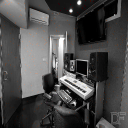

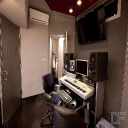

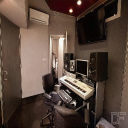

 20%|██        | 100/500 [01:47<05:58,  1.12it/s]

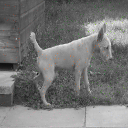

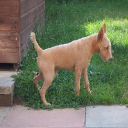

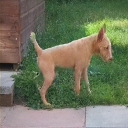

 40%|████      | 200/500 [03:08<03:59,  1.26it/s]

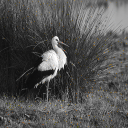

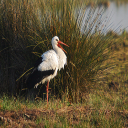

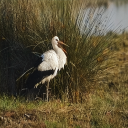

 60%|██████    | 300/500 [04:30<02:30,  1.33it/s]

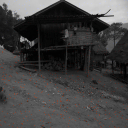

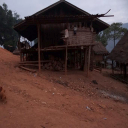

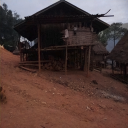

 80%|████████  | 400/500 [05:50<01:32,  1.08it/s]

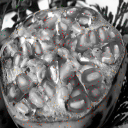

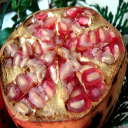

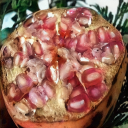

  0%|          | 2/1125 [00:00<01:39, 11.32it/s]


------------------------------------------------------------------
Epoch: 77	Time: 525.4985	Train Loss: 0.0096	Train PSNR 35.7109	Train SSIM 0.9495
------------------------------------------------------------------

[77] Validation Loss : 0.0102, Validation PSNR : 36.5565% ,Validation SSIM : 0.9489%

Epoch : [78] 0/1125 
 Training loss : 0.007234836928546429


  9%|▉         | 102/1125 [00:08<01:25, 11.90it/s]


Epoch : [78] 100/1125 
 Training loss : 0.009275777454460316


 18%|█▊        | 202/1125 [00:16<01:15, 12.24it/s]


Epoch : [78] 200/1125 
 Training loss : 0.009443499386514448


 27%|██▋       | 302/1125 [00:24<01:06, 12.33it/s]


Epoch : [78] 300/1125 
 Training loss : 0.009382168757744704


 36%|███▌      | 402/1125 [00:32<00:59, 12.20it/s]


Epoch : [78] 400/1125 
 Training loss : 0.00938135814827465


 45%|████▍     | 502/1125 [00:41<00:51, 12.16it/s]


Epoch : [78] 500/1125 
 Training loss : 0.009409183721818372


 54%|█████▎    | 602/1125 [00:49<00:43, 12.16it/s]


Epoch : [78] 600/1125 
 Training loss : 0.009336591155861758


 62%|██████▏   | 702/1125 [00:57<00:34, 12.11it/s]


Epoch : [78] 700/1125 
 Training loss : 0.00942109937656049


 71%|███████▏  | 802/1125 [01:05<00:26, 12.37it/s]


Epoch : [78] 800/1125 
 Training loss : 0.009418373468788934


 80%|████████  | 902/1125 [01:14<00:18, 12.14it/s]


Epoch : [78] 900/1125 
 Training loss : 0.009396563539928555


 89%|████████▉ | 1002/1125 [01:22<00:10, 12.15it/s]


Epoch : [78] 1000/1125 
 Training loss : 0.00942310328585106


 98%|█████████▊| 1102/1125 [01:30<00:01, 12.19it/s]


Epoch : [78] 1100/1125 
 Training loss : 0.00938901115127659


100%|██████████| 1125/1125 [01:32<00:00, 12.17it/s]



Finished training epoch 78
Total training loss : 0.009380305950840315 / psnr : 35.7482 / ssim : 0.9516


  0%|          | 0/500 [00:00<?, ?it/s]

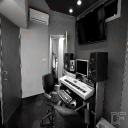

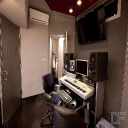

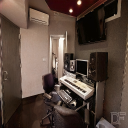

 20%|██        | 100/500 [00:01<00:07, 52.00it/s]

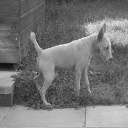

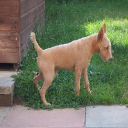

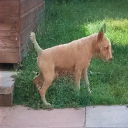

 39%|███▉      | 196/500 [00:03<00:05, 52.11it/s]

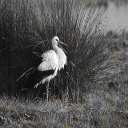

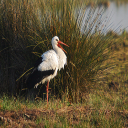

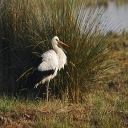

 59%|█████▉    | 297/500 [00:05<00:03, 53.17it/s]

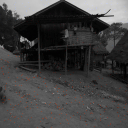

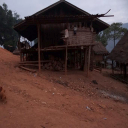

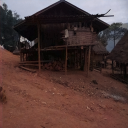

 80%|███████▉  | 399/500 [00:07<00:02, 50.48it/s]

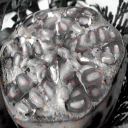

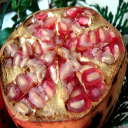

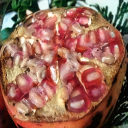

  0%|          | 1/1125 [00:00<01:59,  9.40it/s]


------------------------------------------------------------------
Epoch: 78	Time: 107.1490	Train Loss: 0.0094	Train PSNR 35.7482	Train SSIM 0.9516
------------------------------------------------------------------

[78] Validation Loss : 0.0093, Validation PSNR : 37.1325% ,Validation SSIM : 0.9512%

Epoch : [79] 0/1125 
 Training loss : 0.011754355393350124


  9%|▉         | 103/1125 [00:08<01:27, 11.71it/s]


Epoch : [79] 100/1125 
 Training loss : 0.009332558997713103


 18%|█▊        | 203/1125 [00:17<01:14, 12.33it/s]


Epoch : [79] 200/1125 
 Training loss : 0.00944898323160573


 27%|██▋       | 303/1125 [00:25<01:06, 12.33it/s]


Epoch : [79] 300/1125 
 Training loss : 0.009751077506233292


 36%|███▌      | 403/1125 [00:33<00:59, 12.06it/s]


Epoch : [79] 400/1125 
 Training loss : 0.009789865038954558


 45%|████▍     | 503/1125 [00:41<00:51, 12.01it/s]


Epoch : [79] 500/1125 
 Training loss : 0.009772251134258723


 54%|█████▎    | 603/1125 [00:50<00:42, 12.18it/s]


Epoch : [79] 600/1125 
 Training loss : 0.00957993522577744


 62%|██████▏   | 703/1125 [00:58<00:34, 12.30it/s]


Epoch : [79] 700/1125 
 Training loss : 0.009504758711697031


 71%|███████▏  | 803/1125 [01:06<00:26, 12.22it/s]


Epoch : [79] 800/1125 
 Training loss : 0.009485904445357797


 80%|████████  | 903/1125 [01:14<00:17, 12.40it/s]


Epoch : [79] 900/1125 
 Training loss : 0.009519711372491125


 89%|████████▉ | 1003/1125 [01:22<00:09, 12.30it/s]


Epoch : [79] 1000/1125 
 Training loss : 0.009519273903663758


 98%|█████████▊| 1103/1125 [01:30<00:01, 12.36it/s]


Epoch : [79] 1100/1125 
 Training loss : 0.009482480501409258


100%|██████████| 1125/1125 [01:32<00:00, 12.14it/s]



Finished training epoch 79
Total training loss : 0.009474367666161722 / psnr : 35.7379 / ssim : 0.9503


  0%|          | 0/500 [00:00<?, ?it/s]

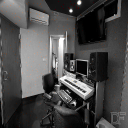

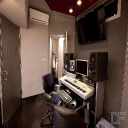

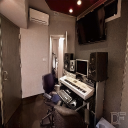

 19%|█▉        | 97/500 [00:02<00:08, 47.24it/s]

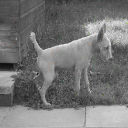

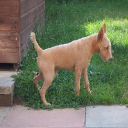

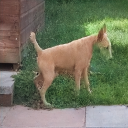

 39%|███▉      | 196/500 [00:04<00:06, 44.41it/s]

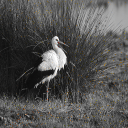

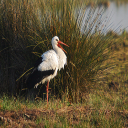

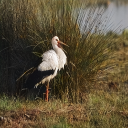

 60%|██████    | 300/500 [00:06<00:04, 45.73it/s]

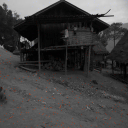

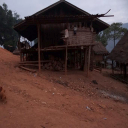

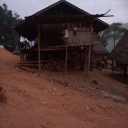

 80%|███████▉  | 398/500 [00:09<00:02, 42.90it/s]

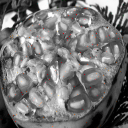

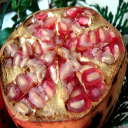

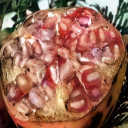

  0%|          | 2/1125 [00:00<01:40, 11.19it/s]


------------------------------------------------------------------
Epoch: 79	Time: 106.9516	Train Loss: 0.0095	Train PSNR 35.7379	Train SSIM 0.9503
------------------------------------------------------------------

[79] Validation Loss : 0.0099, Validation PSNR : 36.8285% ,Validation SSIM : 0.9499%

Epoch : [80] 0/1125 
 Training loss : 0.006962624844163656


  9%|▉         | 102/1125 [00:08<01:25, 12.02it/s]


Epoch : [80] 100/1125 
 Training loss : 0.009347746291631225


 18%|█▊        | 202/1125 [00:16<01:15, 12.24it/s]


Epoch : [80] 200/1125 
 Training loss : 0.009581072084531558


 27%|██▋       | 302/1125 [00:25<01:06, 12.30it/s]


Epoch : [80] 300/1125 
 Training loss : 0.009561169860061518


 36%|███▌      | 402/1125 [00:33<00:58, 12.26it/s]


Epoch : [80] 400/1125 
 Training loss : 0.009611355400925265


 45%|████▍     | 502/1125 [00:41<00:50, 12.24it/s]


Epoch : [80] 500/1125 
 Training loss : 0.009691275181267374


 54%|█████▎    | 602/1125 [00:49<00:42, 12.29it/s]


Epoch : [80] 600/1125 
 Training loss : 0.009593326674337295


 62%|██████▏   | 702/1125 [00:57<00:34, 12.11it/s]


Epoch : [80] 700/1125 
 Training loss : 0.009603902805176765


 71%|███████▏  | 802/1125 [01:06<00:26, 12.11it/s]


Epoch : [80] 800/1125 
 Training loss : 0.009627110861385992


 80%|████████  | 902/1125 [01:14<00:18, 12.07it/s]


Epoch : [80] 900/1125 
 Training loss : 0.009559718219069278


 89%|████████▉ | 1002/1125 [01:22<00:10, 12.25it/s]


Epoch : [80] 1000/1125 
 Training loss : 0.00951903630476017


 98%|█████████▊| 1102/1125 [01:30<00:01, 12.21it/s]


Epoch : [80] 1100/1125 
 Training loss : 0.009524973857552355


100%|██████████| 1125/1125 [01:32<00:00, 12.13it/s]



Finished training epoch 80
Total training loss : 0.009514145276198784 / psnr : 35.7512 / ssim : 0.9480


  0%|          | 0/500 [00:00<?, ?it/s]

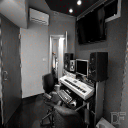

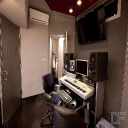

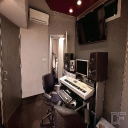

 20%|██        | 100/500 [00:02<00:07, 51.22it/s]

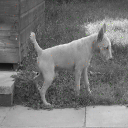

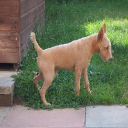

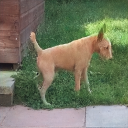

 39%|███▉      | 195/500 [00:03<00:05, 52.07it/s]

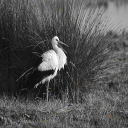

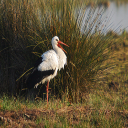

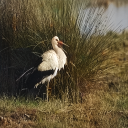

 59%|█████▉    | 295/500 [00:06<00:03, 52.49it/s]

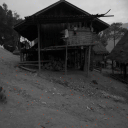

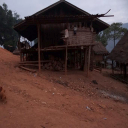

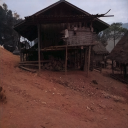

 80%|███████▉  | 398/500 [00:08<00:02, 44.80it/s]

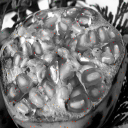

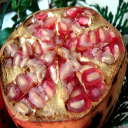

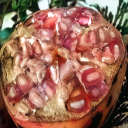

  0%|          | 2/1125 [00:00<01:38, 11.38it/s]


------------------------------------------------------------------
Epoch: 80	Time: 106.0355	Train Loss: 0.0095	Train PSNR 35.7512	Train SSIM 0.9480
------------------------------------------------------------------

[80] Validation Loss : 0.0095, Validation PSNR : 37.0003% ,Validation SSIM : 0.9473%

Epoch : [81] 0/1125 
 Training loss : 0.013224607333540916


  9%|▉         | 102/1125 [00:08<01:26, 11.80it/s]


Epoch : [81] 100/1125 
 Training loss : 0.009557034234783731


 18%|█▊        | 202/1125 [00:16<01:16, 12.06it/s]


Epoch : [81] 200/1125 
 Training loss : 0.00927923274323789


 27%|██▋       | 302/1125 [00:25<01:08, 12.02it/s]


Epoch : [81] 300/1125 
 Training loss : 0.009229295271328122


 36%|███▌      | 402/1125 [00:33<00:59, 12.06it/s]


Epoch : [81] 400/1125 
 Training loss : 0.00928766931409476


 45%|████▍     | 502/1125 [00:41<00:51, 12.18it/s]


Epoch : [81] 500/1125 
 Training loss : 0.0093483923425054


 54%|█████▎    | 602/1125 [00:50<00:43, 12.05it/s]


Epoch : [81] 600/1125 
 Training loss : 0.009452232117834384


 62%|██████▏   | 702/1125 [00:58<00:34, 12.11it/s]


Epoch : [81] 700/1125 
 Training loss : 0.009457682613442823


 71%|███████▏  | 802/1125 [01:06<00:26, 12.05it/s]


Epoch : [81] 800/1125 
 Training loss : 0.009431287303878537


 80%|████████  | 902/1125 [01:14<00:18, 12.31it/s]


Epoch : [81] 900/1125 
 Training loss : 0.009493349617208612


 89%|████████▉ | 1002/1125 [01:22<00:09, 12.31it/s]


Epoch : [81] 1000/1125 
 Training loss : 0.009489501894848954


 98%|█████████▊| 1102/1125 [01:31<00:01, 12.17it/s]


Epoch : [81] 1100/1125 
 Training loss : 0.00949543483849686


100%|██████████| 1125/1125 [01:33<00:00, 12.09it/s]



Finished training epoch 81
Total training loss : 0.009474075198173523 / psnr : 35.7599 / ssim : 0.9492


  0%|          | 0/500 [00:00<?, ?it/s]

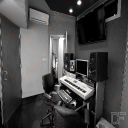

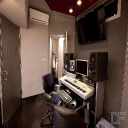

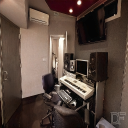

 19%|█▉        | 95/500 [00:01<00:08, 47.26it/s]

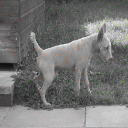

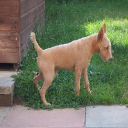

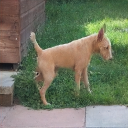

 39%|███▉      | 197/500 [00:04<00:06, 49.60it/s]

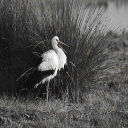

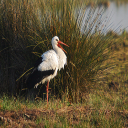

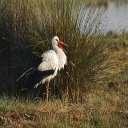

 59%|█████▉    | 297/500 [00:06<00:03, 50.87it/s]

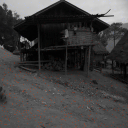

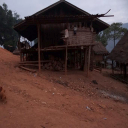

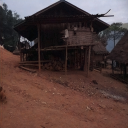

 80%|███████▉  | 398/500 [00:08<00:02, 39.49it/s]

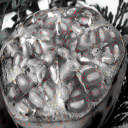

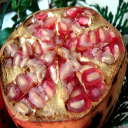

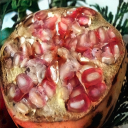

  0%|          | 1/1125 [00:00<02:39,  7.07it/s]


------------------------------------------------------------------
Epoch: 81	Time: 108.5594	Train Loss: 0.0095	Train PSNR 35.7599	Train SSIM 0.9492
------------------------------------------------------------------

[81] Validation Loss : 0.0092, Validation PSNR : 37.3171% ,Validation SSIM : 0.9477%

Epoch : [82] 0/1125 
 Training loss : 0.008055824786424637


  9%|▉         | 102/1125 [00:08<01:28, 11.62it/s]


Epoch : [82] 100/1125 
 Training loss : 0.009225339135431712


 18%|█▊        | 202/1125 [00:17<01:16, 12.03it/s]


Epoch : [82] 200/1125 
 Training loss : 0.009433438229972302


 27%|██▋       | 302/1125 [00:25<01:07, 12.15it/s]


Epoch : [82] 300/1125 
 Training loss : 0.00942109507412659


 36%|███▌      | 402/1125 [00:34<00:59, 12.22it/s]


Epoch : [82] 400/1125 
 Training loss : 0.009365618139496096


 45%|████▍     | 502/1125 [00:42<00:50, 12.28it/s]


Epoch : [82] 500/1125 
 Training loss : 0.009500351262291868


 54%|█████▎    | 602/1125 [00:50<00:42, 12.18it/s]


Epoch : [82] 600/1125 
 Training loss : 0.009428389701285646


 62%|██████▏   | 702/1125 [00:58<00:34, 12.32it/s]


Epoch : [82] 700/1125 
 Training loss : 0.009433371103242487


 71%|███████▏  | 802/1125 [01:06<00:26, 12.32it/s]


Epoch : [82] 800/1125 
 Training loss : 0.009391749331485783


 80%|████████  | 902/1125 [01:14<00:18, 11.88it/s]


Epoch : [82] 900/1125 
 Training loss : 0.009345667446280244


 89%|████████▉ | 1002/1125 [01:23<00:10, 11.99it/s]


Epoch : [82] 1000/1125 
 Training loss : 0.009353292715892969


 98%|█████████▊| 1102/1125 [01:31<00:01, 12.00it/s]


Epoch : [82] 1100/1125 
 Training loss : 0.009368690766764637


100%|██████████| 1125/1125 [01:33<00:00, 12.03it/s]



Finished training epoch 82
Total training loss : 0.009368133896961808 / psnr : 35.8431 / ssim : 0.9499


  0%|          | 0/500 [00:00<?, ?it/s]

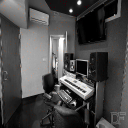

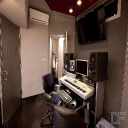

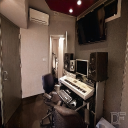

 19%|█▉        | 97/500 [00:02<00:08, 49.50it/s]

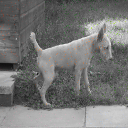

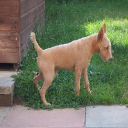

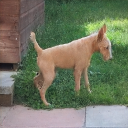

 39%|███▉      | 195/500 [00:04<00:06, 47.85it/s]

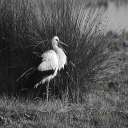

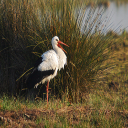

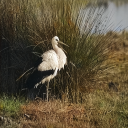

 59%|█████▉    | 297/500 [00:06<00:04, 48.86it/s]

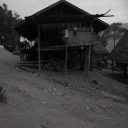

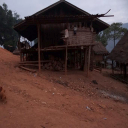

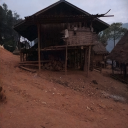

 80%|████████  | 400/500 [00:08<00:02, 42.73it/s]

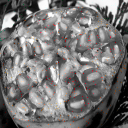

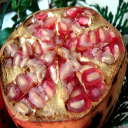

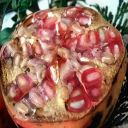

  0%|          | 1/1125 [00:00<02:06,  8.91it/s]


------------------------------------------------------------------
Epoch: 82	Time: 107.3893	Train Loss: 0.0094	Train PSNR 35.8431	Train SSIM 0.9499
------------------------------------------------------------------

[82] Validation Loss : 0.0094, Validation PSNR : 36.7728% ,Validation SSIM : 0.9474%

Epoch : [83] 0/1125 
 Training loss : 0.007510431110858917


  9%|▉         | 103/1125 [00:08<01:23, 12.24it/s]


Epoch : [83] 100/1125 
 Training loss : 0.008964878400916806


 18%|█▊        | 203/1125 [00:16<01:15, 12.27it/s]


Epoch : [83] 200/1125 
 Training loss : 0.0102007930069717


 27%|██▋       | 303/1125 [00:25<01:06, 12.29it/s]


Epoch : [83] 300/1125 
 Training loss : 0.010102952211674465


 36%|███▌      | 403/1125 [00:33<01:00, 11.90it/s]


Epoch : [83] 400/1125 
 Training loss : 0.010196354175149056


 45%|████▍     | 503/1125 [00:41<00:51, 11.99it/s]


Epoch : [83] 500/1125 
 Training loss : 0.010094249744652334


 54%|█████▎    | 603/1125 [00:50<00:44, 11.86it/s]


Epoch : [83] 600/1125 
 Training loss : 0.009977945753415046


 62%|██████▏   | 703/1125 [00:58<00:34, 12.13it/s]


Epoch : [83] 700/1125 
 Training loss : 0.009857658044396556


 71%|███████▏  | 803/1125 [01:06<00:26, 12.04it/s]


Epoch : [83] 800/1125 
 Training loss : 0.009783060330032522


 80%|████████  | 903/1125 [01:14<00:18, 12.14it/s]


Epoch : [83] 900/1125 
 Training loss : 0.009720034860115866


 89%|████████▉ | 1003/1125 [01:22<00:09, 12.21it/s]


Epoch : [83] 1000/1125 
 Training loss : 0.009700167538983362


 98%|█████████▊| 1103/1125 [01:30<00:01, 12.27it/s]


Epoch : [83] 1100/1125 
 Training loss : 0.009663261316266658


100%|██████████| 1125/1125 [01:32<00:00, 12.15it/s]



Finished training epoch 83
Total training loss : 0.009647049576458004 / psnr : 35.7014 / ssim : 0.9492


  0%|          | 0/500 [00:00<?, ?it/s]

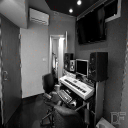

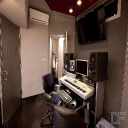

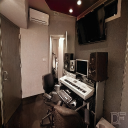

 19%|█▉        | 96/500 [00:02<00:09, 43.86it/s]

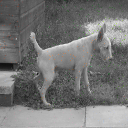

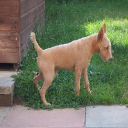

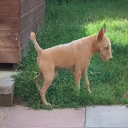

 40%|████      | 200/500 [00:04<00:06, 44.98it/s]

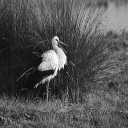

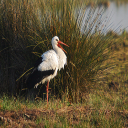

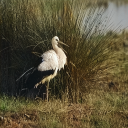

 60%|██████    | 300/500 [00:07<00:04, 43.63it/s]

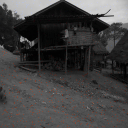

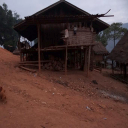

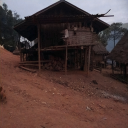

 80%|███████▉  | 398/500 [00:09<00:02, 40.22it/s]

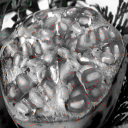

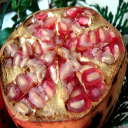

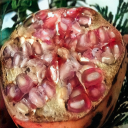

  0%|          | 1/1125 [00:00<01:52, 10.00it/s]


------------------------------------------------------------------
Epoch: 83	Time: 107.3340	Train Loss: 0.0096	Train PSNR 35.7014	Train SSIM 0.9492
------------------------------------------------------------------

[83] Validation Loss : 0.0098, Validation PSNR : 36.7713% ,Validation SSIM : 0.9483%

Epoch : [84] 0/1125 
 Training loss : 0.005580063443630934


  9%|▉         | 102/1125 [00:08<01:24, 12.07it/s]


Epoch : [84] 100/1125 
 Training loss : 0.009103135321067997


 18%|█▊        | 202/1125 [00:17<01:16, 12.14it/s]


Epoch : [84] 200/1125 
 Training loss : 0.009212853539901884


 27%|██▋       | 302/1125 [00:25<01:07, 12.22it/s]


Epoch : [84] 300/1125 
 Training loss : 0.009173384892361306


 36%|███▌      | 402/1125 [00:33<00:59, 12.21it/s]


Epoch : [84] 400/1125 
 Training loss : 0.00942129447029676


 45%|████▍     | 502/1125 [00:41<00:50, 12.28it/s]


Epoch : [84] 500/1125 
 Training loss : 0.009389822149162223


 54%|█████▎    | 602/1125 [00:49<00:42, 12.18it/s]


Epoch : [84] 600/1125 
 Training loss : 0.00936409100245517


 62%|██████▏   | 702/1125 [00:57<00:35, 11.94it/s]


Epoch : [84] 700/1125 
 Training loss : 0.009305748626850173


 71%|███████▏  | 802/1125 [01:06<00:26, 11.98it/s]


Epoch : [84] 800/1125 
 Training loss : 0.009255306490612089


 80%|████████  | 902/1125 [01:14<00:18, 12.10it/s]


Epoch : [84] 900/1125 
 Training loss : 0.009282635491792026


 89%|████████▉ | 1002/1125 [01:22<00:09, 12.34it/s]


Epoch : [84] 1000/1125 
 Training loss : 0.009292139915970865


 98%|█████████▊| 1102/1125 [01:31<00:01, 12.01it/s]


Epoch : [84] 1100/1125 
 Training loss : 0.00934194061790105


100%|██████████| 1125/1125 [01:33<00:00, 12.10it/s]



Finished training epoch 84
Total training loss : 0.009334910566608111 / psnr : 35.8518 / ssim : 0.9504


  0%|          | 0/500 [00:00<?, ?it/s]

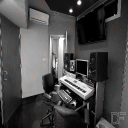

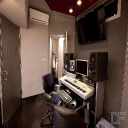

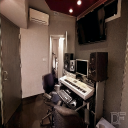

 19%|█▉        | 97/500 [00:02<00:09, 42.55it/s]

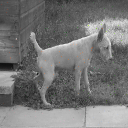

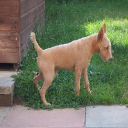

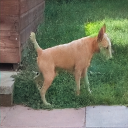

 40%|███▉      | 198/500 [00:04<00:06, 45.25it/s]

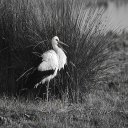

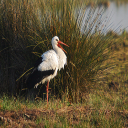

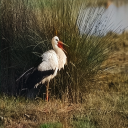

 60%|█████▉    | 298/500 [00:07<00:04, 46.24it/s]

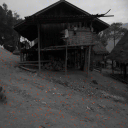

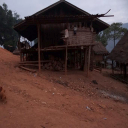

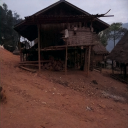

 80%|███████▉  | 398/500 [00:09<00:02, 41.08it/s]

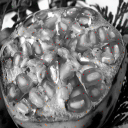

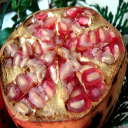

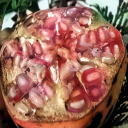

  0%|          | 2/1125 [00:00<01:45, 10.62it/s]


------------------------------------------------------------------
Epoch: 84	Time: 110.0587	Train Loss: 0.0093	Train PSNR 35.8518	Train SSIM 0.9504
------------------------------------------------------------------

[84] Validation Loss : 0.0086, Validation PSNR : 37.3661% ,Validation SSIM : 0.9534%

Epoch : [85] 0/1125 
 Training loss : 0.009122991003096104


  9%|▉         | 102/1125 [00:08<01:25, 11.95it/s]


Epoch : [85] 100/1125 
 Training loss : 0.009382025679886932


 18%|█▊        | 202/1125 [00:17<01:18, 11.78it/s]


Epoch : [85] 200/1125 
 Training loss : 0.009237290925313882


 27%|██▋       | 302/1125 [00:25<01:07, 12.24it/s]


Epoch : [85] 300/1125 
 Training loss : 0.009216816862271573


 36%|███▌      | 402/1125 [00:33<00:59, 12.24it/s]


Epoch : [85] 400/1125 
 Training loss : 0.009243207299696314


 45%|████▍     | 502/1125 [00:41<00:51, 12.03it/s]


Epoch : [85] 500/1125 
 Training loss : 0.009251648392862903


 54%|█████▎    | 602/1125 [00:50<00:43, 12.00it/s]


Epoch : [85] 600/1125 
 Training loss : 0.009233822327838613


 62%|██████▏   | 702/1125 [00:58<00:35, 12.00it/s]


Epoch : [85] 700/1125 
 Training loss : 0.009233360825114473


 71%|███████▏  | 802/1125 [01:06<00:26, 12.04it/s]


Epoch : [85] 800/1125 
 Training loss : 0.009154724791999464


 80%|████████  | 902/1125 [01:15<00:18, 12.23it/s]


Epoch : [85] 900/1125 
 Training loss : 0.009178556706528949


 89%|████████▉ | 1002/1125 [01:23<00:10, 12.17it/s]


Epoch : [85] 1000/1125 
 Training loss : 0.009163774293172848


 98%|█████████▊| 1102/1125 [01:31<00:01, 12.06it/s]


Epoch : [85] 1100/1125 
 Training loss : 0.00918885575714001


100%|██████████| 1125/1125 [01:33<00:00, 12.06it/s]



Finished training epoch 85
Total training loss : 0.009183162469002935 / psnr : 35.8731 / ssim : 0.9508


  0%|          | 0/500 [00:00<?, ?it/s]

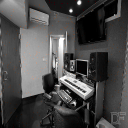

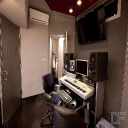

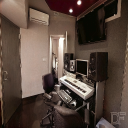

 19%|█▉        | 96/500 [00:02<00:08, 46.94it/s]

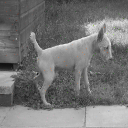

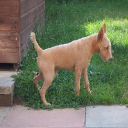

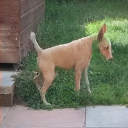

 40%|████      | 200/500 [00:04<00:06, 48.02it/s]

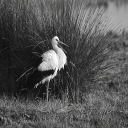

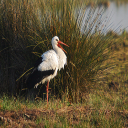

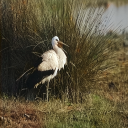

 59%|█████▉    | 297/500 [00:06<00:04, 41.13it/s]

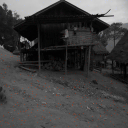

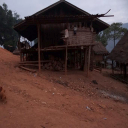

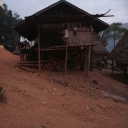

 80%|████████  | 400/500 [00:09<00:02, 42.37it/s]

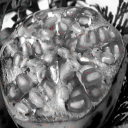

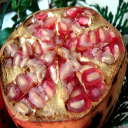

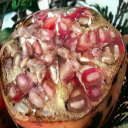

  0%|          | 2/1125 [00:00<01:46, 10.53it/s]


------------------------------------------------------------------
Epoch: 85	Time: 107.6566	Train Loss: 0.0092	Train PSNR 35.8731	Train SSIM 0.9508
------------------------------------------------------------------

[85] Validation Loss : 0.0093, Validation PSNR : 36.3955% ,Validation SSIM : 0.9485%

Epoch : [86] 0/1125 
 Training loss : 0.007084638811647892


  9%|▉         | 103/1125 [00:09<01:26, 11.83it/s]


Epoch : [86] 100/1125 
 Training loss : 0.009081202937234746


 18%|█▊        | 203/1125 [00:17<01:18, 11.75it/s]


Epoch : [86] 200/1125 
 Training loss : 0.008955375289090385


 27%|██▋       | 303/1125 [00:25<01:09, 11.91it/s]


Epoch : [86] 300/1125 
 Training loss : 0.00905364813388285


 36%|███▌      | 403/1125 [00:33<00:59, 12.11it/s]


Epoch : [86] 400/1125 
 Training loss : 0.008984553921466085


 45%|████▍     | 503/1125 [00:42<00:50, 12.26it/s]


Epoch : [86] 500/1125 
 Training loss : 0.009081939900825599


 54%|█████▎    | 603/1125 [00:50<00:42, 12.16it/s]


Epoch : [86] 600/1125 
 Training loss : 0.009145698307884762


 62%|██████▏   | 703/1125 [00:58<00:34, 12.16it/s]


Epoch : [86] 700/1125 
 Training loss : 0.009144252662370234


 71%|███████▏  | 803/1125 [01:06<00:26, 12.01it/s]


Epoch : [86] 800/1125 
 Training loss : 0.009163704021169936


 80%|████████  | 903/1125 [01:15<00:18, 11.94it/s]


Epoch : [86] 900/1125 
 Training loss : 0.009177532370567123


 89%|████████▉ | 1003/1125 [01:23<00:10, 11.95it/s]


Epoch : [86] 1000/1125 
 Training loss : 0.00926502286265795


 98%|█████████▊| 1103/1125 [01:32<00:01, 12.22it/s]


Epoch : [86] 1100/1125 
 Training loss : 0.00928127929165648


100%|██████████| 1125/1125 [01:33<00:00, 11.98it/s]



Finished training epoch 86
Total training loss : 0.009289380778455073 / psnr : 35.8572 / ssim : 0.9528


  0%|          | 0/500 [00:00<?, ?it/s]

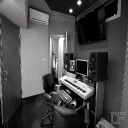

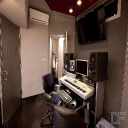

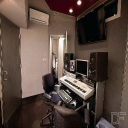

 19%|█▉        | 97/500 [00:02<00:08, 44.99it/s]

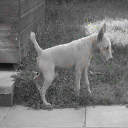

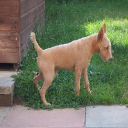

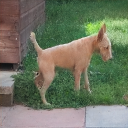

 40%|███▉      | 199/500 [00:04<00:06, 48.53it/s]

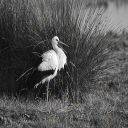

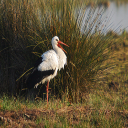

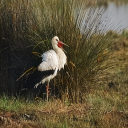

 59%|█████▉    | 296/500 [00:06<00:04, 46.86it/s]

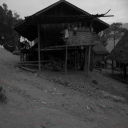

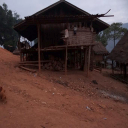

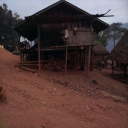

 80%|████████  | 400/500 [00:09<00:02, 41.13it/s]

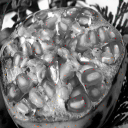

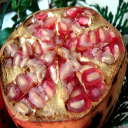

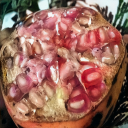

  0%|          | 0/1125 [00:00<?, ?it/s]


------------------------------------------------------------------
Epoch: 86	Time: 107.9386	Train Loss: 0.0093	Train PSNR 35.8572	Train SSIM 0.9528
------------------------------------------------------------------

[86] Validation Loss : 0.0102, Validation PSNR : 36.5715% ,Validation SSIM : 0.9490%

Epoch : [87] 0/1125 
 Training loss : 0.0067563666962087154


  9%|▉         | 102/1125 [00:08<01:24, 12.06it/s]


Epoch : [87] 100/1125 
 Training loss : 0.009026147512774361


 18%|█▊        | 202/1125 [00:17<01:16, 12.12it/s]


Epoch : [87] 200/1125 
 Training loss : 0.009272166708512093


 27%|██▋       | 302/1125 [00:25<01:10, 11.73it/s]


Epoch : [87] 300/1125 
 Training loss : 0.009231031061679223


 36%|███▌      | 402/1125 [00:33<01:01, 11.80it/s]


Epoch : [87] 400/1125 
 Training loss : 0.009398140493975464


 45%|████▍     | 502/1125 [00:42<00:53, 11.71it/s]


Epoch : [87] 500/1125 
 Training loss : 0.00942266293375673


 54%|█████▎    | 602/1125 [00:50<00:44, 11.88it/s]


Epoch : [87] 600/1125 
 Training loss : 0.00939282064811139


 62%|██████▏   | 702/1125 [00:59<00:35, 11.84it/s]


Epoch : [87] 700/1125 
 Training loss : 0.009339437532383475


 71%|███████▏  | 802/1125 [01:07<00:27, 11.63it/s]


Epoch : [87] 800/1125 
 Training loss : 0.009290438420958957


 80%|████████  | 902/1125 [01:16<00:18, 11.77it/s]


Epoch : [87] 900/1125 
 Training loss : 0.009257575527524015


 89%|████████▉ | 1002/1125 [01:24<00:10, 12.24it/s]


Epoch : [87] 1000/1125 
 Training loss : 0.009260593051021988


 98%|█████████▊| 1102/1125 [01:32<00:01, 12.08it/s]


Epoch : [87] 1100/1125 
 Training loss : 0.009216677819587609


100%|██████████| 1125/1125 [01:34<00:00, 11.86it/s]



Finished training epoch 87
Total training loss : 0.009213399873425563 / psnr : 35.9034 / ssim : 0.9507


  0%|          | 0/500 [00:00<?, ?it/s]

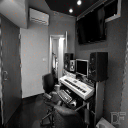

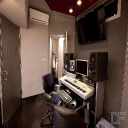

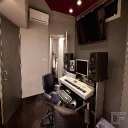

 20%|█▉        | 98/500 [00:02<00:08, 46.37it/s]

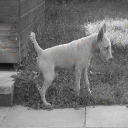

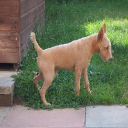

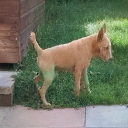

 40%|███▉      | 198/500 [00:04<00:06, 45.29it/s]

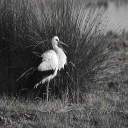

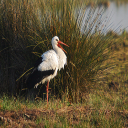

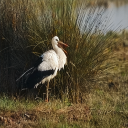

 60%|█████▉    | 299/500 [00:06<00:04, 46.70it/s]

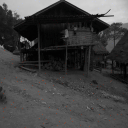

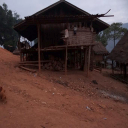

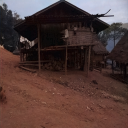

 80%|███████▉  | 398/500 [00:09<00:02, 39.15it/s]

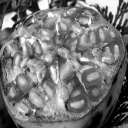

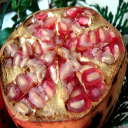

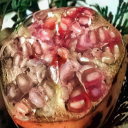

  0%|          | 2/1125 [00:00<01:42, 10.92it/s]


------------------------------------------------------------------
Epoch: 87	Time: 111.4599	Train Loss: 0.0092	Train PSNR 35.9034	Train SSIM 0.9507
------------------------------------------------------------------

[87] Validation Loss : 0.0090, Validation PSNR : 37.4262% ,Validation SSIM : 0.9506%

Epoch : [88] 0/1125 
 Training loss : 0.009391199797391891


  9%|▉         | 102/1125 [00:08<01:26, 11.77it/s]


Epoch : [88] 100/1125 
 Training loss : 0.00869745299183201


 18%|█▊        | 202/1125 [00:17<01:23, 11.10it/s]


Epoch : [88] 200/1125 
 Training loss : 0.0089979438454061


 27%|██▋       | 302/1125 [00:26<01:11, 11.49it/s]


Epoch : [88] 300/1125 
 Training loss : 0.009217967986256083


 36%|███▌      | 402/1125 [00:35<01:01, 11.85it/s]


Epoch : [88] 400/1125 
 Training loss : 0.009296269103782506


 45%|████▍     | 502/1125 [00:43<00:51, 12.01it/s]


Epoch : [88] 500/1125 
 Training loss : 0.00936836349274108


 54%|█████▎    | 602/1125 [00:51<00:43, 11.91it/s]


Epoch : [88] 600/1125 
 Training loss : 0.009387916256170007


 62%|██████▏   | 702/1125 [01:00<00:35, 11.95it/s]


Epoch : [88] 700/1125 
 Training loss : 0.009369639000893914


 71%|███████▏  | 802/1125 [01:08<00:27, 11.88it/s]


Epoch : [88] 800/1125 
 Training loss : 0.009348339830803104


 80%|████████  | 902/1125 [01:17<00:19, 11.19it/s]


Epoch : [88] 900/1125 
 Training loss : 0.009351914720123967


 89%|████████▉ | 1002/1125 [01:25<00:10, 11.53it/s]


Epoch : [88] 1000/1125 
 Training loss : 0.00933899196491881


 98%|█████████▊| 1102/1125 [01:34<00:02, 11.39it/s]


Epoch : [88] 1100/1125 
 Training loss : 0.009294706721368036


100%|██████████| 1125/1125 [01:36<00:00, 11.68it/s]



Finished training epoch 88
Total training loss : 0.009286085090082552 / psnr : 35.8853 / ssim : 0.9509


  0%|          | 0/500 [00:00<?, ?it/s]

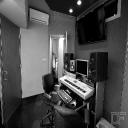

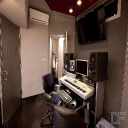

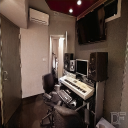

 20%|█▉        | 98/500 [00:02<00:09, 42.93it/s]

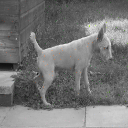

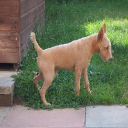

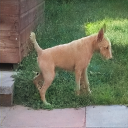

 39%|███▉      | 197/500 [00:04<00:07, 40.23it/s]

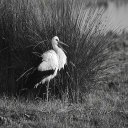

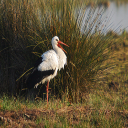

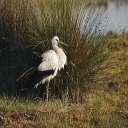

 60%|█████▉    | 299/500 [00:07<00:05, 34.86it/s]

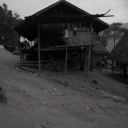

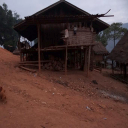

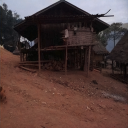

 80%|███████▉  | 399/500 [00:10<00:02, 36.61it/s]

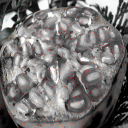

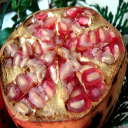

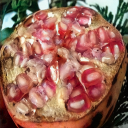

  0%|          | 2/1125 [00:00<01:46, 10.52it/s]


------------------------------------------------------------------
Epoch: 88	Time: 112.1938	Train Loss: 0.0093	Train PSNR 35.8853	Train SSIM 0.9509
------------------------------------------------------------------

[88] Validation Loss : 0.0097, Validation PSNR : 36.8012% ,Validation SSIM : 0.9489%

Epoch : [89] 0/1125 
 Training loss : 0.011066131293773651


  9%|▉         | 103/1125 [00:08<01:26, 11.88it/s]


Epoch : [89] 100/1125 
 Training loss : 0.00929162526355669


 18%|█▊        | 203/1125 [00:17<01:17, 11.85it/s]


Epoch : [89] 200/1125 
 Training loss : 0.009053136998166641


 27%|██▋       | 303/1125 [00:25<01:09, 11.81it/s]


Epoch : [89] 300/1125 
 Training loss : 0.009214482183546521


 36%|███▌      | 403/1125 [00:34<01:02, 11.53it/s]


Epoch : [89] 400/1125 
 Training loss : 0.009179102463596628


 45%|████▍     | 503/1125 [00:43<00:53, 11.59it/s]


Epoch : [89] 500/1125 
 Training loss : 0.009166330874278516


 54%|█████▎    | 603/1125 [00:51<00:44, 11.62it/s]


Epoch : [89] 600/1125 
 Training loss : 0.009084555825618361


 62%|██████▏   | 703/1125 [01:00<00:35, 11.87it/s]


Epoch : [89] 700/1125 
 Training loss : 0.009115038820264725


 71%|███████▏  | 803/1125 [01:08<00:27, 11.82it/s]


Epoch : [89] 800/1125 
 Training loss : 0.009091588570277082


 80%|████████  | 903/1125 [01:17<00:18, 11.84it/s]


Epoch : [89] 900/1125 
 Training loss : 0.009109836352883646


 89%|████████▉ | 1003/1125 [01:25<00:10, 11.96it/s]


Epoch : [89] 1000/1125 
 Training loss : 0.00912737039212774


 98%|█████████▊| 1103/1125 [01:34<00:01, 11.84it/s]


Epoch : [89] 1100/1125 
 Training loss : 0.009133775702438281


100%|██████████| 1125/1125 [01:35<00:00, 11.72it/s]



Finished training epoch 89
Total training loss : 0.0091312247030437 / psnr : 35.9791 / ssim : 0.9527


  0%|          | 0/500 [00:00<?, ?it/s]

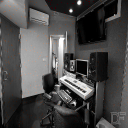

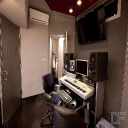

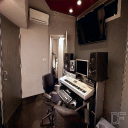

 19%|█▉        | 96/500 [00:02<00:10, 38.65it/s]

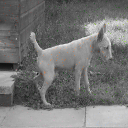

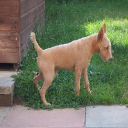

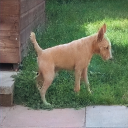

 40%|████      | 200/500 [00:04<00:07, 41.55it/s]

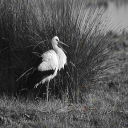

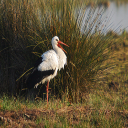

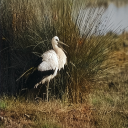

 60%|██████    | 300/500 [00:07<00:04, 43.15it/s]

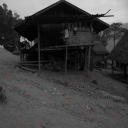

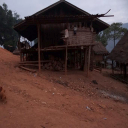

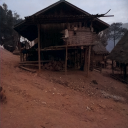

 79%|███████▉  | 397/500 [00:10<00:02, 34.47it/s]

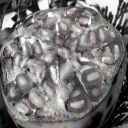

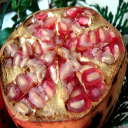

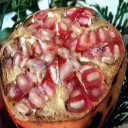

  0%|          | 1/1125 [00:00<02:08,  8.74it/s]


------------------------------------------------------------------
Epoch: 89	Time: 114.7230	Train Loss: 0.0091	Train PSNR 35.9791	Train SSIM 0.9527
------------------------------------------------------------------

[89] Validation Loss : 0.0085, Validation PSNR : 37.5094% ,Validation SSIM : 0.9500%

Epoch : [90] 0/1125 
 Training loss : 0.007503575645387173


  9%|▉         | 103/1125 [00:09<01:33, 10.89it/s]


Epoch : [90] 100/1125 
 Training loss : 0.009280277720403553


 18%|█▊        | 203/1125 [00:18<01:18, 11.78it/s]


Epoch : [90] 200/1125 
 Training loss : 0.009050206288194923


 27%|██▋       | 303/1125 [00:26<01:09, 11.84it/s]


Epoch : [90] 300/1125 
 Training loss : 0.009300544188107268


 36%|███▌      | 403/1125 [00:35<01:01, 11.77it/s]


Epoch : [90] 400/1125 
 Training loss : 0.009316447043461618


 45%|████▍     | 503/1125 [00:43<00:53, 11.59it/s]


Epoch : [90] 500/1125 
 Training loss : 0.009327057718360674


 54%|█████▎    | 603/1125 [00:52<00:45, 11.52it/s]


Epoch : [90] 600/1125 
 Training loss : 0.009329884621421628


 62%|██████▏   | 703/1125 [01:00<00:36, 11.66it/s]


Epoch : [90] 700/1125 
 Training loss : 0.009251255177349363


 71%|███████▏  | 803/1125 [01:09<00:27, 11.56it/s]


Epoch : [90] 800/1125 
 Training loss : 0.009219261999015281


 80%|████████  | 903/1125 [01:18<00:18, 11.82it/s]


Epoch : [90] 900/1125 
 Training loss : 0.009226825453142545


 89%|████████▉ | 1003/1125 [01:26<00:10, 11.50it/s]


Epoch : [90] 1000/1125 
 Training loss : 0.009189345435212394


 98%|█████████▊| 1103/1125 [01:35<00:01, 11.67it/s]


Epoch : [90] 1100/1125 
 Training loss : 0.009206319491731698


100%|██████████| 1125/1125 [01:37<00:00, 11.55it/s]



Finished training epoch 90
Total training loss : 0.009204669048388799 / psnr : 35.9163 / ssim : 0.9497


  0%|          | 0/500 [00:00<?, ?it/s]

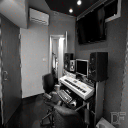

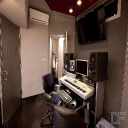

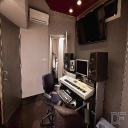

 19%|█▉        | 96/500 [00:02<00:09, 41.36it/s]

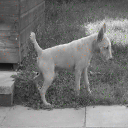

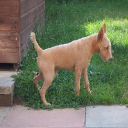

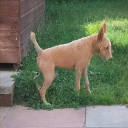

 40%|████      | 200/500 [00:04<00:07, 42.64it/s]

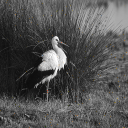

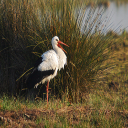

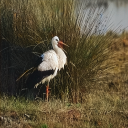

 59%|█████▉    | 296/500 [00:07<00:06, 29.78it/s]

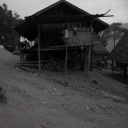

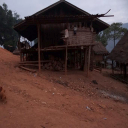

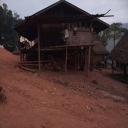

 80%|███████▉  | 399/500 [00:10<00:02, 33.96it/s]

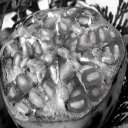

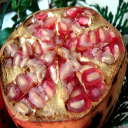

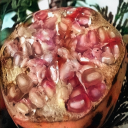

  0%|          | 0/1125 [00:00<?, ?it/s]


------------------------------------------------------------------
Epoch: 90	Time: 113.2645	Train Loss: 0.0092	Train PSNR 35.9163	Train SSIM 0.9497
------------------------------------------------------------------

[90] Validation Loss : 0.0106, Validation PSNR : 36.1935% ,Validation SSIM : 0.9454%

Epoch : [91] 0/1125 
 Training loss : 0.009651425294578075


  9%|▉         | 102/1125 [00:09<01:26, 11.86it/s]


Epoch : [91] 100/1125 
 Training loss : 0.009320316697922673


 18%|█▊        | 202/1125 [00:17<01:18, 11.70it/s]


Epoch : [91] 200/1125 
 Training loss : 0.009385216927887937


 27%|██▋       | 302/1125 [00:26<01:09, 11.76it/s]


Epoch : [91] 300/1125 
 Training loss : 0.0092254363068463


 36%|███▌      | 402/1125 [00:34<01:03, 11.44it/s]


Epoch : [91] 400/1125 
 Training loss : 0.009142863867279524


 45%|████▍     | 502/1125 [00:43<00:53, 11.54it/s]


Epoch : [91] 500/1125 
 Training loss : 0.009102711620407844


 54%|█████▎    | 602/1125 [00:52<00:45, 11.48it/s]


Epoch : [91] 600/1125 
 Training loss : 0.009068801122781094


 62%|██████▏   | 702/1125 [01:00<00:36, 11.63it/s]


Epoch : [91] 700/1125 
 Training loss : 0.00909757813287317


 71%|███████▏  | 802/1125 [01:09<00:27, 11.79it/s]


Epoch : [91] 800/1125 
 Training loss : 0.009109751986439681


 80%|████████  | 902/1125 [01:17<00:19, 11.58it/s]


Epoch : [91] 900/1125 
 Training loss : 0.009092978389414811


 89%|████████▉ | 1002/1125 [01:26<00:10, 11.91it/s]


Epoch : [91] 1000/1125 
 Training loss : 0.009191097087830632


 98%|█████████▊| 1102/1125 [01:34<00:01, 11.69it/s]


Epoch : [91] 1100/1125 
 Training loss : 0.00919344180519883


100%|██████████| 1125/1125 [01:36<00:00, 11.63it/s]



Finished training epoch 91
Total training loss : 0.009191154404646821 / psnr : 35.9535 / ssim : 0.9509


  0%|          | 0/500 [00:00<?, ?it/s]

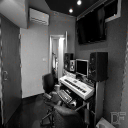

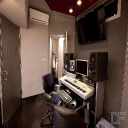

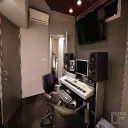

 20%|██        | 100/500 [00:02<00:09, 43.01it/s]

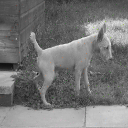

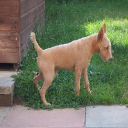

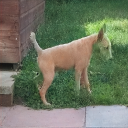

 40%|███▉      | 198/500 [00:04<00:07, 42.42it/s]

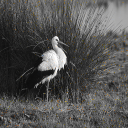

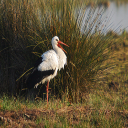

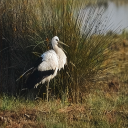

 59%|█████▉    | 296/500 [00:07<00:04, 41.96it/s]

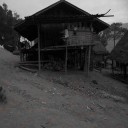

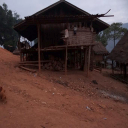

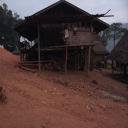

 80%|███████▉  | 398/500 [00:10<00:02, 36.66it/s]

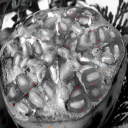

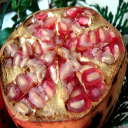

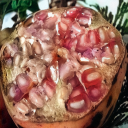

  0%|          | 1/1125 [00:00<02:04,  9.05it/s]


------------------------------------------------------------------
Epoch: 91	Time: 112.3044	Train Loss: 0.0092	Train PSNR 35.9535	Train SSIM 0.9509
------------------------------------------------------------------

[91] Validation Loss : 0.0103, Validation PSNR : 36.6565% ,Validation SSIM : 0.9458%

Epoch : [92] 0/1125 
 Training loss : 0.008192677050828934


  9%|▉         | 102/1125 [00:09<01:31, 11.20it/s]


Epoch : [92] 100/1125 
 Training loss : 0.009159879657522877


 18%|█▊        | 202/1125 [00:18<01:20, 11.42it/s]


Epoch : [92] 200/1125 
 Training loss : 0.0093516809935334


 27%|██▋       | 302/1125 [00:26<01:10, 11.70it/s]


Epoch : [92] 300/1125 
 Training loss : 0.009418688384983132


 36%|███▌      | 402/1125 [00:35<01:01, 11.68it/s]


Epoch : [92] 400/1125 
 Training loss : 0.009333977186611095


 45%|████▍     | 502/1125 [00:43<00:52, 11.81it/s]


Epoch : [92] 500/1125 
 Training loss : 0.00929433031810704


 54%|█████▎    | 602/1125 [00:52<00:44, 11.78it/s]


Epoch : [92] 600/1125 
 Training loss : 0.009318697844289504


 62%|██████▏   | 702/1125 [01:00<00:37, 11.42it/s]


Epoch : [92] 700/1125 
 Training loss : 0.009263100140407873


 71%|███████▏  | 802/1125 [01:09<00:27, 11.59it/s]


Epoch : [92] 800/1125 
 Training loss : 0.009256998274693923


 80%|████████  | 902/1125 [01:18<00:19, 11.73it/s]


Epoch : [92] 900/1125 
 Training loss : 0.009222615607905632


 89%|████████▉ | 1002/1125 [01:26<00:10, 11.83it/s]


Epoch : [92] 1000/1125 
 Training loss : 0.009199560309604896


 98%|█████████▊| 1102/1125 [01:35<00:02, 11.35it/s]


Epoch : [92] 1100/1125 
 Training loss : 0.009168730851611314


100%|██████████| 1125/1125 [01:37<00:00, 11.54it/s]



Finished training epoch 92
Total training loss : 0.00916253688186407 / psnr : 35.9647 / ssim : 0.9506


  0%|          | 0/500 [00:00<?, ?it/s]

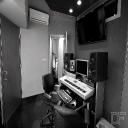

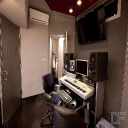

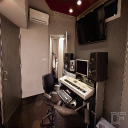

 19%|█▉        | 97/500 [00:02<00:10, 39.84it/s]

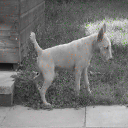

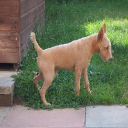

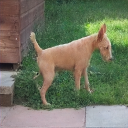

 40%|████      | 200/500 [00:05<00:07, 42.31it/s]

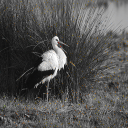

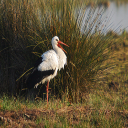

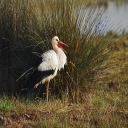

 60%|█████▉    | 299/500 [00:07<00:04, 43.59it/s]

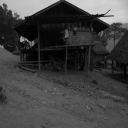

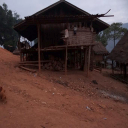

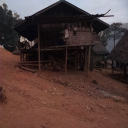

 80%|███████▉  | 398/500 [00:10<00:02, 35.47it/s]

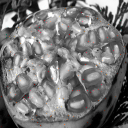

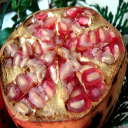

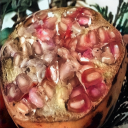

  0%|          | 2/1125 [00:00<01:46, 10.59it/s]


------------------------------------------------------------------
Epoch: 92	Time: 113.3138	Train Loss: 0.0092	Train PSNR 35.9647	Train SSIM 0.9506
------------------------------------------------------------------

[92] Validation Loss : 0.0103, Validation PSNR : 36.2491% ,Validation SSIM : 0.9488%

Epoch : [93] 0/1125 
 Training loss : 0.008982878178358078


  9%|▉         | 102/1125 [00:09<01:30, 11.24it/s]


Epoch : [93] 100/1125 
 Training loss : 0.008913540539543817


 18%|█▊        | 202/1125 [00:18<01:20, 11.43it/s]


Epoch : [93] 200/1125 
 Training loss : 0.00900474517369893


 27%|██▋       | 302/1125 [00:27<01:13, 11.27it/s]


Epoch : [93] 300/1125 
 Training loss : 0.009097009727056835


 36%|███▌      | 402/1125 [00:35<01:02, 11.61it/s]


Epoch : [93] 400/1125 
 Training loss : 0.009047067404824525


 45%|████▍     | 502/1125 [00:44<00:55, 11.31it/s]


Epoch : [93] 500/1125 
 Training loss : 0.008934340383969024


 54%|█████▎    | 602/1125 [00:53<00:45, 11.46it/s]


Epoch : [93] 600/1125 
 Training loss : 0.009060083714913509


 62%|██████▏   | 702/1125 [01:02<00:36, 11.43it/s]


Epoch : [93] 700/1125 
 Training loss : 0.00906100307528817


 71%|███████▏  | 802/1125 [01:10<00:27, 11.63it/s]


Epoch : [93] 800/1125 
 Training loss : 0.00912084938904803


 80%|████████  | 902/1125 [01:19<00:19, 11.67it/s]


Epoch : [93] 900/1125 
 Training loss : 0.009152761897739937


 89%|████████▉ | 1002/1125 [01:27<00:10, 11.58it/s]


Epoch : [93] 1000/1125 
 Training loss : 0.009156387829622784


 98%|█████████▊| 1102/1125 [01:36<00:01, 11.51it/s]


Epoch : [93] 1100/1125 
 Training loss : 0.009196953717737604


100%|██████████| 1125/1125 [01:38<00:00, 11.43it/s]



Finished training epoch 93
Total training loss : 0.009193323312120305 / psnr : 35.9085 / ssim : 0.9523


  0%|          | 0/500 [00:00<?, ?it/s]

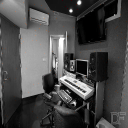

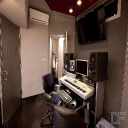

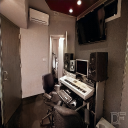

 19%|█▉        | 97/500 [00:02<00:09, 43.71it/s]

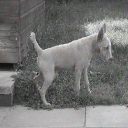

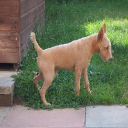

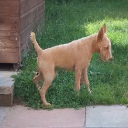

 39%|███▉      | 197/500 [00:04<00:07, 40.87it/s]

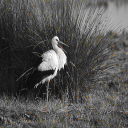

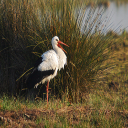

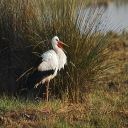

 60%|█████▉    | 298/500 [00:07<00:06, 30.65it/s]

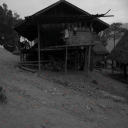

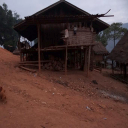

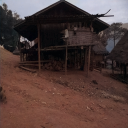

 80%|███████▉  | 399/500 [00:10<00:03, 33.32it/s]

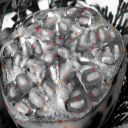

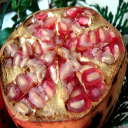

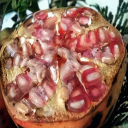

  0%|          | 1/1125 [00:00<01:52,  9.95it/s]


------------------------------------------------------------------
Epoch: 93	Time: 114.9411	Train Loss: 0.0092	Train PSNR 35.9085	Train SSIM 0.9523
------------------------------------------------------------------

[93] Validation Loss : 0.0088, Validation PSNR : 37.2526% ,Validation SSIM : 0.9513%

Epoch : [94] 0/1125 
 Training loss : 0.006610901094973087


  9%|▉         | 102/1125 [00:09<01:30, 11.25it/s]


Epoch : [94] 100/1125 
 Training loss : 0.00933060008516111


 18%|█▊        | 202/1125 [00:18<01:21, 11.35it/s]


Epoch : [94] 200/1125 
 Training loss : 0.009418701523664728


 27%|██▋       | 302/1125 [00:27<01:09, 11.77it/s]


Epoch : [94] 300/1125 
 Training loss : 0.009377386676228026


 36%|███▌      | 402/1125 [00:35<01:01, 11.79it/s]


Epoch : [94] 400/1125 
 Training loss : 0.009506485107914542


 45%|████▍     | 502/1125 [00:44<00:52, 11.84it/s]


Epoch : [94] 500/1125 
 Training loss : 0.009460358523546222


 54%|█████▎    | 602/1125 [00:52<00:45, 11.61it/s]


Epoch : [94] 600/1125 
 Training loss : 0.009359815480271216


 62%|██████▏   | 702/1125 [01:01<00:37, 11.39it/s]


Epoch : [94] 700/1125 
 Training loss : 0.009302874097398637


 71%|███████▏  | 802/1125 [01:10<00:28, 11.37it/s]


Epoch : [94] 800/1125 
 Training loss : 0.009318641872062683


 80%|████████  | 902/1125 [01:19<00:19, 11.48it/s]


Epoch : [94] 900/1125 
 Training loss : 0.009347911520740151


 89%|████████▉ | 1002/1125 [01:27<00:10, 11.51it/s]


Epoch : [94] 1000/1125 
 Training loss : 0.009422347844382013


 98%|█████████▊| 1102/1125 [01:36<00:01, 11.61it/s]


Epoch : [94] 1100/1125 
 Training loss : 0.009379286749785823


100%|██████████| 1125/1125 [01:38<00:00, 11.44it/s]



Finished training epoch 94
Total training loss : 0.009388899686642818 / psnr : 35.8498 / ssim : 0.9505


  0%|          | 0/500 [00:00<?, ?it/s]

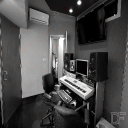

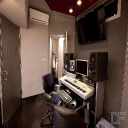

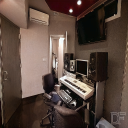

 19%|█▉        | 97/500 [00:02<00:09, 41.83it/s]

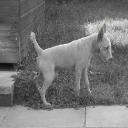

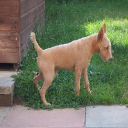

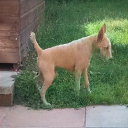

 40%|████      | 200/500 [00:04<00:06, 43.91it/s]

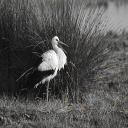

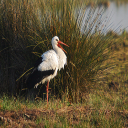

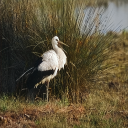

 60%|██████    | 300/500 [00:07<00:04, 43.56it/s]

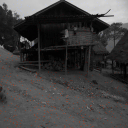

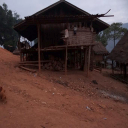

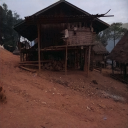

 80%|███████▉  | 398/500 [00:09<00:02, 34.84it/s]

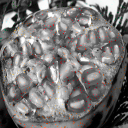

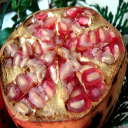

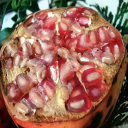

  0%|          | 1/1125 [00:00<02:02,  9.18it/s]


------------------------------------------------------------------
Epoch: 94	Time: 113.4186	Train Loss: 0.0094	Train PSNR 35.8498	Train SSIM 0.9505
------------------------------------------------------------------

[94] Validation Loss : 0.0096, Validation PSNR : 37.0350% ,Validation SSIM : 0.9479%

Epoch : [95] 0/1125 
 Training loss : 0.011234777979552746


  9%|▉         | 102/1125 [00:09<01:30, 11.30it/s]


Epoch : [95] 100/1125 
 Training loss : 0.00967994885574473


 18%|█▊        | 202/1125 [00:18<01:23, 11.08it/s]


Epoch : [95] 200/1125 
 Training loss : 0.009481869765385911


 27%|██▋       | 302/1125 [00:27<01:14, 11.06it/s]


Epoch : [95] 300/1125 
 Training loss : 0.009411203354733232


 36%|███▌      | 402/1125 [00:36<01:03, 11.36it/s]


Epoch : [95] 400/1125 
 Training loss : 0.009267310450489905


 45%|████▍     | 502/1125 [00:45<00:54, 11.51it/s]


Epoch : [95] 500/1125 
 Training loss : 0.009268007333206381


 54%|█████▎    | 602/1125 [00:53<00:45, 11.46it/s]


Epoch : [95] 600/1125 
 Training loss : 0.009271291132625844


 62%|██████▏   | 702/1125 [01:02<00:36, 11.59it/s]


Epoch : [95] 700/1125 
 Training loss : 0.00919159560779192


 71%|███████▏  | 802/1125 [01:10<00:27, 11.67it/s]


Epoch : [95] 800/1125 
 Training loss : 0.009195714897723792


 80%|████████  | 902/1125 [01:19<00:19, 11.30it/s]


Epoch : [95] 900/1125 
 Training loss : 0.009192975934131792


 89%|████████▉ | 1002/1125 [01:28<00:10, 11.54it/s]


Epoch : [95] 1000/1125 
 Training loss : 0.009140484640235222


 98%|█████████▊| 1102/1125 [01:37<00:02, 11.42it/s]


Epoch : [95] 1100/1125 
 Training loss : 0.009118748298819963


100%|██████████| 1125/1125 [01:39<00:00, 11.34it/s]



Finished training epoch 95
Total training loss : 0.009101254601859385 / psnr : 35.9771 / ssim : 0.9519


  0%|          | 0/500 [00:00<?, ?it/s]

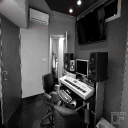

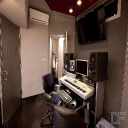

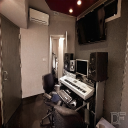

 19%|█▉        | 97/500 [00:02<00:09, 43.93it/s]

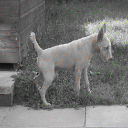

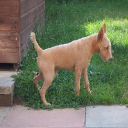

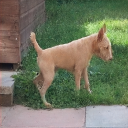

 40%|███▉      | 198/500 [00:04<00:06, 43.90it/s]

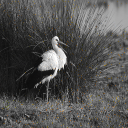

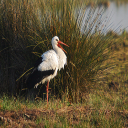

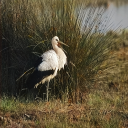

 60%|█████▉    | 298/500 [00:07<00:04, 44.69it/s]

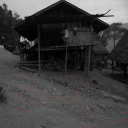

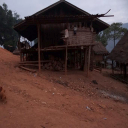

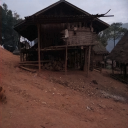

 80%|███████▉  | 398/500 [00:09<00:02, 40.64it/s]

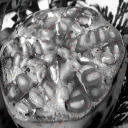

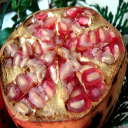

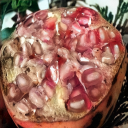

  0%|          | 0/1125 [00:00<?, ?it/s]


------------------------------------------------------------------
Epoch: 95	Time: 114.1111	Train Loss: 0.0091	Train PSNR 35.9771	Train SSIM 0.9519
------------------------------------------------------------------

[95] Validation Loss : 0.0092, Validation PSNR : 36.9971% ,Validation SSIM : 0.9493%

Epoch : [96] 0/1125 
 Training loss : 0.005195818841457367


  9%|▉         | 103/1125 [00:09<01:30, 11.28it/s]


Epoch : [96] 100/1125 
 Training loss : 0.008626929378266087


 18%|█▊        | 203/1125 [00:18<01:21, 11.30it/s]


Epoch : [96] 200/1125 
 Training loss : 0.008661511458400915


 27%|██▋       | 303/1125 [00:27<01:13, 11.16it/s]


Epoch : [96] 300/1125 
 Training loss : 0.008742785580963688


 36%|███▌      | 403/1125 [00:36<01:05, 11.00it/s]


Epoch : [96] 400/1125 
 Training loss : 0.008654468532586633


 45%|████▍     | 503/1125 [00:45<00:55, 11.17it/s]


Epoch : [96] 500/1125 
 Training loss : 0.008802341819627437


 54%|█████▎    | 603/1125 [00:54<00:46, 11.21it/s]


Epoch : [96] 600/1125 
 Training loss : 0.008798706392523602


 62%|██████▏   | 703/1125 [01:03<00:38, 11.09it/s]


Epoch : [96] 700/1125 
 Training loss : 0.008837442914855676


 71%|███████▏  | 803/1125 [01:12<00:28, 11.35it/s]


Epoch : [96] 800/1125 
 Training loss : 0.008893622443563632


 80%|████████  | 903/1125 [01:20<00:19, 11.26it/s]


Epoch : [96] 900/1125 
 Training loss : 0.008983762824719774


 89%|████████▉ | 1003/1125 [01:29<00:10, 11.61it/s]


Epoch : [96] 1000/1125 
 Training loss : 0.008982195164431463


 98%|█████████▊| 1103/1125 [01:38<00:01, 11.53it/s]


Epoch : [96] 1100/1125 
 Training loss : 0.008992433391061427


100%|██████████| 1125/1125 [01:40<00:00, 11.23it/s]



Finished training epoch 96
Total training loss : 0.009010196091400252 / psnr : 36.0337 / ssim : 0.9502


  0%|          | 0/500 [00:00<?, ?it/s]

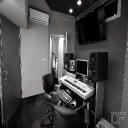

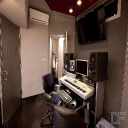

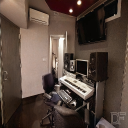

 20%|█▉        | 98/500 [00:02<00:08, 45.07it/s]

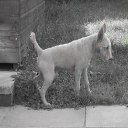

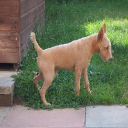

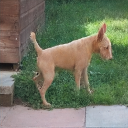

 40%|███▉      | 198/500 [00:04<00:06, 43.32it/s]

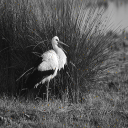

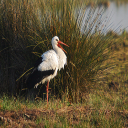

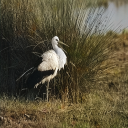

 60%|█████▉    | 298/500 [00:06<00:04, 43.87it/s]

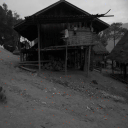

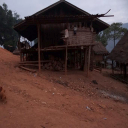

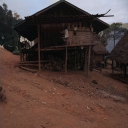

 80%|████████  | 400/500 [00:09<00:02, 36.60it/s]

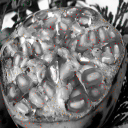

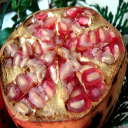

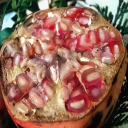

  0%|          | 1/1125 [00:00<02:21,  7.97it/s]


------------------------------------------------------------------
Epoch: 96	Time: 115.1581	Train Loss: 0.0090	Train PSNR 36.0337	Train SSIM 0.9502
------------------------------------------------------------------

[96] Validation Loss : 0.0097, Validation PSNR : 36.9669% ,Validation SSIM : 0.9468%

Epoch : [97] 0/1125 
 Training loss : 0.00809520948678255


  9%|▉         | 103/1125 [00:09<01:28, 11.57it/s]


Epoch : [97] 100/1125 
 Training loss : 0.009231909491711914


 18%|█▊        | 203/1125 [00:18<01:22, 11.13it/s]


Epoch : [97] 200/1125 
 Training loss : 0.008936782800754653


 27%|██▋       | 303/1125 [00:27<01:14, 10.99it/s]


Epoch : [97] 300/1125 
 Training loss : 0.008930573611213915


 36%|███▌      | 403/1125 [00:36<01:05, 10.95it/s]


Epoch : [97] 400/1125 
 Training loss : 0.008959401927265964


 45%|████▍     | 503/1125 [00:45<00:54, 11.44it/s]


Epoch : [97] 500/1125 
 Training loss : 0.00900948973569625


 54%|█████▎    | 603/1125 [00:54<00:46, 11.32it/s]


Epoch : [97] 600/1125 
 Training loss : 0.009041663756696338


 62%|██████▏   | 703/1125 [01:02<00:37, 11.23it/s]


Epoch : [97] 700/1125 
 Training loss : 0.009067924322557772


 71%|███████▏  | 803/1125 [01:11<00:28, 11.46it/s]


Epoch : [97] 800/1125 
 Training loss : 0.009057980884196756


 80%|████████  | 903/1125 [01:20<00:19, 11.21it/s]


Epoch : [97] 900/1125 
 Training loss : 0.009128012865488226


 89%|████████▉ | 1003/1125 [01:29<00:10, 11.17it/s]


Epoch : [97] 1000/1125 
 Training loss : 0.009094764719011036


 98%|█████████▊| 1103/1125 [01:38<00:01, 11.08it/s]


Epoch : [97] 1100/1125 
 Training loss : 0.009098285447542202


100%|██████████| 1125/1125 [01:40<00:00, 11.18it/s]



Finished training epoch 97
Total training loss : 0.009090451289382245 / psnr : 36.0162 / ssim : 0.9534


  0%|          | 0/500 [00:00<?, ?it/s]

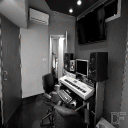

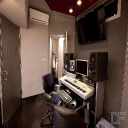

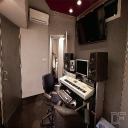

 19%|█▉        | 97/500 [00:02<00:09, 41.07it/s]

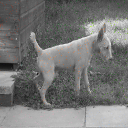

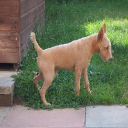

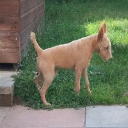

 40%|███▉      | 198/500 [00:04<00:06, 44.73it/s]

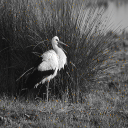

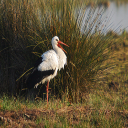

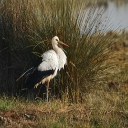

 60%|█████▉    | 299/500 [00:07<00:04, 43.26it/s]

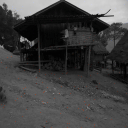

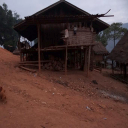

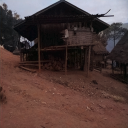

 80%|███████▉  | 398/500 [00:09<00:03, 32.56it/s]

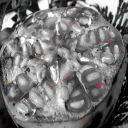

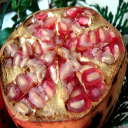

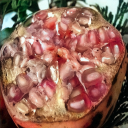

  0%|          | 0/1125 [00:00<?, ?it/s]


------------------------------------------------------------------
Epoch: 97	Time: 116.3389	Train Loss: 0.0091	Train PSNR 36.0162	Train SSIM 0.9534
------------------------------------------------------------------

[97] Validation Loss : 0.0091, Validation PSNR : 37.3430% ,Validation SSIM : 0.9508%

Epoch : [98] 0/1125 
 Training loss : 0.010239806026220322


  9%|▉         | 103/1125 [00:09<01:31, 11.20it/s]


Epoch : [98] 100/1125 
 Training loss : 0.008998398599906428


 18%|█▊        | 203/1125 [00:18<01:21, 11.38it/s]


Epoch : [98] 200/1125 
 Training loss : 0.008968060785228044


 27%|██▋       | 303/1125 [00:27<01:14, 10.98it/s]


Epoch : [98] 300/1125 
 Training loss : 0.008960256934710515


 36%|███▌      | 403/1125 [00:36<01:05, 11.03it/s]


Epoch : [98] 400/1125 
 Training loss : 0.008847488175167183


 45%|████▍     | 503/1125 [00:45<00:56, 11.08it/s]


Epoch : [98] 500/1125 
 Training loss : 0.008849894054449664


 54%|█████▎    | 603/1125 [00:54<00:46, 11.34it/s]


Epoch : [98] 600/1125 
 Training loss : 0.008855030916091954


 62%|██████▏   | 703/1125 [01:03<00:37, 11.18it/s]


Epoch : [98] 700/1125 
 Training loss : 0.008906608175077128


 71%|███████▏  | 803/1125 [01:11<00:27, 11.51it/s]


Epoch : [98] 800/1125 
 Training loss : 0.008979269015031882


 80%|████████  | 903/1125 [01:20<00:19, 11.29it/s]


Epoch : [98] 900/1125 
 Training loss : 0.00898585230996884


 89%|████████▉ | 1003/1125 [01:29<00:10, 11.56it/s]


Epoch : [98] 1000/1125 
 Training loss : 0.008974084918099742


 98%|█████████▊| 1103/1125 [01:38<00:01, 11.29it/s]


Epoch : [98] 1100/1125 
 Training loss : 0.00899145644679192


100%|██████████| 1125/1125 [01:40<00:00, 11.20it/s]



Finished training epoch 98
Total training loss : 0.008977674134903484 / psnr : 36.0648 / ssim : 0.9524


  0%|          | 0/500 [00:00<?, ?it/s]

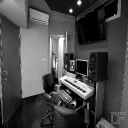

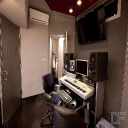

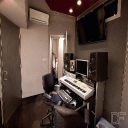

 20%|██        | 100/500 [00:02<00:10, 39.36it/s]

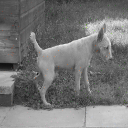

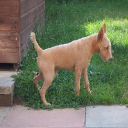

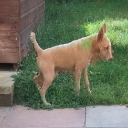

 39%|███▉      | 197/500 [00:05<00:10, 29.60it/s]

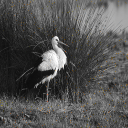

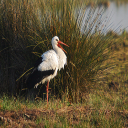

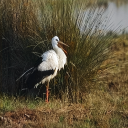

 60%|█████▉    | 298/500 [00:07<00:05, 38.79it/s]

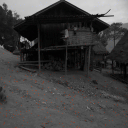

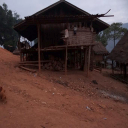

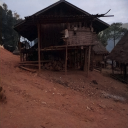

 80%|████████  | 400/500 [00:10<00:02, 33.52it/s]

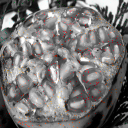

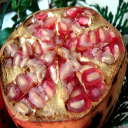

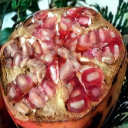

  0%|          | 1/1125 [00:00<02:20,  7.99it/s]


------------------------------------------------------------------
Epoch: 98	Time: 120.1196	Train Loss: 0.0090	Train PSNR 36.0648	Train SSIM 0.9524
------------------------------------------------------------------

[98] Validation Loss : 0.0081, Validation PSNR : 37.7310% ,Validation SSIM : 0.9526%

Epoch : [99] 0/1125 
 Training loss : 0.008819679729640484


  9%|▉         | 103/1125 [00:09<01:39, 10.26it/s]


Epoch : [99] 100/1125 
 Training loss : 0.0093795479745558


 18%|█▊        | 203/1125 [00:19<01:23, 11.06it/s]


Epoch : [99] 200/1125 
 Training loss : 0.00906214630926278


 27%|██▋       | 303/1125 [00:28<01:14, 10.97it/s]


Epoch : [99] 300/1125 
 Training loss : 0.00879722017875294


 36%|███▌      | 403/1125 [00:37<01:04, 11.16it/s]


Epoch : [99] 400/1125 
 Training loss : 0.008734581330117591


 45%|████▍     | 503/1125 [00:46<00:55, 11.19it/s]


Epoch : [99] 500/1125 
 Training loss : 0.008851222686484425


 54%|█████▎    | 603/1125 [00:55<00:45, 11.57it/s]


Epoch : [99] 600/1125 
 Training loss : 0.008979811987060179


 62%|██████▏   | 703/1125 [01:03<00:37, 11.37it/s]


Epoch : [99] 700/1125 
 Training loss : 0.00901787191996093


 71%|███████▏  | 803/1125 [01:12<00:29, 10.83it/s]


Epoch : [99] 800/1125 
 Training loss : 0.008974991188839208


 80%|████████  | 903/1125 [01:21<00:20, 11.00it/s]


Epoch : [99] 900/1125 
 Training loss : 0.009037747551231221


 89%|████████▉ | 1003/1125 [01:30<00:10, 11.13it/s]


Epoch : [99] 1000/1125 
 Training loss : 0.009040654983955782


 98%|█████████▊| 1103/1125 [01:39<00:01, 11.41it/s]


Epoch : [99] 1100/1125 
 Training loss : 0.009006523615600276


100%|██████████| 1125/1125 [01:41<00:00, 11.06it/s]



Finished training epoch 99
Total training loss : 0.009002760682668951 / psnr : 36.0441 / ssim : 0.9522


  0%|          | 0/500 [00:00<?, ?it/s]

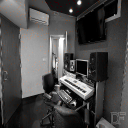

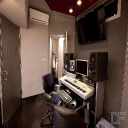

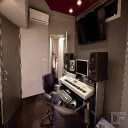

 20%|█▉        | 98/500 [00:02<00:10, 38.51it/s]

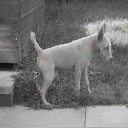

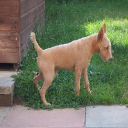

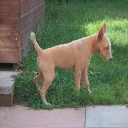

 40%|███▉      | 198/500 [00:04<00:06, 43.44it/s]

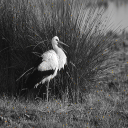

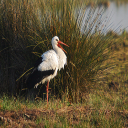

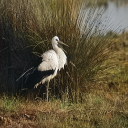

 60%|█████▉    | 299/500 [00:07<00:04, 42.42it/s]

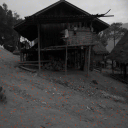

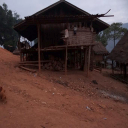

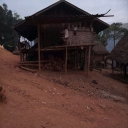

 79%|███████▉  | 396/500 [00:09<00:03, 28.84it/s]

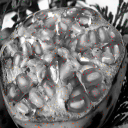

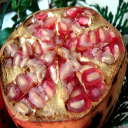

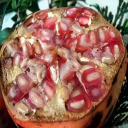

  0%|          | 0/1125 [00:00<?, ?it/s]


------------------------------------------------------------------
Epoch: 99	Time: 117.4807	Train Loss: 0.0090	Train PSNR 36.0441	Train SSIM 0.9522
------------------------------------------------------------------

[99] Validation Loss : 0.0098, Validation PSNR : 36.7850% ,Validation SSIM : 0.9529%

Epoch : [100] 0/1125 
 Training loss : 0.009972689673304558


  9%|▉         | 103/1125 [00:09<01:30, 11.30it/s]


Epoch : [100] 100/1125 
 Training loss : 0.008758739236336533


 18%|█▊        | 203/1125 [00:18<01:22, 11.21it/s]


Epoch : [100] 200/1125 
 Training loss : 0.008860456330970448


 27%|██▋       | 303/1125 [00:27<01:14, 11.09it/s]


Epoch : [100] 300/1125 
 Training loss : 0.008857717641638561


 36%|███▌      | 403/1125 [00:36<01:05, 10.99it/s]


Epoch : [100] 400/1125 
 Training loss : 0.008919722591050694


 45%|████▍     | 503/1125 [00:45<00:54, 11.49it/s]


Epoch : [100] 500/1125 
 Training loss : 0.008897350784093736


 54%|█████▎    | 603/1125 [00:54<00:45, 11.36it/s]


Epoch : [100] 600/1125 
 Training loss : 0.008927344456129086


 62%|██████▏   | 703/1125 [01:03<00:38, 11.01it/s]


Epoch : [100] 700/1125 
 Training loss : 0.009012441577977062


 71%|███████▏  | 803/1125 [01:11<00:28, 11.29it/s]


Epoch : [100] 800/1125 
 Training loss : 0.008964600349624133


 80%|████████  | 903/1125 [01:20<00:19, 11.39it/s]


Epoch : [100] 900/1125 
 Training loss : 0.008990860219060813


 89%|████████▉ | 1003/1125 [01:29<00:10, 11.31it/s]


Epoch : [100] 1000/1125 
 Training loss : 0.008997966929410513


 98%|█████████▊| 1103/1125 [01:38<00:01, 11.03it/s]


Epoch : [100] 1100/1125 
 Training loss : 0.00900978783016972


100%|██████████| 1125/1125 [01:40<00:00, 11.18it/s]



Finished training epoch 100
Total training loss : 0.009013647542231613 / psnr : 36.0356 / ssim : 0.9507


  0%|          | 0/500 [00:00<?, ?it/s]

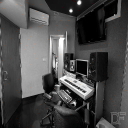

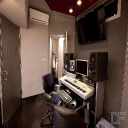

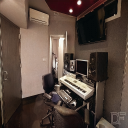

 19%|█▉        | 97/500 [00:02<00:10, 38.64it/s]

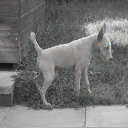

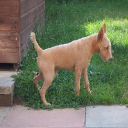

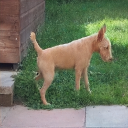

 40%|███▉      | 198/500 [00:05<00:08, 35.13it/s]

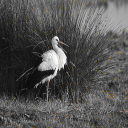

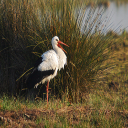

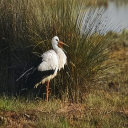

 60%|██████    | 300/500 [00:07<00:04, 42.08it/s]

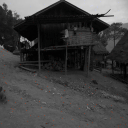

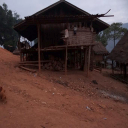

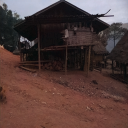

 80%|███████▉  | 399/500 [00:10<00:02, 36.91it/s]

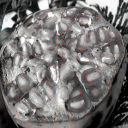

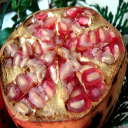

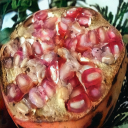

  0%|          | 0/1125 [00:00<?, ?it/s]


------------------------------------------------------------------
Epoch: 100	Time: 116.7963	Train Loss: 0.0090	Train PSNR 36.0356	Train SSIM 0.9507
------------------------------------------------------------------

[100] Validation Loss : 0.0095, Validation PSNR : 37.0281% ,Validation SSIM : 0.9451%

Epoch : [101] 0/1125 
 Training loss : 0.007500336971133947


  9%|▉         | 103/1125 [00:09<01:30, 11.33it/s]


Epoch : [101] 100/1125 
 Training loss : 0.008911343678684519


 18%|█▊        | 203/1125 [00:18<01:20, 11.47it/s]


Epoch : [101] 200/1125 
 Training loss : 0.009043239620027703


 27%|██▋       | 303/1125 [00:26<01:12, 11.29it/s]


Epoch : [101] 300/1125 
 Training loss : 0.009060273335262688


 36%|███▌      | 403/1125 [00:35<01:05, 11.06it/s]


Epoch : [101] 400/1125 
 Training loss : 0.009084395168957642


 45%|████▍     | 503/1125 [00:44<00:56, 11.00it/s]


Epoch : [101] 500/1125 
 Training loss : 0.009102656362864548


 54%|█████▎    | 603/1125 [00:53<00:46, 11.22it/s]


Epoch : [101] 600/1125 
 Training loss : 0.009148247175836028


 62%|██████▏   | 703/1125 [01:02<00:36, 11.48it/s]


Epoch : [101] 700/1125 
 Training loss : 0.009209375366828964


 71%|███████▏  | 803/1125 [01:11<00:29, 11.01it/s]


Epoch : [101] 800/1125 
 Training loss : 0.009196002185158664


 80%|████████  | 903/1125 [01:20<00:20, 10.97it/s]


Epoch : [101] 900/1125 
 Training loss : 0.009200872345874035


 89%|████████▉ | 1003/1125 [01:29<00:10, 11.27it/s]


Epoch : [101] 1000/1125 
 Training loss : 0.0091515090679387


 98%|█████████▊| 1103/1125 [01:38<00:01, 11.34it/s]


Epoch : [101] 1100/1125 
 Training loss : 0.00909908389001002


100%|██████████| 1125/1125 [01:40<00:00, 11.20it/s]



Finished training epoch 101
Total training loss : 0.009106656098945273 / psnr : 35.9634 / ssim : 0.9516


  0%|          | 0/500 [00:00<?, ?it/s]

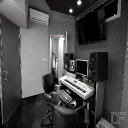

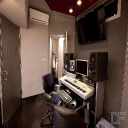

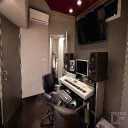

 19%|█▉        | 97/500 [00:02<00:09, 41.21it/s]

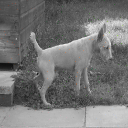

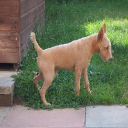

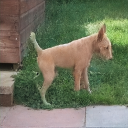

 39%|███▉      | 197/500 [00:04<00:06, 45.12it/s]

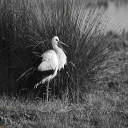

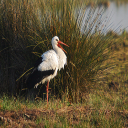

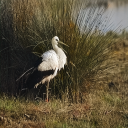

 59%|█████▉    | 297/500 [00:07<00:06, 29.28it/s]

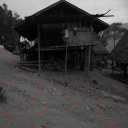

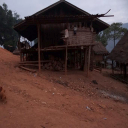

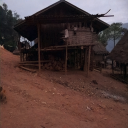

 80%|███████▉  | 398/500 [00:09<00:02, 35.76it/s]

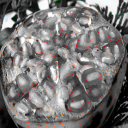

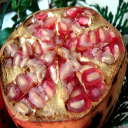

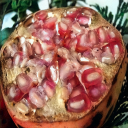

  0%|          | 2/1125 [00:00<01:44, 10.71it/s]


------------------------------------------------------------------
Epoch: 101	Time: 116.0639	Train Loss: 0.0091	Train PSNR 35.9634	Train SSIM 0.9516
------------------------------------------------------------------

[101] Validation Loss : 0.0092, Validation PSNR : 37.2169% ,Validation SSIM : 0.9517%

Epoch : [102] 0/1125 
 Training loss : 0.005671435967087746


  9%|▉         | 103/1125 [00:09<01:29, 11.36it/s]


Epoch : [102] 100/1125 
 Training loss : 0.008328208948789847


 18%|█▊        | 203/1125 [00:18<01:25, 10.81it/s]


Epoch : [102] 200/1125 
 Training loss : 0.008403121514607276


 27%|██▋       | 303/1125 [00:27<01:13, 11.19it/s]


Epoch : [102] 300/1125 
 Training loss : 0.008539234269472253


 36%|███▌      | 403/1125 [00:36<01:04, 11.14it/s]


Epoch : [102] 400/1125 
 Training loss : 0.008624839419940314


 45%|████▍     | 503/1125 [00:45<00:55, 11.21it/s]


Epoch : [102] 500/1125 
 Training loss : 0.008681443629567019


 54%|█████▎    | 603/1125 [00:54<00:46, 11.25it/s]


Epoch : [102] 600/1125 
 Training loss : 0.00870877149330449


 62%|██████▏   | 703/1125 [01:03<00:36, 11.44it/s]


Epoch : [102] 700/1125 
 Training loss : 0.008759056467738285


 71%|███████▏  | 803/1125 [01:12<00:28, 11.39it/s]


Epoch : [102] 800/1125 
 Training loss : 0.00877957885850049


 80%|████████  | 903/1125 [01:20<00:19, 11.41it/s]


Epoch : [102] 900/1125 
 Training loss : 0.008760837683522376


 89%|████████▉ | 1003/1125 [01:29<00:10, 11.22it/s]


Epoch : [102] 1000/1125 
 Training loss : 0.00881054122549864


 98%|█████████▊| 1103/1125 [01:38<00:01, 11.31it/s]


Epoch : [102] 1100/1125 
 Training loss : 0.008852774617799323


100%|██████████| 1125/1125 [01:40<00:00, 11.17it/s]



Finished training epoch 102
Total training loss : 0.008848418947723176 / psnr : 36.1130 / ssim : 0.9539


  0%|          | 0/500 [00:00<?, ?it/s]

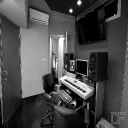

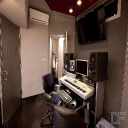

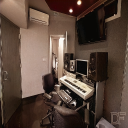

 20%|█▉        | 99/500 [00:02<00:10, 39.84it/s]

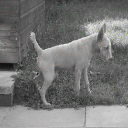

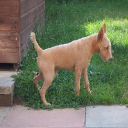

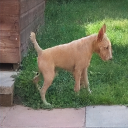

 40%|███▉      | 198/500 [00:05<00:08, 33.77it/s]

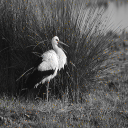

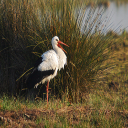

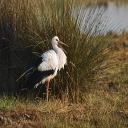

 59%|█████▉    | 296/500 [00:07<00:04, 42.23it/s]

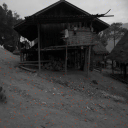

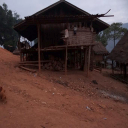

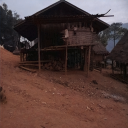

 80%|████████  | 400/500 [00:10<00:02, 37.52it/s]

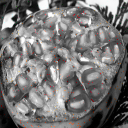

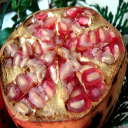

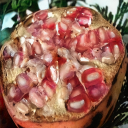

  0%|          | 0/1125 [00:00<?, ?it/s]


------------------------------------------------------------------
Epoch: 102	Time: 116.7166	Train Loss: 0.0088	Train PSNR 36.1130	Train SSIM 0.9539
------------------------------------------------------------------

[102] Validation Loss : 0.0100, Validation PSNR : 36.8314% ,Validation SSIM : 0.9481%

Epoch : [103] 0/1125 
 Training loss : 0.013357153162360191


  9%|▉         | 103/1125 [00:09<01:31, 11.23it/s]


Epoch : [103] 100/1125 
 Training loss : 0.009189073282229428


 18%|█▊        | 203/1125 [00:18<01:21, 11.35it/s]


Epoch : [103] 200/1125 
 Training loss : 0.009180715018002992


 27%|██▋       | 303/1125 [00:27<01:12, 11.35it/s]


Epoch : [103] 300/1125 
 Training loss : 0.00935986120272366


 36%|███▌      | 403/1125 [00:35<01:04, 11.20it/s]


Epoch : [103] 400/1125 
 Training loss : 0.009284338777991676


 45%|████▍     | 503/1125 [00:44<00:55, 11.13it/s]


Epoch : [103] 500/1125 
 Training loss : 0.009155455521287437


 54%|█████▎    | 603/1125 [00:53<00:47, 11.07it/s]


Epoch : [103] 600/1125 
 Training loss : 0.009071577728544665


 62%|██████▏   | 703/1125 [01:02<00:37, 11.34it/s]


Epoch : [103] 700/1125 
 Training loss : 0.009011920483732403


 71%|███████▏  | 803/1125 [01:11<00:28, 11.34it/s]


Epoch : [103] 800/1125 
 Training loss : 0.00894231167616097


 80%|████████  | 903/1125 [01:20<00:19, 11.51it/s]


Epoch : [103] 900/1125 
 Training loss : 0.00890442491824285


 89%|████████▉ | 1003/1125 [01:29<00:10, 11.30it/s]


Epoch : [103] 1000/1125 
 Training loss : 0.008899065270949226


 98%|█████████▊| 1103/1125 [01:38<00:01, 11.52it/s]


Epoch : [103] 1100/1125 
 Training loss : 0.008911838716100715


100%|██████████| 1125/1125 [01:39<00:00, 11.25it/s]



Finished training epoch 103
Total training loss : 0.008900714695867566 / psnr : 36.1517 / ssim : 0.9528


  0%|          | 0/500 [00:00<?, ?it/s]

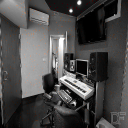

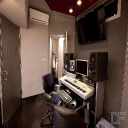

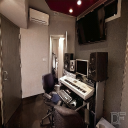

 20%|██        | 100/500 [00:02<00:10, 38.48it/s]

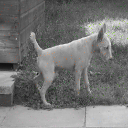

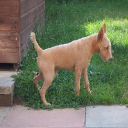

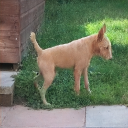

 39%|███▉      | 196/500 [00:04<00:07, 40.40it/s]

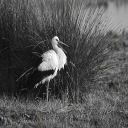

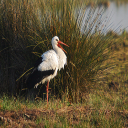

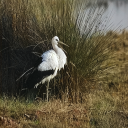

 60%|█████▉    | 298/500 [00:07<00:07, 26.06it/s]

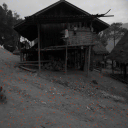

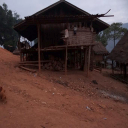

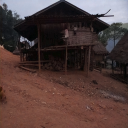

 80%|███████▉  | 398/500 [00:10<00:02, 34.37it/s]

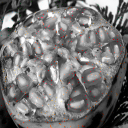

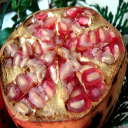

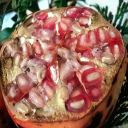

  0%|          | 1/1125 [00:00<02:08,  8.72it/s]


------------------------------------------------------------------
Epoch: 103	Time: 116.9538	Train Loss: 0.0089	Train PSNR 36.1517	Train SSIM 0.9528
------------------------------------------------------------------

[103] Validation Loss : 0.0091, Validation PSNR : 37.2453% ,Validation SSIM : 0.9508%

Epoch : [104] 0/1125 
 Training loss : 0.010631105862557888


  9%|▉         | 102/1125 [00:09<01:30, 11.34it/s]


Epoch : [104] 100/1125 
 Training loss : 0.00894900970622012


 18%|█▊        | 202/1125 [00:18<01:22, 11.20it/s]


Epoch : [104] 200/1125 
 Training loss : 0.008837580402840429


 27%|██▋       | 302/1125 [00:27<01:12, 11.28it/s]


Epoch : [104] 300/1125 
 Training loss : 0.008775068069514246


 36%|███▌      | 402/1125 [00:36<01:04, 11.15it/s]


Epoch : [104] 400/1125 
 Training loss : 0.008818420517650848


 45%|████▍     | 502/1125 [00:44<00:54, 11.49it/s]


Epoch : [104] 500/1125 
 Training loss : 0.008815823638711326


 54%|█████▎    | 602/1125 [00:53<00:47, 11.06it/s]


Epoch : [104] 600/1125 
 Training loss : 0.008819284865914684


 62%|██████▏   | 702/1125 [01:03<00:38, 10.85it/s]


Epoch : [104] 700/1125 
 Training loss : 0.008865686403866459


 71%|███████▏  | 802/1125 [01:12<00:29, 11.07it/s]


Epoch : [104] 800/1125 
 Training loss : 0.008920760029989682


 80%|████████  | 902/1125 [01:20<00:19, 11.28it/s]


Epoch : [104] 900/1125 
 Training loss : 0.008960529228467722


 89%|████████▉ | 1002/1125 [01:30<00:11, 11.07it/s]


Epoch : [104] 1000/1125 
 Training loss : 0.00893614592205558


 98%|█████████▊| 1102/1125 [01:38<00:02, 11.20it/s]


Epoch : [104] 1100/1125 
 Training loss : 0.008973999870949502


100%|██████████| 1125/1125 [01:41<00:00, 11.13it/s]



Finished training epoch 104
Total training loss : 0.008980549547821284 / psnr : 36.0619 / ssim : 0.9505


  0%|          | 0/500 [00:00<?, ?it/s]

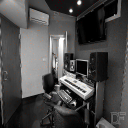

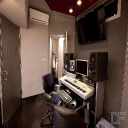

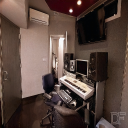

 19%|█▉        | 97/500 [00:02<00:09, 40.48it/s]

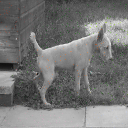

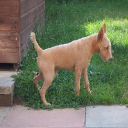

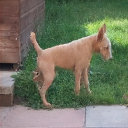

 40%|███▉      | 198/500 [00:04<00:07, 41.20it/s]

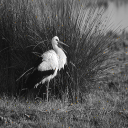

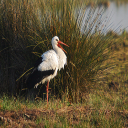

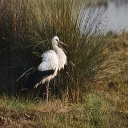

 60%|█████▉    | 298/500 [00:07<00:05, 39.88it/s]

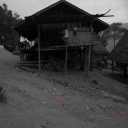

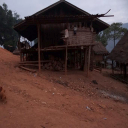

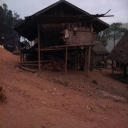

 79%|███████▉  | 397/500 [00:09<00:03, 33.94it/s]

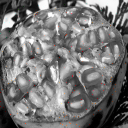

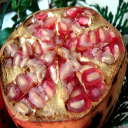

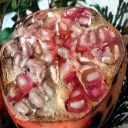

  0%|          | 0/1125 [00:00<?, ?it/s]


------------------------------------------------------------------
Epoch: 104	Time: 116.9886	Train Loss: 0.0090	Train PSNR 36.0619	Train SSIM 0.9505
------------------------------------------------------------------

[104] Validation Loss : 0.0098, Validation PSNR : 36.6400% ,Validation SSIM : 0.9509%

Epoch : [105] 0/1125 
 Training loss : 0.012233360670506954


  9%|▉         | 103/1125 [00:09<01:31, 11.12it/s]


Epoch : [105] 100/1125 
 Training loss : 0.008906042277075277


 18%|█▊        | 203/1125 [00:18<01:23, 11.10it/s]


Epoch : [105] 200/1125 
 Training loss : 0.008994300516127651


 27%|██▋       | 303/1125 [00:27<01:11, 11.43it/s]


Epoch : [105] 300/1125 
 Training loss : 0.008913206966884706


 36%|███▌      | 403/1125 [00:36<01:04, 11.21it/s]


Epoch : [105] 400/1125 
 Training loss : 0.0088016027933047


 45%|████▍     | 503/1125 [00:45<00:55, 11.12it/s]


Epoch : [105] 500/1125 
 Training loss : 0.0088075732695173


 54%|█████▎    | 603/1125 [00:54<00:47, 10.88it/s]


Epoch : [105] 600/1125 
 Training loss : 0.008754707407206297


 62%|██████▏   | 703/1125 [01:03<00:36, 11.47it/s]


Epoch : [105] 700/1125 
 Training loss : 0.008747824058521236


 71%|███████▏  | 803/1125 [01:11<00:27, 11.62it/s]


Epoch : [105] 800/1125 
 Training loss : 0.008776636917455664


 80%|████████  | 903/1125 [01:20<00:19, 11.25it/s]


Epoch : [105] 900/1125 
 Training loss : 0.008733444816156908


 89%|████████▉ | 1003/1125 [01:29<00:10, 11.42it/s]


Epoch : [105] 1000/1125 
 Training loss : 0.00875542060305531


 98%|█████████▊| 1103/1125 [01:38<00:01, 11.08it/s]


Epoch : [105] 1100/1125 
 Training loss : 0.008801754084428423


100%|██████████| 1125/1125 [01:40<00:00, 11.21it/s]



Finished training epoch 105
Total training loss : 0.008805304531008005 / psnr : 36.1847 / ssim : 0.9503


  0%|          | 0/500 [00:00<?, ?it/s]

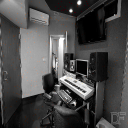

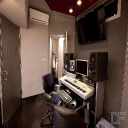

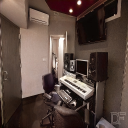

 19%|█▉        | 96/500 [00:02<00:10, 40.06it/s]

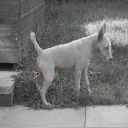

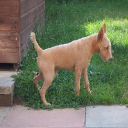

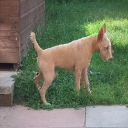

 39%|███▉      | 197/500 [00:05<00:07, 41.23it/s]

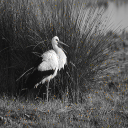

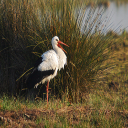

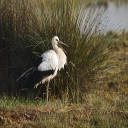

 60%|█████▉    | 298/500 [00:07<00:05, 38.40it/s]

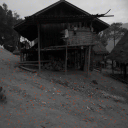

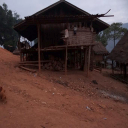

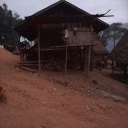

 80%|███████▉  | 399/500 [00:10<00:02, 35.83it/s]

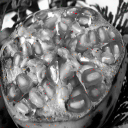

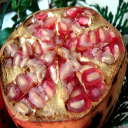

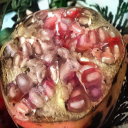

  0%|          | 1/1125 [00:00<02:04,  9.01it/s]


------------------------------------------------------------------
Epoch: 105	Time: 116.7329	Train Loss: 0.0088	Train PSNR 36.1847	Train SSIM 0.9503
------------------------------------------------------------------

[105] Validation Loss : 0.0097, Validation PSNR : 37.0034% ,Validation SSIM : 0.9453%

Epoch : [106] 0/1125 
 Training loss : 0.010526868514716625


  9%|▉         | 102/1125 [00:09<01:29, 11.39it/s]


Epoch : [106] 100/1125 
 Training loss : 0.008660511113703251


 18%|█▊        | 202/1125 [00:18<01:21, 11.31it/s]


Epoch : [106] 200/1125 
 Training loss : 0.008603957113323372


 27%|██▋       | 302/1125 [00:27<01:13, 11.24it/s]


Epoch : [106] 300/1125 
 Training loss : 0.008657888996653085


 36%|███▌      | 402/1125 [00:35<01:02, 11.51it/s]


Epoch : [106] 400/1125 
 Training loss : 0.008691156560559745


 45%|████▍     | 502/1125 [00:44<00:54, 11.41it/s]


Epoch : [106] 500/1125 
 Training loss : 0.00877582781414637


 54%|█████▎    | 602/1125 [00:53<00:49, 10.67it/s]


Epoch : [106] 600/1125 
 Training loss : 0.008815036865010138


 62%|██████▏   | 702/1125 [01:02<00:39, 10.82it/s]


Epoch : [106] 700/1125 
 Training loss : 0.00889084462047197


 71%|███████▏  | 802/1125 [01:11<00:28, 11.46it/s]


Epoch : [106] 800/1125 
 Training loss : 0.008885217654389724


 80%|████████  | 902/1125 [01:20<00:19, 11.20it/s]


Epoch : [106] 900/1125 
 Training loss : 0.008888805021514307


 89%|████████▉ | 1002/1125 [01:29<00:11, 11.17it/s]


Epoch : [106] 1000/1125 
 Training loss : 0.008916432470581928


 98%|█████████▊| 1102/1125 [01:38<00:02, 11.49it/s]


Epoch : [106] 1100/1125 
 Training loss : 0.008922265516044225


100%|██████████| 1125/1125 [01:40<00:00, 11.23it/s]



Finished training epoch 106
Total training loss : 0.008920643402056562 / psnr : 36.1025 / ssim : 0.9525


  0%|          | 0/500 [00:00<?, ?it/s]

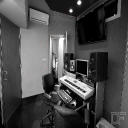

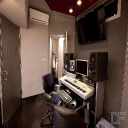

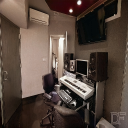

 20%|█▉        | 98/500 [00:02<00:08, 46.92it/s]

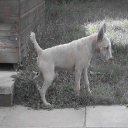

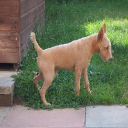

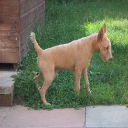

 40%|███▉      | 199/500 [00:04<00:06, 46.66it/s]

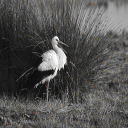

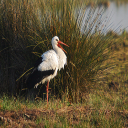

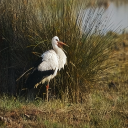

 60%|█████▉    | 299/500 [00:06<00:04, 43.69it/s]

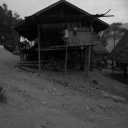

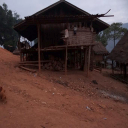

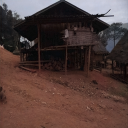

 80%|███████▉  | 399/500 [00:09<00:02, 35.78it/s]

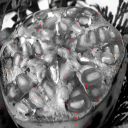

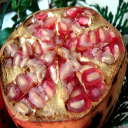

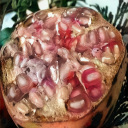

  0%|          | 1/1125 [00:00<01:57,  9.59it/s]


------------------------------------------------------------------
Epoch: 106	Time: 115.5136	Train Loss: 0.0089	Train PSNR 36.1025	Train SSIM 0.9525
------------------------------------------------------------------

[106] Validation Loss : 0.0098, Validation PSNR : 36.7015% ,Validation SSIM : 0.9478%

Epoch : [107] 0/1125 
 Training loss : 0.010479375720024109


  9%|▉         | 102/1125 [00:09<01:31, 11.19it/s]


Epoch : [107] 100/1125 
 Training loss : 0.009085792485661435


 18%|█▊        | 202/1125 [00:18<01:25, 10.85it/s]


Epoch : [107] 200/1125 
 Training loss : 0.008946727984469032


 27%|██▋       | 302/1125 [00:27<01:11, 11.47it/s]


Epoch : [107] 300/1125 
 Training loss : 0.008969532353710693


 36%|███▌      | 402/1125 [00:36<01:06, 10.85it/s]


Epoch : [107] 400/1125 
 Training loss : 0.009083188222512193


 45%|████▍     | 502/1125 [00:45<00:55, 11.16it/s]


Epoch : [107] 500/1125 
 Training loss : 0.009059615297514402


 54%|█████▎    | 602/1125 [00:54<00:47, 10.96it/s]


Epoch : [107] 600/1125 
 Training loss : 0.009043281157183369


 62%|██████▏   | 702/1125 [01:03<00:37, 11.28it/s]


Epoch : [107] 700/1125 
 Training loss : 0.009012174731473865


 71%|███████▏  | 802/1125 [01:12<00:28, 11.20it/s]


Epoch : [107] 800/1125 
 Training loss : 0.00896098856615384


 80%|████████  | 902/1125 [01:21<00:19, 11.35it/s]


Epoch : [107] 900/1125 
 Training loss : 0.008955808425659146


 89%|████████▉ | 1002/1125 [01:30<00:10, 11.25it/s]


Epoch : [107] 1000/1125 
 Training loss : 0.008931299112830218


 98%|█████████▊| 1102/1125 [01:38<00:02, 11.20it/s]


Epoch : [107] 1100/1125 
 Training loss : 0.008917337784680667


100%|██████████| 1125/1125 [01:41<00:00, 11.13it/s]



Finished training epoch 107
Total training loss : 0.008901954270071453 / psnr : 36.1290 / ssim : 0.9542


  0%|          | 0/500 [00:00<?, ?it/s]

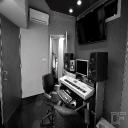

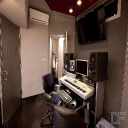

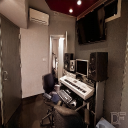

 19%|█▉        | 97/500 [00:02<00:09, 40.59it/s]

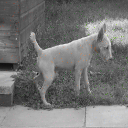

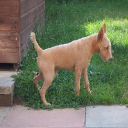

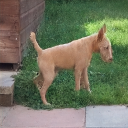

 39%|███▉      | 196/500 [00:04<00:07, 41.16it/s]

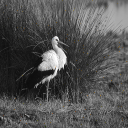

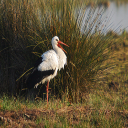

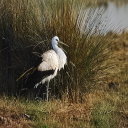

 60%|█████▉    | 298/500 [00:07<00:05, 39.21it/s]

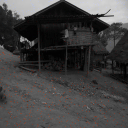

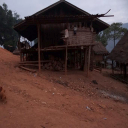

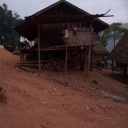

 80%|████████  | 400/500 [00:10<00:02, 33.55it/s]

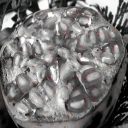

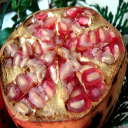

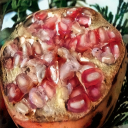

  0%|          | 2/1125 [00:00<01:48, 10.36it/s]


------------------------------------------------------------------
Epoch: 107	Time: 117.2771	Train Loss: 0.0089	Train PSNR 36.1290	Train SSIM 0.9542
------------------------------------------------------------------

[107] Validation Loss : 0.0093, Validation PSNR : 37.1743% ,Validation SSIM : 0.9568%

Epoch : [108] 0/1125 
 Training loss : 0.009719891473650932


  9%|▉         | 102/1125 [00:09<01:27, 11.64it/s]


Epoch : [108] 100/1125 
 Training loss : 0.008888727003284315


 18%|█▊        | 202/1125 [00:18<01:21, 11.34it/s]


Epoch : [108] 200/1125 
 Training loss : 0.008967275755591135


 27%|██▋       | 302/1125 [00:26<01:11, 11.55it/s]


Epoch : [108] 300/1125 
 Training loss : 0.009054196057098599


 36%|███▌      | 402/1125 [00:35<01:03, 11.33it/s]


Epoch : [108] 400/1125 
 Training loss : 0.00900097773991005


 45%|████▍     | 502/1125 [00:44<00:55, 11.14it/s]


Epoch : [108] 500/1125 
 Training loss : 0.009035823725911225


 54%|█████▎    | 602/1125 [00:53<00:47, 11.05it/s]


Epoch : [108] 600/1125 
 Training loss : 0.009083066812442142


 62%|██████▏   | 702/1125 [01:02<00:38, 10.94it/s]


Epoch : [108] 700/1125 
 Training loss : 0.009034314640889345


 71%|███████▏  | 802/1125 [01:11<00:29, 11.06it/s]


Epoch : [108] 800/1125 
 Training loss : 0.00903678822014876


 80%|████████  | 902/1125 [01:20<00:19, 11.33it/s]


Epoch : [108] 900/1125 
 Training loss : 0.00898796100645935


 89%|████████▉ | 1002/1125 [01:29<00:10, 11.27it/s]


Epoch : [108] 1000/1125 
 Training loss : 0.008997873487565053


 98%|█████████▊| 1102/1125 [01:38<00:02, 11.16it/s]


Epoch : [108] 1100/1125 
 Training loss : 0.009175968514400095


100%|██████████| 1125/1125 [01:40<00:00, 11.24it/s]



Finished training epoch 108
Total training loss : 0.009181779293757346 / psnr : 35.9643 / ssim : 0.9510


  0%|          | 0/500 [00:00<?, ?it/s]

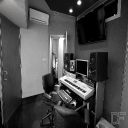

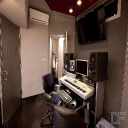

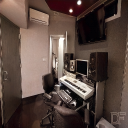

 20%|██        | 100/500 [00:02<00:09, 43.71it/s]

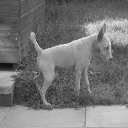

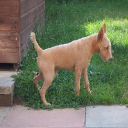

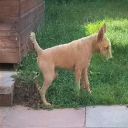

 40%|███▉      | 199/500 [00:04<00:06, 43.41it/s]

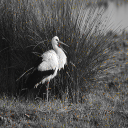

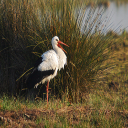

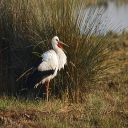

 60%|██████    | 300/500 [00:07<00:04, 43.21it/s]

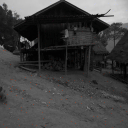

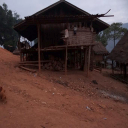

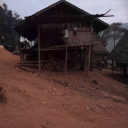

 80%|████████  | 400/500 [00:10<00:03, 32.03it/s]

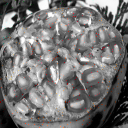

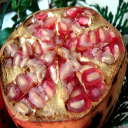

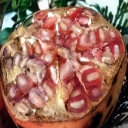

  0%|          | 1/1125 [00:00<01:53,  9.93it/s]


------------------------------------------------------------------
Epoch: 108	Time: 115.9137	Train Loss: 0.0092	Train PSNR 35.9643	Train SSIM 0.9510
------------------------------------------------------------------

[108] Validation Loss : 0.0094, Validation PSNR : 37.0425% ,Validation SSIM : 0.9504%

Epoch : [109] 0/1125 
 Training loss : 0.009637190960347652


  9%|▉         | 102/1125 [00:09<01:33, 10.89it/s]


Epoch : [109] 100/1125 
 Training loss : 0.009228668484541744


 18%|█▊        | 202/1125 [00:18<01:23, 11.02it/s]


Epoch : [109] 200/1125 
 Training loss : 0.009097584752616152


 27%|██▋       | 302/1125 [00:27<01:12, 11.35it/s]


Epoch : [109] 300/1125 
 Training loss : 0.009201956898951749


 36%|███▌      | 402/1125 [00:36<01:03, 11.36it/s]


Epoch : [109] 400/1125 
 Training loss : 0.009106016489084894


 45%|████▍     | 502/1125 [00:45<00:55, 11.23it/s]


Epoch : [109] 500/1125 
 Training loss : 0.009058710931244487


 54%|█████▎    | 602/1125 [00:54<00:47, 11.04it/s]


Epoch : [109] 600/1125 
 Training loss : 0.009017571717029601


 62%|██████▏   | 702/1125 [01:02<00:39, 10.74it/s]


Epoch : [109] 700/1125 
 Training loss : 0.008954837989359669


 71%|███████▏  | 802/1125 [01:12<00:28, 11.15it/s]


Epoch : [109] 800/1125 
 Training loss : 0.008996408104840736


 80%|████████  | 902/1125 [01:21<00:20, 11.13it/s]


Epoch : [109] 900/1125 
 Training loss : 0.00896522615334385


 89%|████████▉ | 1002/1125 [01:30<00:10, 11.35it/s]


Epoch : [109] 1000/1125 
 Training loss : 0.008920535267043214


 98%|█████████▊| 1102/1125 [01:38<00:02, 11.23it/s]


Epoch : [109] 1100/1125 
 Training loss : 0.008886144249078283


100%|██████████| 1125/1125 [01:40<00:00, 11.16it/s]



Finished training epoch 109
Total training loss : 0.00888445928816994 / psnr : 36.1168 / ssim : 0.9519


  0%|          | 0/500 [00:00<?, ?it/s]

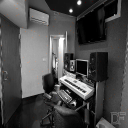

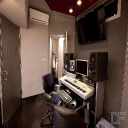

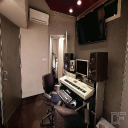

 20%|█▉        | 99/500 [00:02<00:09, 44.43it/s]

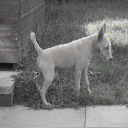

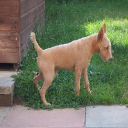

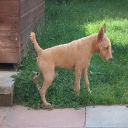

 40%|████      | 200/500 [00:04<00:06, 43.58it/s]

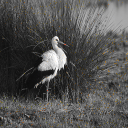

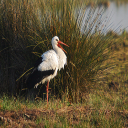

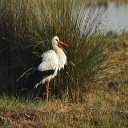

 59%|█████▉    | 296/500 [00:06<00:04, 44.94it/s]

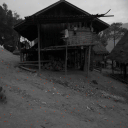

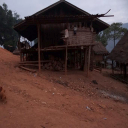

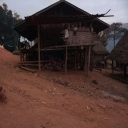

 80%|███████▉  | 398/500 [00:09<00:02, 35.92it/s]

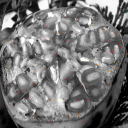

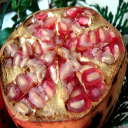

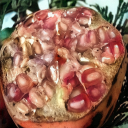

  0%|          | 2/1125 [00:00<01:43, 10.82it/s]


------------------------------------------------------------------
Epoch: 109	Time: 119.5053	Train Loss: 0.0089	Train PSNR 36.1168	Train SSIM 0.9519
------------------------------------------------------------------

[109] Validation Loss : 0.0084, Validation PSNR : 37.8227% ,Validation SSIM : 0.9498%

Epoch : [110] 0/1125 
 Training loss : 0.007888788357377052


  9%|▉         | 103/1125 [00:09<01:38, 10.38it/s]


Epoch : [110] 100/1125 
 Training loss : 0.009089215437300725


 18%|█▊        | 203/1125 [00:19<01:22, 11.18it/s]


Epoch : [110] 200/1125 
 Training loss : 0.008858552466688761


 27%|██▋       | 303/1125 [00:28<01:15, 10.93it/s]


Epoch : [110] 300/1125 
 Training loss : 0.008902383171504618


 36%|███▌      | 403/1125 [00:37<01:03, 11.36it/s]


Epoch : [110] 400/1125 
 Training loss : 0.00878665990258876


 45%|████▍     | 503/1125 [00:46<00:57, 10.86it/s]


Epoch : [110] 500/1125 
 Training loss : 0.00874225445511842


 54%|█████▎    | 603/1125 [00:55<00:47, 11.06it/s]


Epoch : [110] 600/1125 
 Training loss : 0.00876811385687794


 62%|██████▏   | 703/1125 [01:04<00:38, 11.00it/s]


Epoch : [110] 700/1125 
 Training loss : 0.008765730545185134


 71%|███████▏  | 803/1125 [01:13<00:28, 11.23it/s]


Epoch : [110] 800/1125 
 Training loss : 0.008761752377637428


 80%|████████  | 903/1125 [01:22<00:19, 11.45it/s]


Epoch : [110] 900/1125 
 Training loss : 0.008784600742860024


 89%|████████▉ | 1003/1125 [01:30<00:10, 11.31it/s]


Epoch : [110] 1000/1125 
 Training loss : 0.00878267502877396


 98%|█████████▊| 1103/1125 [01:39<00:01, 11.36it/s]


Epoch : [110] 1100/1125 
 Training loss : 0.008793412596088826


100%|██████████| 1125/1125 [01:41<00:00, 11.07it/s]



Finished training epoch 110
Total training loss : 0.008783839987383949 / psnr : 36.2199 / ssim : 0.9540


  0%|          | 0/500 [00:00<?, ?it/s]

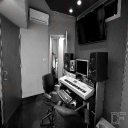

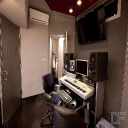

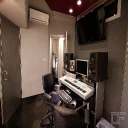

 19%|█▉        | 96/500 [00:02<00:10, 40.31it/s]

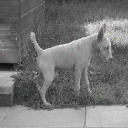

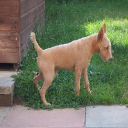

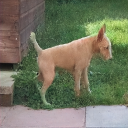

 40%|████      | 200/500 [00:05<00:07, 37.57it/s]

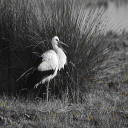

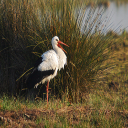

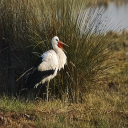

 60%|██████    | 300/500 [00:07<00:05, 36.83it/s]

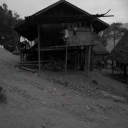

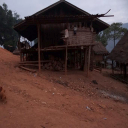

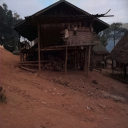

 79%|███████▉  | 396/500 [00:10<00:03, 30.99it/s]

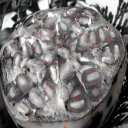

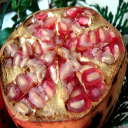

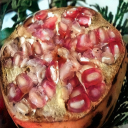

  0%|          | 0/1125 [00:00<?, ?it/s]


------------------------------------------------------------------
Epoch: 110	Time: 121.2601	Train Loss: 0.0088	Train PSNR 36.2199	Train SSIM 0.9540
------------------------------------------------------------------

[110] Validation Loss : 0.0082, Validation PSNR : 37.8815% ,Validation SSIM : 0.9535%

Epoch : [111] 0/1125 
 Training loss : 0.006900999695062637


  9%|▉         | 102/1125 [00:09<01:42, 10.03it/s]


Epoch : [111] 100/1125 
 Training loss : 0.009362761180220855


 18%|█▊        | 202/1125 [00:19<01:23, 10.99it/s]


Epoch : [111] 200/1125 
 Training loss : 0.009407349447464913


 27%|██▋       | 302/1125 [00:27<01:11, 11.45it/s]


Epoch : [111] 300/1125 
 Training loss : 0.009334325400549312


 36%|███▌      | 402/1125 [00:36<01:03, 11.33it/s]


Epoch : [111] 400/1125 
 Training loss : 0.009227963648690028


 45%|████▍     | 502/1125 [00:45<00:55, 11.23it/s]


Epoch : [111] 500/1125 
 Training loss : 0.00913041853671243


 54%|█████▎    | 602/1125 [00:54<00:48, 10.78it/s]


Epoch : [111] 600/1125 
 Training loss : 0.009054791069932022


 62%|██████▏   | 702/1125 [01:03<00:39, 10.84it/s]


Epoch : [111] 700/1125 
 Training loss : 0.009006983819769724


 71%|███████▏  | 802/1125 [01:12<00:29, 11.02it/s]


Epoch : [111] 800/1125 
 Training loss : 0.008952456589825405


 80%|████████  | 902/1125 [01:21<00:20, 11.11it/s]


Epoch : [111] 900/1125 
 Training loss : 0.00894415848418144


 89%|████████▉ | 1002/1125 [01:30<00:11, 11.09it/s]


Epoch : [111] 1000/1125 
 Training loss : 0.008913151828663332


 98%|█████████▊| 1102/1125 [01:39<00:02, 11.12it/s]


Epoch : [111] 1100/1125 
 Training loss : 0.008876724131439188


100%|██████████| 1125/1125 [01:41<00:00, 11.07it/s]



Finished training epoch 111
Total training loss : 0.008876993561784426 / psnr : 36.1358 / ssim : 0.9554


  0%|          | 0/500 [00:00<?, ?it/s]

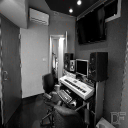

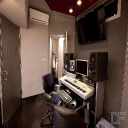

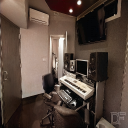

 19%|█▉        | 97/500 [00:02<00:09, 42.10it/s]

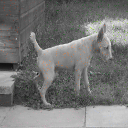

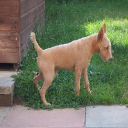

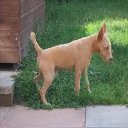

 39%|███▉      | 196/500 [00:04<00:06, 43.55it/s]

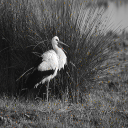

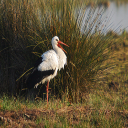

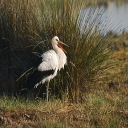

 59%|█████▉    | 296/500 [00:07<00:04, 45.90it/s]

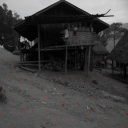

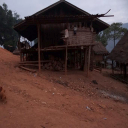

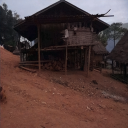

 80%|███████▉  | 398/500 [00:10<00:02, 34.38it/s]

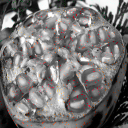

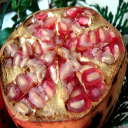

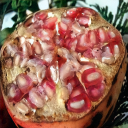

  0%|          | 1/1125 [00:00<01:57,  9.54it/s]


------------------------------------------------------------------
Epoch: 111	Time: 117.5015	Train Loss: 0.0089	Train PSNR 36.1358	Train SSIM 0.9554
------------------------------------------------------------------

[111] Validation Loss : 0.0088, Validation PSNR : 37.5530% ,Validation SSIM : 0.9501%

Epoch : [112] 0/1125 
 Training loss : 0.00831475481390953


  9%|▉         | 103/1125 [00:09<01:31, 11.13it/s]


Epoch : [112] 100/1125 
 Training loss : 0.008373091292410794


 18%|█▊        | 203/1125 [00:18<01:26, 10.69it/s]


Epoch : [112] 200/1125 
 Training loss : 0.008597225460469426


 27%|██▋       | 303/1125 [00:27<01:13, 11.19it/s]


Epoch : [112] 300/1125 
 Training loss : 0.008707125530426586


 36%|███▌      | 403/1125 [00:36<01:03, 11.30it/s]


Epoch : [112] 400/1125 
 Training loss : 0.008739579026529245


 45%|████▍     | 503/1125 [00:45<00:54, 11.33it/s]


Epoch : [112] 500/1125 
 Training loss : 0.008705195507960405


 54%|█████▎    | 603/1125 [00:54<00:45, 11.43it/s]


Epoch : [112] 600/1125 
 Training loss : 0.008737166856916098


 62%|██████▏   | 703/1125 [01:03<00:37, 11.21it/s]


Epoch : [112] 700/1125 
 Training loss : 0.008739648571506291


 71%|███████▏  | 803/1125 [01:12<00:29, 10.87it/s]


Epoch : [112] 800/1125 
 Training loss : 0.008756104853241409


 80%|████████  | 903/1125 [01:21<00:19, 11.16it/s]


Epoch : [112] 900/1125 
 Training loss : 0.008791172976701725


 89%|████████▉ | 1003/1125 [01:30<00:10, 11.19it/s]


Epoch : [112] 1000/1125 
 Training loss : 0.008844752130298675


 98%|█████████▊| 1103/1125 [01:39<00:01, 11.02it/s]


Epoch : [112] 1100/1125 
 Training loss : 0.008836989239413125


100%|██████████| 1125/1125 [01:41<00:00, 11.06it/s]



Finished training epoch 112
Total training loss : 0.008835278605421383 / psnr : 36.1293 / ssim : 0.9512


  0%|          | 0/500 [00:00<?, ?it/s]

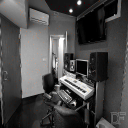

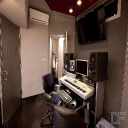

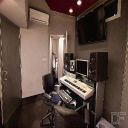

 19%|█▉        | 97/500 [00:02<00:10, 37.28it/s]

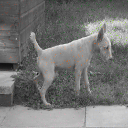

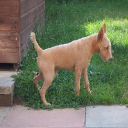

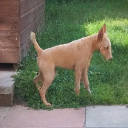

 40%|███▉      | 198/500 [00:05<00:08, 37.45it/s]

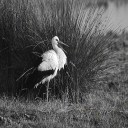

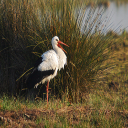

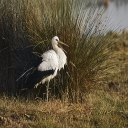

 59%|█████▉    | 297/500 [00:08<00:07, 28.44it/s]

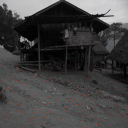

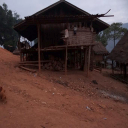

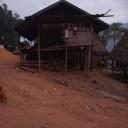

 80%|███████▉  | 399/500 [00:10<00:02, 34.83it/s]

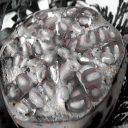

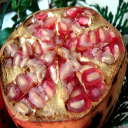

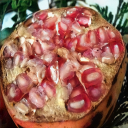

  0%|          | 1/1125 [00:00<01:59,  9.40it/s]


------------------------------------------------------------------
Epoch: 112	Time: 118.5892	Train Loss: 0.0088	Train PSNR 36.1293	Train SSIM 0.9512
------------------------------------------------------------------

[112] Validation Loss : 0.0101, Validation PSNR : 36.6817% ,Validation SSIM : 0.9475%

Epoch : [113] 0/1125 
 Training loss : 0.006744494661688805


  9%|▉         | 103/1125 [00:09<01:28, 11.53it/s]


Epoch : [113] 100/1125 
 Training loss : 0.009088344991871037


 18%|█▊        | 203/1125 [00:18<01:25, 10.76it/s]


Epoch : [113] 200/1125 
 Training loss : 0.009103755846582538


 27%|██▋       | 303/1125 [00:27<01:13, 11.22it/s]


Epoch : [113] 300/1125 
 Training loss : 0.008923258663362443


 36%|███▌      | 403/1125 [00:36<01:04, 11.24it/s]


Epoch : [113] 400/1125 
 Training loss : 0.008922872952234344


 45%|████▍     | 503/1125 [00:45<00:54, 11.33it/s]


Epoch : [113] 500/1125 
 Training loss : 0.00897331988743828


 54%|█████▎    | 603/1125 [00:54<00:47, 11.07it/s]


Epoch : [113] 600/1125 
 Training loss : 0.008941733383708409


 62%|██████▏   | 703/1125 [01:03<00:39, 10.74it/s]


Epoch : [113] 700/1125 
 Training loss : 0.008906024269701197


 71%|███████▏  | 803/1125 [01:12<00:28, 11.33it/s]


Epoch : [113] 800/1125 
 Training loss : 0.00889784676521626


 80%|████████  | 903/1125 [01:21<00:19, 11.15it/s]


Epoch : [113] 900/1125 
 Training loss : 0.008860425387388229


 89%|████████▉ | 1003/1125 [01:30<00:10, 11.27it/s]


Epoch : [113] 1000/1125 
 Training loss : 0.008831661987722247


 98%|█████████▊| 1103/1125 [01:39<00:01, 11.24it/s]


Epoch : [113] 1100/1125 
 Training loss : 0.008813252893329803


100%|██████████| 1125/1125 [01:41<00:00, 11.08it/s]



Finished training epoch 113
Total training loss : 0.008810910548600885 / psnr : 36.1937 / ssim : 0.9527


  0%|          | 0/500 [00:00<?, ?it/s]

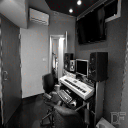

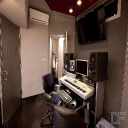

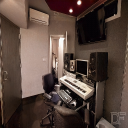

 20%|██        | 100/500 [00:02<00:09, 40.30it/s]

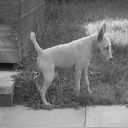

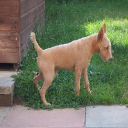

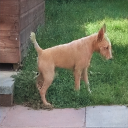

 40%|███▉      | 198/500 [00:05<00:06, 44.11it/s]

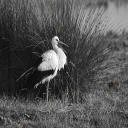

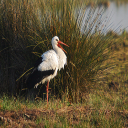

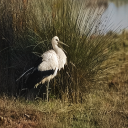

 60%|█████▉    | 298/500 [00:08<00:06, 32.74it/s]

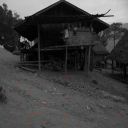

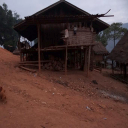

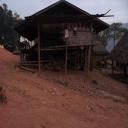

 80%|████████  | 400/500 [00:11<00:03, 30.36it/s]

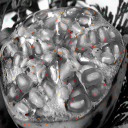

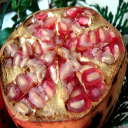

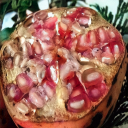

  0%|          | 1/1125 [00:00<02:01,  9.22it/s]


------------------------------------------------------------------
Epoch: 113	Time: 119.0757	Train Loss: 0.0088	Train PSNR 36.1937	Train SSIM 0.9527
------------------------------------------------------------------

[113] Validation Loss : 0.0084, Validation PSNR : 37.8078% ,Validation SSIM : 0.9529%

Epoch : [114] 0/1125 
 Training loss : 0.007916772738099098


  9%|▉         | 102/1125 [00:09<01:33, 10.91it/s]


Epoch : [114] 100/1125 
 Training loss : 0.008668735236077025


 18%|█▊        | 202/1125 [00:18<01:23, 11.10it/s]


Epoch : [114] 200/1125 
 Training loss : 0.008647397100295297


 27%|██▋       | 302/1125 [00:27<01:13, 11.27it/s]


Epoch : [114] 300/1125 
 Training loss : 0.008760757261633476


 36%|███▌      | 402/1125 [00:36<01:06, 10.80it/s]


Epoch : [114] 400/1125 
 Training loss : 0.008778010526360791


 45%|████▍     | 502/1125 [00:45<00:56, 11.11it/s]


Epoch : [114] 500/1125 
 Training loss : 0.008718462181305456


 54%|█████▎    | 602/1125 [00:54<00:46, 11.32it/s]


Epoch : [114] 600/1125 
 Training loss : 0.008759638765662561


 62%|██████▏   | 702/1125 [01:03<00:38, 11.01it/s]


Epoch : [114] 700/1125 
 Training loss : 0.008746160278641505


 71%|███████▏  | 802/1125 [01:12<00:29, 10.98it/s]


Epoch : [114] 800/1125 
 Training loss : 0.00873084444745668


 80%|████████  | 902/1125 [01:21<00:19, 11.18it/s]


Epoch : [114] 900/1125 
 Training loss : 0.008770153115603755


 89%|████████▉ | 1002/1125 [01:30<00:10, 11.50it/s]


Epoch : [114] 1000/1125 
 Training loss : 0.008803743578318682


 98%|█████████▊| 1102/1125 [01:39<00:02, 11.36it/s]


Epoch : [114] 1100/1125 
 Training loss : 0.008767979444562035


100%|██████████| 1125/1125 [01:41<00:00, 11.09it/s]



Finished training epoch 114
Total training loss : 0.008760638448099295 / psnr : 36.1934 / ssim : 0.9526


  0%|          | 0/500 [00:00<?, ?it/s]

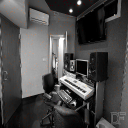

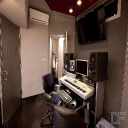

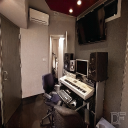

 20%|█▉        | 99/500 [00:02<00:09, 41.73it/s]

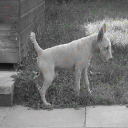

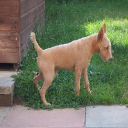

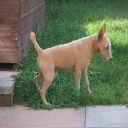

 40%|███▉      | 199/500 [00:05<00:07, 42.05it/s]

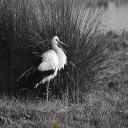

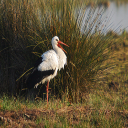

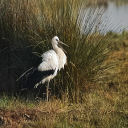

 60%|█████▉    | 298/500 [00:07<00:05, 39.41it/s]

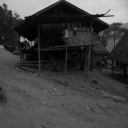

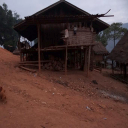

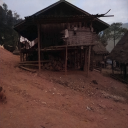

 79%|███████▉  | 397/500 [00:10<00:02, 35.55it/s]

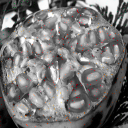

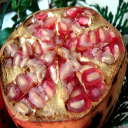

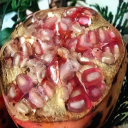

  0%|          | 0/1125 [00:00<?, ?it/s]


------------------------------------------------------------------
Epoch: 114	Time: 117.5950	Train Loss: 0.0088	Train PSNR 36.1934	Train SSIM 0.9526
------------------------------------------------------------------

[114] Validation Loss : 0.0088, Validation PSNR : 37.2699% ,Validation SSIM : 0.9477%

Epoch : [115] 0/1125 
 Training loss : 0.007960165850818157


  9%|▉         | 102/1125 [00:09<01:33, 10.98it/s]


Epoch : [115] 100/1125 
 Training loss : 0.008904423652272118


 18%|█▊        | 202/1125 [00:18<01:25, 10.84it/s]


Epoch : [115] 200/1125 
 Training loss : 0.00886687654214193


 27%|██▋       | 302/1125 [00:27<01:14, 11.04it/s]


Epoch : [115] 300/1125 
 Training loss : 0.008984533802256533


 36%|███▌      | 402/1125 [00:36<01:05, 11.04it/s]


Epoch : [115] 400/1125 
 Training loss : 0.008959235400518871


 45%|████▍     | 502/1125 [00:45<00:55, 11.21it/s]


Epoch : [115] 500/1125 
 Training loss : 0.008954463240331756


 54%|█████▎    | 602/1125 [00:54<00:47, 11.12it/s]


Epoch : [115] 600/1125 
 Training loss : 0.008992545566244202


 62%|██████▏   | 702/1125 [01:03<00:37, 11.33it/s]


Epoch : [115] 700/1125 
 Training loss : 0.008895040748138698


 71%|███████▏  | 802/1125 [01:12<00:28, 11.30it/s]


Epoch : [115] 800/1125 
 Training loss : 0.008869300556302851


 80%|████████  | 902/1125 [01:21<00:20, 10.88it/s]


Epoch : [115] 900/1125 
 Training loss : 0.008892910026290871


 89%|████████▉ | 1002/1125 [01:30<00:11, 11.17it/s]


Epoch : [115] 1000/1125 
 Training loss : 0.00888249896872383


 98%|█████████▊| 1102/1125 [01:39<00:02, 10.91it/s]


Epoch : [115] 1100/1125 
 Training loss : 0.00887407330951766


100%|██████████| 1125/1125 [01:41<00:00, 11.09it/s]



Finished training epoch 115
Total training loss : 0.00886844523375233 / psnr : 36.1647 / ssim : 0.9531


  0%|          | 0/500 [00:00<?, ?it/s]

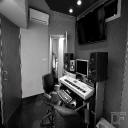

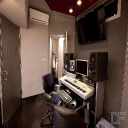

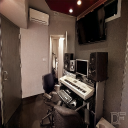

 20%|██        | 100/500 [00:02<00:10, 38.62it/s]

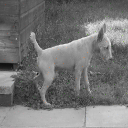

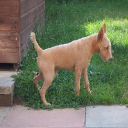

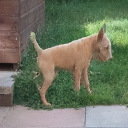

 39%|███▉      | 196/500 [00:04<00:07, 39.73it/s]

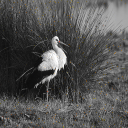

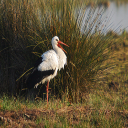

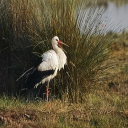

 59%|█████▉    | 297/500 [00:07<00:04, 41.87it/s]

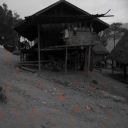

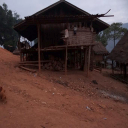

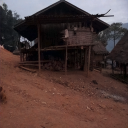

 80%|███████▉  | 399/500 [00:10<00:02, 34.65it/s]

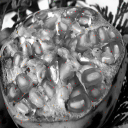

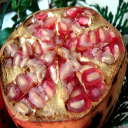

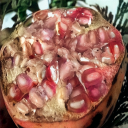

  0%|          | 1/1125 [00:00<02:05,  8.95it/s]


------------------------------------------------------------------
Epoch: 115	Time: 117.9086	Train Loss: 0.0089	Train PSNR 36.1647	Train SSIM 0.9531
------------------------------------------------------------------

[115] Validation Loss : 0.0092, Validation PSNR : 37.2743% ,Validation SSIM : 0.9556%

Epoch : [116] 0/1125 
 Training loss : 0.0071021681651473045


  9%|▉         | 103/1125 [00:09<01:33, 10.93it/s]


Epoch : [116] 100/1125 
 Training loss : 0.00869992566248863


 18%|█▊        | 203/1125 [00:18<01:22, 11.15it/s]


Epoch : [116] 200/1125 
 Training loss : 0.008677382355750496


 27%|██▋       | 303/1125 [00:27<01:12, 11.40it/s]


Epoch : [116] 300/1125 
 Training loss : 0.008854969582548273


 36%|███▌      | 403/1125 [00:36<01:02, 11.47it/s]


Epoch : [116] 400/1125 
 Training loss : 0.008774427816671253


 45%|████▍     | 503/1125 [00:45<00:54, 11.39it/s]


Epoch : [116] 500/1125 
 Training loss : 0.008789337993025066


 54%|█████▎    | 603/1125 [00:54<00:47, 10.99it/s]


Epoch : [116] 600/1125 
 Training loss : 0.008695539455867051


 62%|██████▏   | 703/1125 [01:03<00:37, 11.15it/s]


Epoch : [116] 700/1125 
 Training loss : 0.008670597019659809


 71%|███████▏  | 803/1125 [01:12<00:29, 11.10it/s]


Epoch : [116] 800/1125 
 Training loss : 0.008732712549156278


 80%|████████  | 903/1125 [01:21<00:19, 11.10it/s]


Epoch : [116] 900/1125 
 Training loss : 0.008720502669258367


 89%|████████▉ | 1003/1125 [01:30<00:10, 11.43it/s]


Epoch : [116] 1000/1125 
 Training loss : 0.008699171669822146


 98%|█████████▊| 1103/1125 [01:39<00:01, 11.09it/s]


Epoch : [116] 1100/1125 
 Training loss : 0.008672825654175176


100%|██████████| 1125/1125 [01:41<00:00, 11.11it/s]



Finished training epoch 116
Total training loss : 0.008669302900632222 / psnr : 36.2402 / ssim : 0.9528


  0%|          | 0/500 [00:00<?, ?it/s]

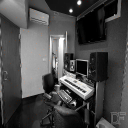

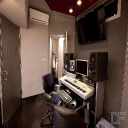

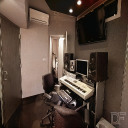

 20%|█▉        | 99/500 [00:02<00:10, 38.70it/s]

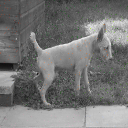

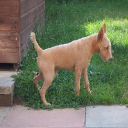

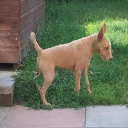

 40%|███▉      | 199/500 [00:04<00:06, 45.55it/s]

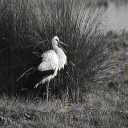

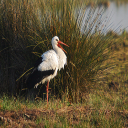

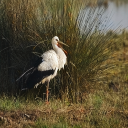

 60%|█████▉    | 299/500 [00:07<00:04, 44.60it/s]

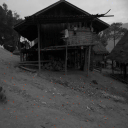

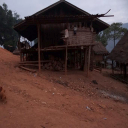

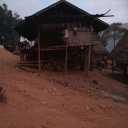

 79%|███████▉  | 397/500 [00:09<00:02, 36.71it/s]

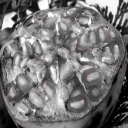

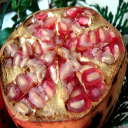

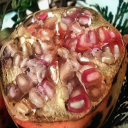

  0%|          | 2/1125 [00:00<01:47, 10.41it/s]


------------------------------------------------------------------
Epoch: 116	Time: 116.9501	Train Loss: 0.0087	Train PSNR 36.2402	Train SSIM 0.9528
------------------------------------------------------------------

[116] Validation Loss : 0.0096, Validation PSNR : 37.0363% ,Validation SSIM : 0.9485%

Epoch : [117] 0/1125 
 Training loss : 0.007999288849532604


  9%|▉         | 103/1125 [00:09<01:31, 11.18it/s]


Epoch : [117] 100/1125 
 Training loss : 0.009012346197436056


 18%|█▊        | 203/1125 [00:18<01:26, 10.64it/s]


Epoch : [117] 200/1125 
 Training loss : 0.009784479252530716


 27%|██▋       | 303/1125 [00:27<01:13, 11.19it/s]


Epoch : [117] 300/1125 
 Training loss : 0.010007092777169326


 36%|███▌      | 403/1125 [00:36<01:04, 11.21it/s]


Epoch : [117] 400/1125 
 Training loss : 0.009897089394928883


 45%|████▍     | 503/1125 [00:45<00:55, 11.24it/s]


Epoch : [117] 500/1125 
 Training loss : 0.009721719561341756


 54%|█████▎    | 603/1125 [00:54<00:46, 11.28it/s]


Epoch : [117] 600/1125 
 Training loss : 0.009639528083356217


 62%|██████▏   | 703/1125 [01:03<00:37, 11.19it/s]


Epoch : [117] 700/1125 
 Training loss : 0.009562513157300194


 71%|███████▏  | 803/1125 [01:12<00:28, 11.15it/s]


Epoch : [117] 800/1125 
 Training loss : 0.00948038889146346


 80%|████████  | 901/1125 [01:21<00:20, 11.00it/s]


Epoch : [117] 900/1125 
 Training loss : 0.00936609727395626


 89%|████████▉ | 1003/1125 [01:30<00:10, 11.12it/s]


Epoch : [117] 1000/1125 
 Training loss : 0.009326606361357334


 98%|█████████▊| 1103/1125 [01:39<00:01, 11.31it/s]


Epoch : [117] 1100/1125 
 Training loss : 0.009317831240753414


100%|██████████| 1125/1125 [01:41<00:00, 11.07it/s]



Finished training epoch 117
Total training loss : 0.009297928156952063 / psnr : 35.9331 / ssim : 0.9513


  0%|          | 0/500 [00:00<?, ?it/s]

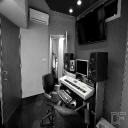

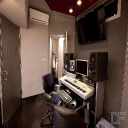

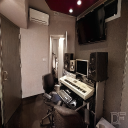

 20%|█▉        | 98/500 [00:02<00:09, 40.91it/s]

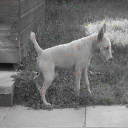

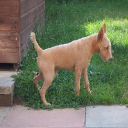

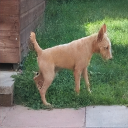

 39%|███▉      | 197/500 [00:04<00:06, 43.45it/s]

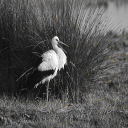

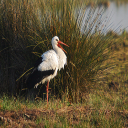

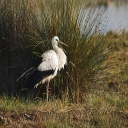

 60%|██████    | 300/500 [00:07<00:05, 38.65it/s]

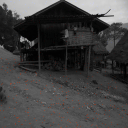

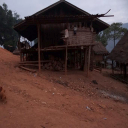

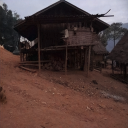

 80%|███████▉  | 399/500 [00:10<00:02, 33.94it/s]

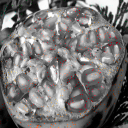

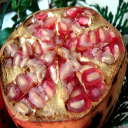

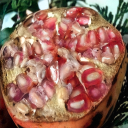

  0%|          | 0/1125 [00:00<?, ?it/s]


------------------------------------------------------------------
Epoch: 117	Time: 117.7238	Train Loss: 0.0093	Train PSNR 35.9331	Train SSIM 0.9513
------------------------------------------------------------------

[117] Validation Loss : 0.0089, Validation PSNR : 37.5045% ,Validation SSIM : 0.9489%

Epoch : [118] 0/1125 
 Training loss : 0.008142475038766861


  9%|▉         | 103/1125 [00:09<01:30, 11.29it/s]


Epoch : [118] 100/1125 
 Training loss : 0.0087006973231783


 18%|█▊        | 203/1125 [00:18<01:21, 11.28it/s]


Epoch : [118] 200/1125 
 Training loss : 0.008706202047103229


 27%|██▋       | 303/1125 [00:27<01:15, 10.89it/s]


Epoch : [118] 300/1125 
 Training loss : 0.008546841590730258


 36%|███▌      | 403/1125 [00:36<01:06, 10.94it/s]


Epoch : [118] 400/1125 
 Training loss : 0.008534816803266653


 45%|████▍     | 503/1125 [00:45<00:56, 11.06it/s]


Epoch : [118] 500/1125 
 Training loss : 0.008536543504719784


 54%|█████▎    | 603/1125 [00:54<00:46, 11.14it/s]


Epoch : [118] 600/1125 
 Training loss : 0.008517805252924636


 62%|██████▏   | 703/1125 [01:03<00:38, 11.10it/s]


Epoch : [118] 700/1125 
 Training loss : 0.00858754749222527


 71%|███████▏  | 803/1125 [01:12<00:28, 11.26it/s]


Epoch : [118] 800/1125 
 Training loss : 0.008599350971870878


 80%|████████  | 903/1125 [01:21<00:19, 11.25it/s]


Epoch : [118] 900/1125 
 Training loss : 0.008603877437039465


 89%|████████▉ | 1003/1125 [01:30<00:10, 11.38it/s]


Epoch : [118] 1000/1125 
 Training loss : 0.008600693330034747


 98%|█████████▊| 1103/1125 [01:39<00:01, 11.58it/s]


Epoch : [118] 1100/1125 
 Training loss : 0.00858903113629104


100%|██████████| 1125/1125 [01:41<00:00, 11.09it/s]



Finished training epoch 118
Total training loss : 0.00858702296184169 / psnr : 36.3023 / ssim : 0.9525


  0%|          | 0/500 [00:00<?, ?it/s]

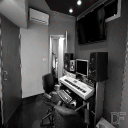

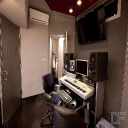

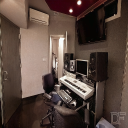

 20%|██        | 100/500 [00:02<00:09, 40.26it/s]

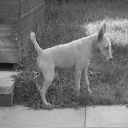

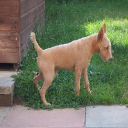

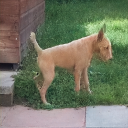

 40%|████      | 200/500 [00:04<00:06, 43.24it/s]

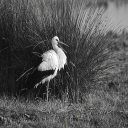

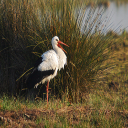

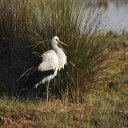

 60%|██████    | 300/500 [00:07<00:04, 41.06it/s]

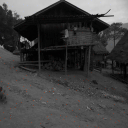

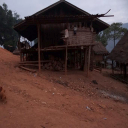

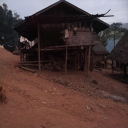

 80%|███████▉  | 398/500 [00:09<00:02, 35.35it/s]

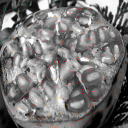

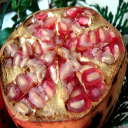

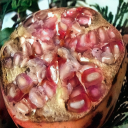

  0%|          | 1/1125 [00:00<01:59,  9.41it/s]


------------------------------------------------------------------
Epoch: 118	Time: 117.1140	Train Loss: 0.0086	Train PSNR 36.3023	Train SSIM 0.9525
------------------------------------------------------------------

[118] Validation Loss : 0.0088, Validation PSNR : 37.4681% ,Validation SSIM : 0.9504%

Epoch : [119] 0/1125 
 Training loss : 0.0086259376257658


  9%|▉         | 103/1125 [00:09<01:33, 10.88it/s]


Epoch : [119] 100/1125 
 Training loss : 0.008643447135639663


 18%|█▊        | 201/1125 [00:18<01:22, 11.22it/s]


Epoch : [119] 200/1125 
 Training loss : 0.008881773602736382


 27%|██▋       | 303/1125 [00:27<01:13, 11.18it/s]


Epoch : [119] 300/1125 
 Training loss : 0.008834748415963297


 36%|███▌      | 403/1125 [00:36<01:03, 11.29it/s]


Epoch : [119] 400/1125 
 Training loss : 0.008776545263315897


 45%|████▍     | 503/1125 [00:45<00:54, 11.38it/s]


Epoch : [119] 500/1125 
 Training loss : 0.008784712283888798


 54%|█████▎    | 603/1125 [00:54<00:45, 11.36it/s]


Epoch : [119] 600/1125 
 Training loss : 0.00880770106953313


 62%|██████▏   | 703/1125 [01:03<00:37, 11.18it/s]


Epoch : [119] 700/1125 
 Training loss : 0.008851957474217435


 71%|███████▏  | 803/1125 [01:12<00:29, 10.89it/s]


Epoch : [119] 800/1125 
 Training loss : 0.00884521517846803


 80%|████████  | 903/1125 [01:21<00:20, 11.04it/s]


Epoch : [119] 900/1125 
 Training loss : 0.008776323566963683


 89%|████████▉ | 1003/1125 [01:31<00:10, 11.33it/s]


Epoch : [119] 1000/1125 
 Training loss : 0.008720118431030186


 98%|█████████▊| 1103/1125 [01:39<00:01, 11.35it/s]


Epoch : [119] 1100/1125 
 Training loss : 0.00871621491979608


100%|██████████| 1125/1125 [01:41<00:00, 11.06it/s]



Finished training epoch 119
Total training loss : 0.00872226139323579 / psnr : 36.2589 / ssim : 0.9534


  0%|          | 0/500 [00:00<?, ?it/s]

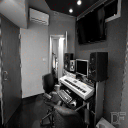

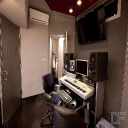

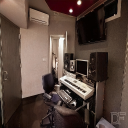

 20%|█▉        | 98/500 [00:02<00:09, 42.30it/s]

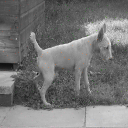

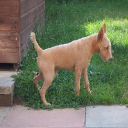

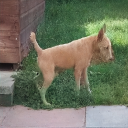

 39%|███▉      | 197/500 [00:04<00:07, 42.45it/s]

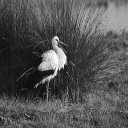

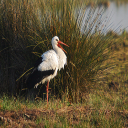

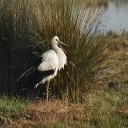

 59%|█████▉    | 297/500 [00:07<00:04, 44.63it/s]

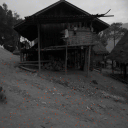

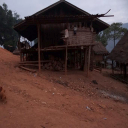

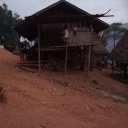

 80%|███████▉  | 399/500 [00:10<00:03, 32.76it/s]

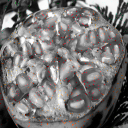

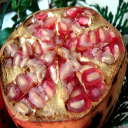

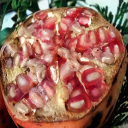

  0%|          | 0/1125 [00:00<?, ?it/s]


------------------------------------------------------------------
Epoch: 119	Time: 117.7689	Train Loss: 0.0087	Train PSNR 36.2589	Train SSIM 0.9534
------------------------------------------------------------------

[119] Validation Loss : 0.0093, Validation PSNR : 37.2261% ,Validation SSIM : 0.9534%

Epoch : [120] 0/1125 
 Training loss : 0.009358629584312439


  9%|▉         | 102/1125 [00:09<01:29, 11.38it/s]


Epoch : [120] 100/1125 
 Training loss : 0.009011192108956304


 18%|█▊        | 202/1125 [00:18<01:25, 10.85it/s]


Epoch : [120] 200/1125 
 Training loss : 0.009040648919247572


 27%|██▋       | 302/1125 [00:27<01:13, 11.14it/s]


Epoch : [120] 300/1125 
 Training loss : 0.00896533568269044


 36%|███▌      | 402/1125 [00:36<01:04, 11.18it/s]


Epoch : [120] 400/1125 
 Training loss : 0.008847940360147162


 45%|████▍     | 502/1125 [00:45<00:55, 11.14it/s]


Epoch : [120] 500/1125 
 Training loss : 0.008846741626057737


 54%|█████▎    | 602/1125 [00:54<00:46, 11.17it/s]


Epoch : [120] 600/1125 
 Training loss : 0.008805871987637883


 62%|██████▏   | 702/1125 [01:03<00:37, 11.23it/s]


Epoch : [120] 700/1125 
 Training loss : 0.008805839680321248


 71%|███████▏  | 802/1125 [01:12<00:29, 11.04it/s]


Epoch : [120] 800/1125 
 Training loss : 0.00880162338592512


 80%|████████  | 902/1125 [01:21<00:20, 10.82it/s]


Epoch : [120] 900/1125 
 Training loss : 0.008864612441063423


 89%|████████▉ | 1002/1125 [01:30<00:11, 11.11it/s]


Epoch : [120] 1000/1125 
 Training loss : 0.008847715868079638


 98%|█████████▊| 1102/1125 [01:39<00:02, 11.03it/s]


Epoch : [120] 1100/1125 
 Training loss : 0.0087885369731115


100%|██████████| 1125/1125 [01:41<00:00, 11.10it/s]



Finished training epoch 120
Total training loss : 0.008769569148206048 / psnr : 36.2542 / ssim : 0.9535


  0%|          | 0/500 [00:00<?, ?it/s]

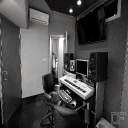

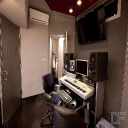

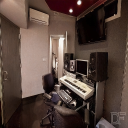

 19%|█▉        | 96/500 [00:02<00:09, 41.76it/s]

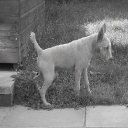

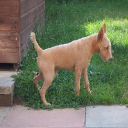

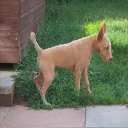

 39%|███▉      | 196/500 [00:04<00:07, 41.61it/s]

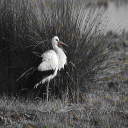

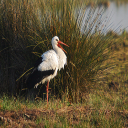

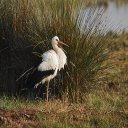

 60%|██████    | 300/500 [00:07<00:04, 42.80it/s]

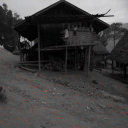

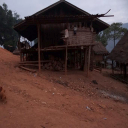

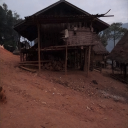

 80%|███████▉  | 398/500 [00:10<00:02, 35.18it/s]

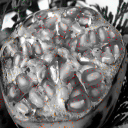

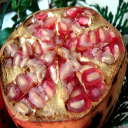

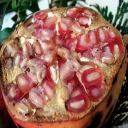

100%|██████████| 500/500 [00:13<00:00, 37.20it/s]



------------------------------------------------------------------
Epoch: 120	Time: 117.7802	Train Loss: 0.0088	Train PSNR 36.2542	Train SSIM 0.9535
------------------------------------------------------------------

[120] Validation Loss : 0.0107, Validation PSNR : 36.2003% ,Validation SSIM : 0.9554%


In [ ]:
import torch.optim as optim
import time
import numpy as np
import torch.nn as nn
import torch

# data_dir = '/content/drive/MyDrive/UNet/output'
# ckpt_dir = '/content/drive/MyDrive/UNet/checkpoint'


# data_dir = '/content/drive/MyDrive/NestedUNet/output'
# ckpt_dir = '/content/drive/MyDrive/NestedUNet/checkpoint'


# data_dir = '/content/drive/MyDrive/Att_UNet/output'
# ckpt_dir = '/content/drive/MyDrive/Att_UNet/checkpoint'


# data_dir = '/content/drive/MyDrive/Dense_UNet/output'
# ckpt_dir = '/content/drive/MyDrive/Dense_UNet/checkpoint'


# data_dir = '/content/drive/MyDrive/Dense_Att_UNet/output'
# ckpt_dir = '/content/drive/MyDrive/Dense_Att_UNet/checkpoint'

data_dir = '/content/drive/MyDrive/PRACTICE_NET/output'
ckpt_dir = '/content/drive/MyDrive/PRACTICE_NET/checkpoint'

if not os.path.exists(data_dir):
    os.makedirs(data_dir)

# root_path="/content/drive/MyDrive/UNet/"
# root_path="/content/drive/MyDrive/NestedUNet/"
# root_path="/content/drive/MyDrive/Nested_Att_UNet/"
# root_path='/content/drive/MyDrive/Dense_UNet/'
# root_path='/content/drive/MyDrive/Dense_Att_UNet/'
root_path='/content/drive/MyDrive/PRACTICE_NET/'
use_cuda=True


#하이퍼 파라미터
batch_size=4
learning_rate=1e-3
EPOCH=120

#모델 불러오기
# model=Unet(n_channels=3, n_classes=3, bilinear=False)
#model=Nested_Unet(n_channels=3, n_classes=3, deep_supervision=False)
# model=Nested_Attention_Unet(n_channels=3, n_classes=3, deep_supervision=False)
# model=AttU_Net(3,3)
# model=Dense_Unet(3,3)

model=Practice(3,3)

#optimizer 및 loss function
optimizer = optim.Adam(model.parameters(), lr=learning_rate) #, eps=1e-8, weight_decay=1e-8
criterion =  nn.L1Loss()

if use_cuda:
  model=model.cuda()
  criterion=criterion.cuda()



#Training
start_epoch=1
model, optimizer, start_epoch = load(ckpt_dir,model,optimizer)

best=0

for epoch in range(start_epoch, EPOCH+1):
  epoch_start_time=time.time()
  train_loss, train_PSNR,train_SSIM = train(model, train_dataloader,criterion, optimizer, epoch)
  with torch.no_grad():
    val_loss, val_PSNR,val_SSIM = validation(model, valid_dataloader,criterion)


  if val_PSNR > best:
     best = val_PSNR
     torch.save({'net':model.state_dict(),
              'optim':optimizer.state_dict()},
              root_path+'best_model_epoch%d_%lf.pth'%(epoch,best))
  print("\n------------------------------------------------------------------")
  print("Epoch: {}\tTime: {:.4f}\tTrain Loss: {:.4f}\tTrain PSNR {:.4f}\tTrain SSIM {:.4f}".format(epoch, time.time()-epoch_start_time, train_loss, train_PSNR,train_SSIM))
  print("------------------------------------------------------------------")
  print('\n[{}] Validation Loss : {:.4f}, Validation PSNR : {:.4f}% ,Validation SSIM : {:.4f}%'.format(epoch, val_loss, val_PSNR,val_SSIM))

  


  writer.add_scalar('Loss/train', train_loss, epoch)
  writer.add_scalar('Loss/validation', val_loss, epoch)
  writer.add_scalar('PSNR/train', train_PSNR, epoch)
  writer.add_scalar('PSNR/validation', val_PSNR, epoch)
  writer.add_scalar('SSIM/train', train_SSIM, epoch)
  writer.add_scalar('SSIM/validation', val_SSIM, epoch)


writer.close()

    




In [ ]:
pip install optuna

In [ ]:
import random
import torch.optim as optim
import time
import numpy as np
import torch.nn as nn
import torch

def train_with_optuna(trial): 
  cfg = { 
         'device' : "cuda" if torch.cuda.is_available() else "cpu",
         'seed' : 0, 
         'lr' : trial.suggest_uniform("lr", 1e-4, 1e-3),
         'optimizer': trial.suggest_categorical('optimizer',[optim.SGD, optim.Adam,optim.RMSprop]),
         'criterion': trial.suggest_categorical('criterion',["1","2"])
         } 

  if cfg['criterion']=='1':
    criterion=nn.L1Loss()
  else:
    criterion=nn.MSELoss()

 
         
         
  torch.manual_seed(cfg['seed']) 

  model = Practice(3,3)
  optimizer = optim.Adam(model.parameters(), lr=cfg['lr']) 
  #criterion =  cfg['criterion']

  if use_cuda:
    model=model.cuda()
    criterion=criterion.cuda()


  best=0

  
  for epoch in range(0,5):
    train_loss, train_PSNR,train_SSIM = train(model, train_dataloader,criterion, optimizer, epoch)
    with torch.no_grad():
      val_loss, val_PSNR,val_SSIM = validation(model, valid_dataloader,criterion)


    if val_PSNR > best:
      best = val_PSNR


  return best

    




In [ ]:
pip install joblib

In [ ]:
import optuna 
import joblib 

In [ ]:


study = optuna.create_study(sampler=optuna.samplers.TPESampler(), direction='maximize')

# study.optimize(train_with_optuna, n_trials=20)

joblib.dump(study, '/content/drive/MyDrive/_optuna.pkl')


study = joblib.load('/content/drive/MyDrive/_optuna.pkl') 
df = study.trials_dataframe().drop(['state','datetime_start','datetime_complete'], axis=1) 
df=df.sort_values('value',ascending=False)

df.loc[df.params_criterion=='1','params_criterion']='L1Loss'

df.loc[df.params_criterion=='2','params_criterion']='MSELoss'
df.head(5)


[I 2021-07-18 11:32:08,376] A new study created in memory with name: no-name-85b5fc0b-6215-4082-bd86-44a1dc679d9a
/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.sgd.SGD'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.adam.Adam'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.rmsprop.RMSprop'> which is of type type.

  0%|          | 0/1125 [00:00<?, ?it/s]/usr/local/lib/python3.7/dist-packages/torch/nn

,number,value,datetime_start,datetime_complete,duration,params_criterion,params_lr,params_optimizer,state
5,5,33.006634,2021-07-18 12:13:45.983343,2021-07-18 12:22:04.711870,0 days 00:08:18.728527,L1Loss,0.000508,<class 'torch.optim.rmsprop.RMSprop'>,COMPLETE
1,1,32.812950,2021-07-18 11:40:27.734340,2021-07-18 11:48:48.367863,0 days 00:08:20.633523,MSELoss,0.000819,<class 'torch.optim.rmsprop.RMSprop'>,COMPLETE
6,6,32.728027,2021-07-18 12:22:04.714019,2021-07-18 12:30:20.373094,0 days 00:08:15.659075,MSELoss,0.000519,<class 'torch.optim.rmsprop.RMSprop'>,COMPLETE
2,2,32.670986,2021-07-18 11:48:48.373568,2021-07-18 11:57:08.677291,0 days 00:08:20.303723,L1Loss,0.000301,<class 'torch.optim.sgd.SGD'>,COMPLETE
3,3,32.475311,2021-07-18 11:57:08.680208,2021-07-18 12:05:27.998842,0 days 00:08:19.318634,MSELoss,0.000311,<class 'torch.optim.rmsprop.RMSprop'>,COMPLETE


In [ ]:
df.head(10)

,number,value,datetime_start,datetime_complete,duration,params_criterion,params_lr,params_optimizer,state
5,5,33.006634,2021-07-18 12:13:45.983343,2021-07-18 12:22:04.711870,0 days 00:08:18.728527,L1Loss,0.000508,<class 'torch.optim.rmsprop.RMSprop'>,COMPLETE
1,1,32.812950,2021-07-18 11:40:27.734340,2021-07-18 11:48:48.367863,0 days 00:08:20.633523,MSELoss,0.000819,<class 'torch.optim.rmsprop.RMSprop'>,COMPLETE
6,6,32.728027,2021-07-18 12:22:04.714019,2021-07-18 12:30:20.373094,0 days 00:08:15.659075,MSELoss,0.000519,<class 'torch.optim.rmsprop.RMSprop'>,COMPLETE
2,2,32.670986,2021-07-18 11:48:48.373568,2021-07-18 11:57:08.677291,0 days 00:08:20.303723,L1Loss,0.000301,<class 'torch.optim.sgd.SGD'>,COMPLETE
3,3,32.475311,2021-07-18 11:57:08.680208,2021-07-18 12:05:27.998842,0 days 00:08:19.318634,MSELoss,0.000311,<class 'torch.optim.rmsprop.RMSprop'>,COMPLETE
14,14,32.415928,2021-07-18 13:28:29.026209,2021-07-18 13:36:47.793912,0 days 00:08:18.767703,MSELoss,0.000801,<class 'torch.optim.sgd.SGD'>,COMPLETE
7,7,32.387619,2021-07-18 12:30:20.375395,2021-07-18 12:38:37.797866,0 days 00:08:17.422471,MSELoss,0.000141,<class 'torch.optim.adam.Adam'>,COMPLETE
0,0,32.311031,2021-07-18 11:32:08.378262,2021-07-18 11:40:27.732138,0 days 00:08:19.353876,L1Loss,0.000438,<class 'torch.optim.rmsprop.RMSprop'>,COMPLETE
13,13,32.299919,2021-07-18 13:20:09.866091,2021-07-18 13:28:29.023805,0 days 00:08:19.157714,MSELoss,0.000959,<class 'torch.optim.rmsprop.RMSprop'>,COMPLETE
9,9,32.219170,2021-07-18 12:46:56.049832,2021-07-18 12:55:14.892285,0 days 00:08:18.842453,L1Loss,0.000227,<class 'torch.optim.adam.Adam'>,COMPLETE


In [ ]:
df.head(10)

,number,PSNR,params_criterion,params_lr,params_optimizer
5,5,33.006634,L1Loss,0.000508,<class 'torch.optim.rmsprop.RMSprop'>
1,1,32.812950,MSELoss,0.000819,<class 'torch.optim.rmsprop.RMSprop'>
6,6,32.728027,MSELoss,0.000519,<class 'torch.optim.rmsprop.RMSprop'>
2,2,32.670986,L1Loss,0.000301,<class 'torch.optim.sgd.SGD'>
3,3,32.475311,MSELoss,0.000311,<class 'torch.optim.rmsprop.RMSprop'>
14,14,32.415928,MSELoss,0.000801,<class 'torch.optim.sgd.SGD'>
7,7,32.387619,MSELoss,0.000141,<class 'torch.optim.adam.Adam'>
0,0,32.311031,L1Loss,0.000438,<class 'torch.optim.rmsprop.RMSprop'>
13,13,32.299919,MSELoss,0.000959,<class 'torch.optim.rmsprop.RMSprop'>
9,9,32.219170,L1Loss,0.000227,<class 'torch.optim.adam.Adam'>


#Test

In [ ]:
import os
import zipfile
import tqdm

file_name = "results.zip"
zip_path = os.path.join('/content/drive/MyDrive/results.zip')

!cp "{zip_path}" .
!unzip -q "{file_name}"
!rm "{file_name}"

  0%|          | 0/4 [00:00<?, ?it/s]

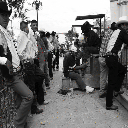

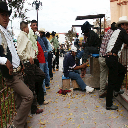

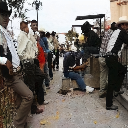

psnr :  tensor(34.1813, device='cuda:0')


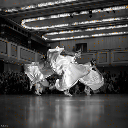

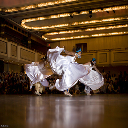

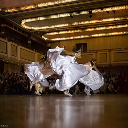

 50%|█████     | 2/4 [00:00<00:00, 16.90it/s]

psnr :  tensor(35.8502, device='cuda:0')


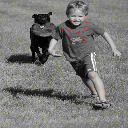

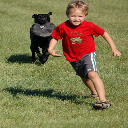

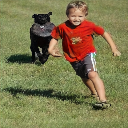

psnr :  tensor(34.7623, device='cuda:0')


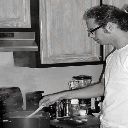

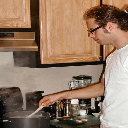

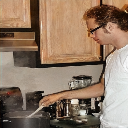

100%|██████████| 4/4 [00:00<00:00, 16.45it/s]

psnr :  tensor(38.3693, device='cuda:0')
psnr : 35.790771  ssim : 0.942700


In [ ]:
test_dir = '/content/drive/MyDrive/PRACTICE_NET/test_result'


if not os.path.exists(test_dir):
    os.makedirs(test_dir)

# model=Unet(n_channels=3, n_classes=3, bilinear=False)
# model.load_state_dict(torch.load("/content/drive/MyDrive/UNet/checkpoint/model_epoch40.pth")['net'])


# model=Nested_Unet(n_channels=3, n_classes=3, deep_supervision=False)
# model.load_state_dict(torch.load("/content/drive/MyDrive/NestedUNet/best_model_epoch80_37.406292.pth")['net'])

model=Practice(3,3)
model.load_state_dict(torch.load("/content/drive/MyDrive/PRACTICE_NET/checkpoint/model_epoch79.pth")['net'])
model.cuda()


# Function for validatation
def test(model, test_dataloader):
    model.eval()
    psnr_test=[]
    ssim_test=[]

    with torch.no_grad():
        for i,data in enumerate(tqdm.tqdm(test_dataloader)):
          if use_cuda:
            l=data["l"].to('cuda')
            ab=data['ab'].to('cuda')
            hint=data['hint'].to('cuda')
          
          gt_image=torch.cat((l,ab),dim=1)
          hint_image=torch.cat((l,hint),dim=1)


          predict=model(hint_image)
          psnr_test.append(torchPSNR(predict,gt_image))

          predict_np=tensor2im(predict)
          predict_bgr=cv2.cvtColor(predict_np,cv2.COLOR_LAB2BGR)
          #cv2.imwrite(test_dir+"/output_"+str(i)+".png", predict_bgr)

          gt_np=tensor2im(gt_image)
          gt_bgr=cv2.cvtColor(gt_np,cv2.COLOR_LAB2BGR)


          ref = utils.prepare_image(cv2.cvtColor(gt_bgr,cv2.COLOR_BGR2RGB)).to('cuda')
          dist = utils.prepare_image(cv2.cvtColor(predict_bgr,cv2.COLOR_BGR2RGB)).to('cuda')       
          ssim = SSIM(channels=3)
          ssim_test.append(ssim(dist, ref, as_loss=False).item())


          # if i%100==0:
          hint_np=tensor2im(hint_image)
          hint_bgr=cv2.cvtColor(hint_np,cv2.COLOR_LAB2BGR)   
          cv2_imshow(hint_bgr)         
          cv2_imshow(gt_bgr)
          cv2_imshow(predict_bgr)
          print("psnr : ",torchPSNR(predict,gt_image))



    psnr_=sum(psnr_test)/len(psnr_test)
    ssim_=sum(ssim_test)/len(ssim_test)

    return psnr_,ssim_


psnr,ssim=test(model, test_dataloader)
print("psnr : %lf  ssim : %lf"%(psnr,ssim))

In [ ]:
pip install tensorboard


In [ ]:
from torch.utils.tensorboard import SummaryWriter
import numpy as np
writer = SummaryWriter('scalar/')


for n_iter in range(100):
    writer.add_scalar('Loss/train', np.random.random(), n_iter)
    writer.add_scalar('Loss/test', np.random.random(), n_iter)
    writer.add_scalar('Accuracy/train', np.random.random(), n_iter)
    writer.add_scalar('Accuracy/test', np.random.random(), n_iter)

writer.close()

In [ ]:
%reload_ext tensorboard
%tensorboard --logdir ./scalar

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 3809), started 0:00:11 ago. (Use '!kill 3809' to kill it.)

<IPython.core.display.Javascript object>